# Intro
This notebook accompanies the kick-off of a small series of posts on predictive maintenance on NASA's turbofan engine degradation dataset (CMAPSS). You can find the accompanying blog posts [here](https://towardsdatascience.com/predictive-maintenance-of-turbofan-engines-ec54a083127?source=friends_link&sk=e97778a1d99d9923f1683365c21a1efb)  

Note: There are 4 datasets available of increasing complexity:  
Data Set FD001 is the first in the series and the least complex.  
Train trjectories: 100  
Test trajectories: 100  
Conditions: ONE (Sea Level)  
Fault Modes: ONE (HPC Degradation)  

In [103]:
%matplotlib inline
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns; sns.set()

from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score

Let's dig in by loading the data and starting our Exploratory Data Analysis (EDA) by inspecting the first few rows, to get a feeling for what the data looks like

In [104]:
# define filepath to read data
dir_path = './CMAPSSData/'

# define column names for easy indexing
index_names = ['unit_nr', 'time_cycles']
setting_names = ['setting_1', 'setting_2', 'setting_3']
sensor_names = ['s_{}'.format(i) for i in range(1,22)] 
col_names = index_names + setting_names + sensor_names

# read data
train = pd.read_csv((dir_path+'train_FD001.txt'), sep='\s+', header=None, names=col_names)
test = pd.read_csv((dir_path+'test_FD001.txt'), sep='\s+', header=None, names=col_names)
y_test = pd.read_csv((dir_path+'RUL_FD001.txt'), sep='\s+', header=None, names=['RUL'])

train.head()

<>:11: DeprecationWarning: invalid escape sequence \s


,unit_nr,time_cycles,setting_1,setting_2,setting_3,s_1,s_2,s_3,s_4,s_5,...,s_12,s_13,s_14,s_15,s_16,s_17,s_18,s_19,s_20,s_21
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,...,521.66,2388.02,8138.62,8.4195,0.03,392,2388,100.0,39.06,23.4190
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,...,522.28,2388.07,8131.49,8.4318,0.03,392,2388,100.0,39.00,23.4236
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,...,522.42,2388.03,8133.23,8.4178,0.03,390,2388,100.0,38.95,23.3442
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,...,522.86,2388.08,8133.83,8.3682,0.03,392,2388,100.0,38.88,23.3739
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,...,522.19,2388.04,8133.80,8.4294,0.03,393,2388,100.0,38.90,23.4044


In [105]:
train

C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,unit_nr,time_cycles,setting_1,setting_2,setting_3,s_1,s_2,s_3,s_4,s_5,...,s_12,s_13,s_14,s_15,s_16,s_17,s_18,s_19,s_20,s_21
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,...,521.66,2388.02,8138.62,8.4195,0.03,392,2388,100.0,39.06,23.4190
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,...,522.28,2388.07,8131.49,8.4318,0.03,392,2388,100.0,39.00,23.4236
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,...,522.42,2388.03,8133.23,8.4178,0.03,390,2388,100.0,38.95,23.3442
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,...,522.86,2388.08,8133.83,8.3682,0.03,392,2388,100.0,38.88,23.3739
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,...,522.19,2388.04,8133.80,8.4294,0.03,393,2388,100.0,38.90,23.4044
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20626,100,196,-0.0004,-0.0003,100.0,518.67,643.49,1597.98,1428.63,14.62,...,519.49,2388.26,8137.60,8.4956,0.03,397,2388,100.0,38.49,22.9735
20627,100,197,-0.0016,-0.0005,100.0,518.67,643.54,1604.50,1433.58,14.62,...,519.68,2388.22,8136.50,8.5139,0.03,395,2388,100.0,38.30,23.1594
20628,100,198,0.0004,0.0000,100.0,518.67,643.42,1602.46,1428.18,14.62,...,520.01,2388.24,8141.05,8.5646,0.03,398,2388,100.0,38.44,22.9333
20629,100,199,-0.0011,0.0003,100.0,518.67,643.23,1605.26,1426.53,14.62,...,519.67,2388.23,8139.29,8.5389,0.03,395,2388,100.0,38.29,23.0640


## Descriptive statistics

In [106]:
# inspect unit_nr
train[index_names].describe()

C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,unit_nr,time_cycles
count,20631.000000,20631.000000
mean,51.506568,108.807862
std,29.227633,68.880990
min,1.000000,1.000000
25%,26.000000,52.000000
50%,52.000000,104.000000
75%,77.000000,156.000000
max,100.000000,362.000000


In [107]:
# inspect time cycles
train[index_names].groupby('unit_nr').max().describe()

C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,time_cycles
count,100.000000
mean,206.310000
std,46.342749
min,128.000000
25%,177.000000
50%,199.000000
75%,229.250000
max,362.000000


In [108]:
# inspect settings
train[setting_names].describe()

C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,setting_1,setting_2,setting_3
count,20631.000000,20631.000000,20631.0
mean,-0.000009,0.000002,100.0
std,0.002187,0.000293,0.0
min,-0.008700,-0.000600,100.0
25%,-0.001500,-0.000200,100.0
50%,0.000000,0.000000,100.0
75%,0.001500,0.000300,100.0
max,0.008700,0.000600,100.0


In [109]:
# inspect sensor values
train[sensor_names].describe().transpose()

C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,count,mean,std,min,25%,50%,75%,max
s_1,20631.0,518.670000,0.000000e+00,518.6700,518.6700,518.6700,518.6700,518.6700
s_2,20631.0,642.680934,5.000533e-01,641.2100,642.3250,642.6400,643.0000,644.5300
s_3,20631.0,1590.523119,6.131150e+00,1571.0400,1586.2600,1590.1000,1594.3800,1616.9100
s_4,20631.0,1408.933782,9.000605e+00,1382.2500,1402.3600,1408.0400,1414.5550,1441.4900
s_5,20631.0,14.620000,1.776400e-15,14.6200,14.6200,14.6200,14.6200,14.6200
s_6,20631.0,21.609803,1.388985e-03,21.6000,21.6100,21.6100,21.6100,21.6100
s_7,20631.0,553.367711,8.850923e-01,549.8500,552.8100,553.4400,554.0100,556.0600
s_8,20631.0,2388.096652,7.098548e-02,2387.9000,2388.0500,2388.0900,2388.1400,2388.5600
s_9,20631.0,9065.242941,2.208288e+01,9021.7300,9053.1000,9060.6600,9069.4200,9244.5900
s_10,20631.0,1.300000,0.000000e+00,1.3000,1.3000,1.3000,1.3000,1.3000


In [110]:
# before we start plotting the data, let's compute RUL

C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [111]:
def add_remaining_useful_life(df):
    # Get the total number of cycles for each unit
    grouped_by_unit = df.groupby(by="unit_nr")
    max_cycle = grouped_by_unit["time_cycles"].max()
    
    # Merge the max cycle back into the original frame
    result_frame = df.merge(max_cycle.to_frame(name='max_cycle'), left_on='unit_nr', right_index=True)     ##3
    
    # Calculate remaining useful life for each row
    remaining_useful_life = result_frame["max_cycle"] - result_frame["time_cycles"]
    result_frame["RUL"] = remaining_useful_life
    
    # drop max_cycle as it's no longer needed
    result_frame = result_frame.drop("max_cycle", axis=1)
    return result_frame

train = add_remaining_useful_life(train)
train[index_names+['RUL']].head()

,unit_nr,time_cycles,RUL
0,1,1,191
1,1,2,190
2,1,3,189
3,1,4,188
4,1,5,187


## Plotting

C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


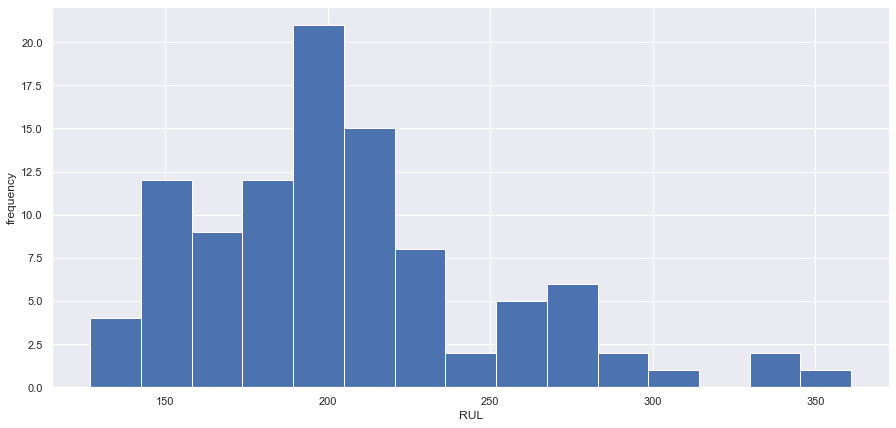

In [112]:
# distribution of RUL, similar to the 'describe function' of time_cycles above, but visual
df_max_rul = train[['unit_nr', 'RUL']].groupby('unit_nr').max().reset_index()
df_max_rul['RUL'].hist(bins=15, figsize=(15,7))
plt.xlabel('RUL')
plt.ylabel('frequency')
plt.show()

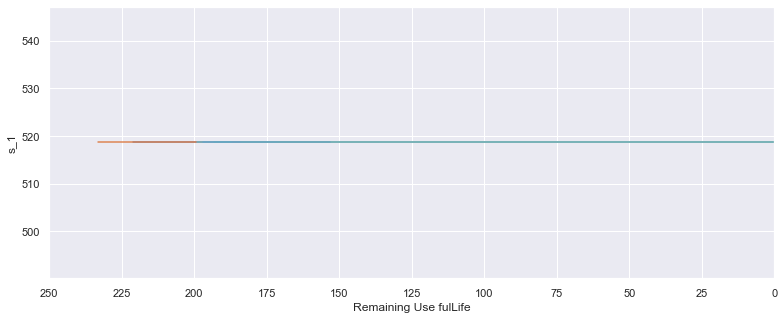

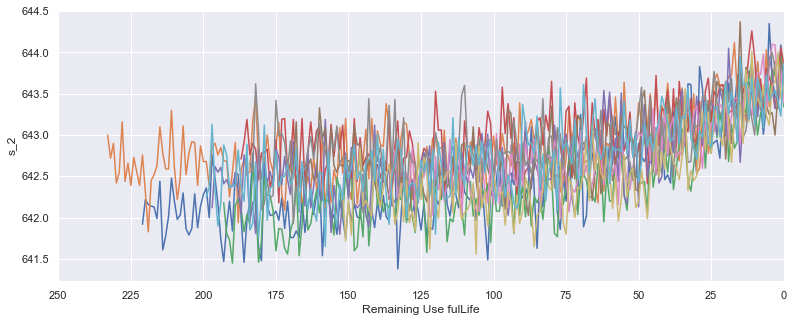

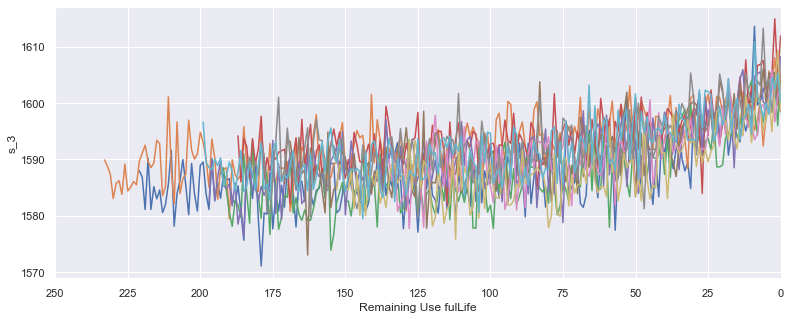

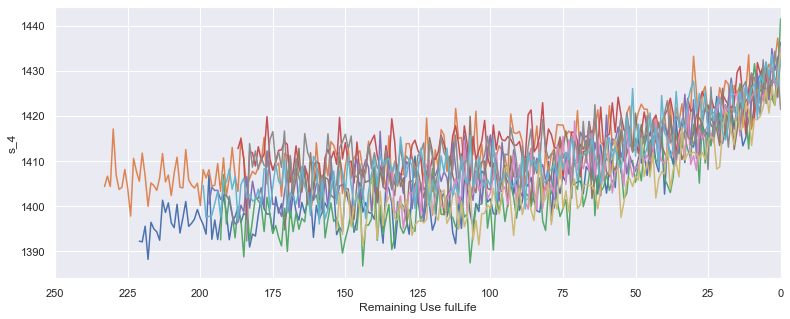

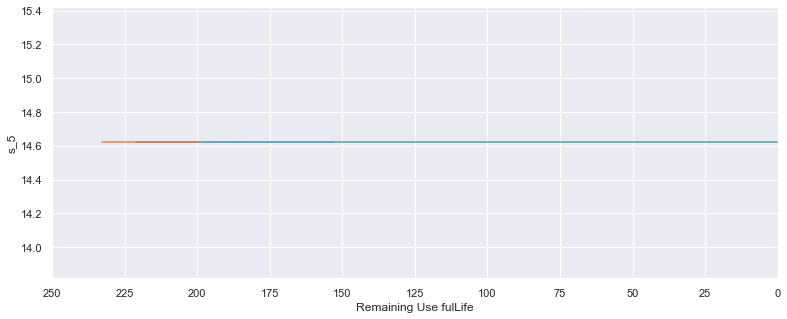

...

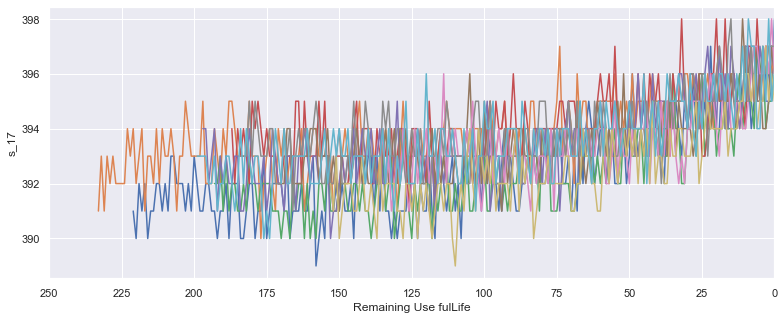

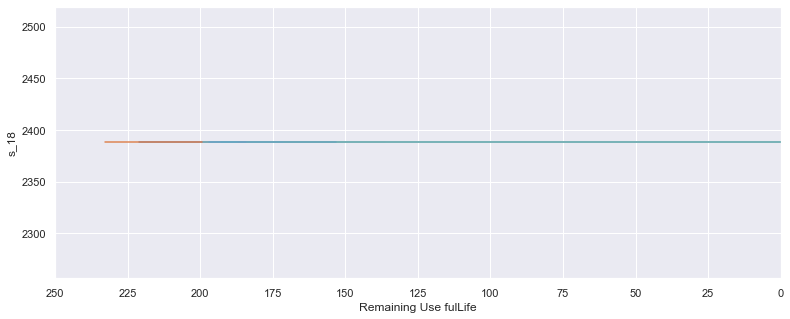

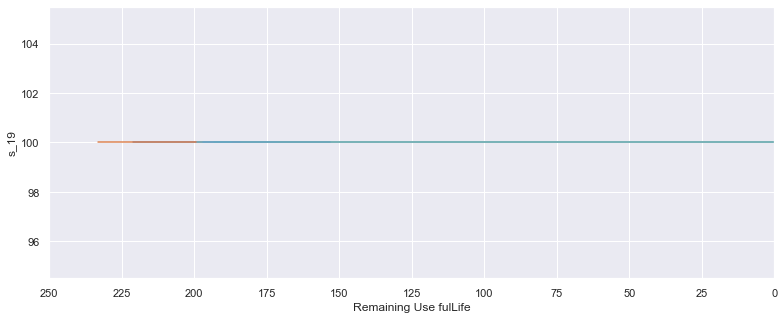

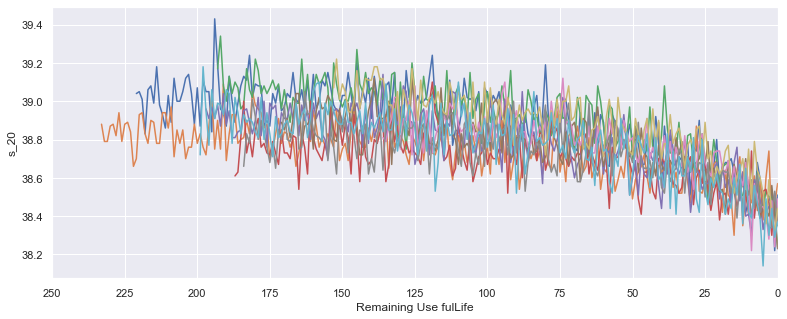

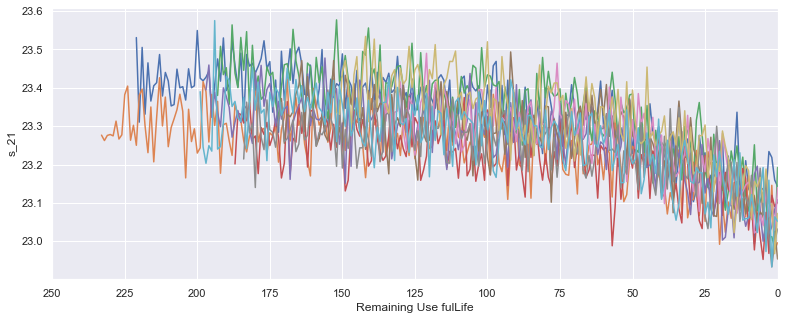

In [113]:
def plot_sensor(sensor_name):
    plt.figure(figsize=(13,5))
    for i in train['unit_nr'].unique():
        if (i % 10 == 0):  # only plot every 10th unit_nr
            plt.plot('RUL', sensor_name, 
                     data=train[train['unit_nr']==i])
    plt.xlim(250, 0)  # reverse the x-axis so RUL counts down to zero
    plt.xticks(np.arange(0, 275, 25))
    plt.ylabel(sensor_name)
    plt.xlabel('Remaining Use fulLife')
    plt.show()

for sensor_name in sensor_names:
    plot_sensor(sensor_name)

based on the plots you can see sensors 1, 5, 6, 10, 16, 18 and 19 hold no information related to Remaining Useful Life as the sensor values remain constant throughout time

Time to create our baseline model which takes into account all sensors which hold some information related to RUL

In [114]:
drop_sensors = ['s_1','s_5','s_6','s_10','s_16','s_18','s_19']
drop_labels = index_names+setting_names+drop_sensors

X_train = train.drop(drop_labels, axis=1)
X_train

C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,s_2,s_3,s_4,s_7,s_8,s_9,s_11,s_12,s_13,s_14,s_15,s_17,s_20,s_21,RUL
0,641.82,1589.70,1400.60,554.36,2388.06,9046.19,47.47,521.66,2388.02,8138.62,8.4195,392,39.06,23.4190,191
1,642.15,1591.82,1403.14,553.75,2388.04,9044.07,47.49,522.28,2388.07,8131.49,8.4318,392,39.00,23.4236,190
2,642.35,1587.99,1404.20,554.26,2388.08,9052.94,47.27,522.42,2388.03,8133.23,8.4178,390,38.95,23.3442,189
3,642.35,1582.79,1401.87,554.45,2388.11,9049.48,47.13,522.86,2388.08,8133.83,8.3682,392,38.88,23.3739,188
4,642.37,1582.85,1406.22,554.00,2388.06,9055.15,47.28,522.19,2388.04,8133.80,8.4294,393,38.90,23.4044,187
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20626,643.49,1597.98,1428.63,551.43,2388.19,9065.52,48.07,519.49,2388.26,8137.60,8.4956,397,38.49,22.9735,4
20627,643.54,1604.50,1433.58,550.86,2388.23,9065.11,48.04,519.68,2388.22,8136.50,8.5139,395,38.30,23.1594,3
20628,643.42,1602.46,1428.18,550.94,2388.24,9065.90,48.09,520.01,2388.24,8141.05,8.5646,398,38.44,22.9333,2
20629,643.23,1605.26,1426.53,550.68,2388.25,9073.72,48.39,519.67,2388.23,8139.29,8.5389,395,38.29,23.0640,1


C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\seaborn\axisgrid.py:1912: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


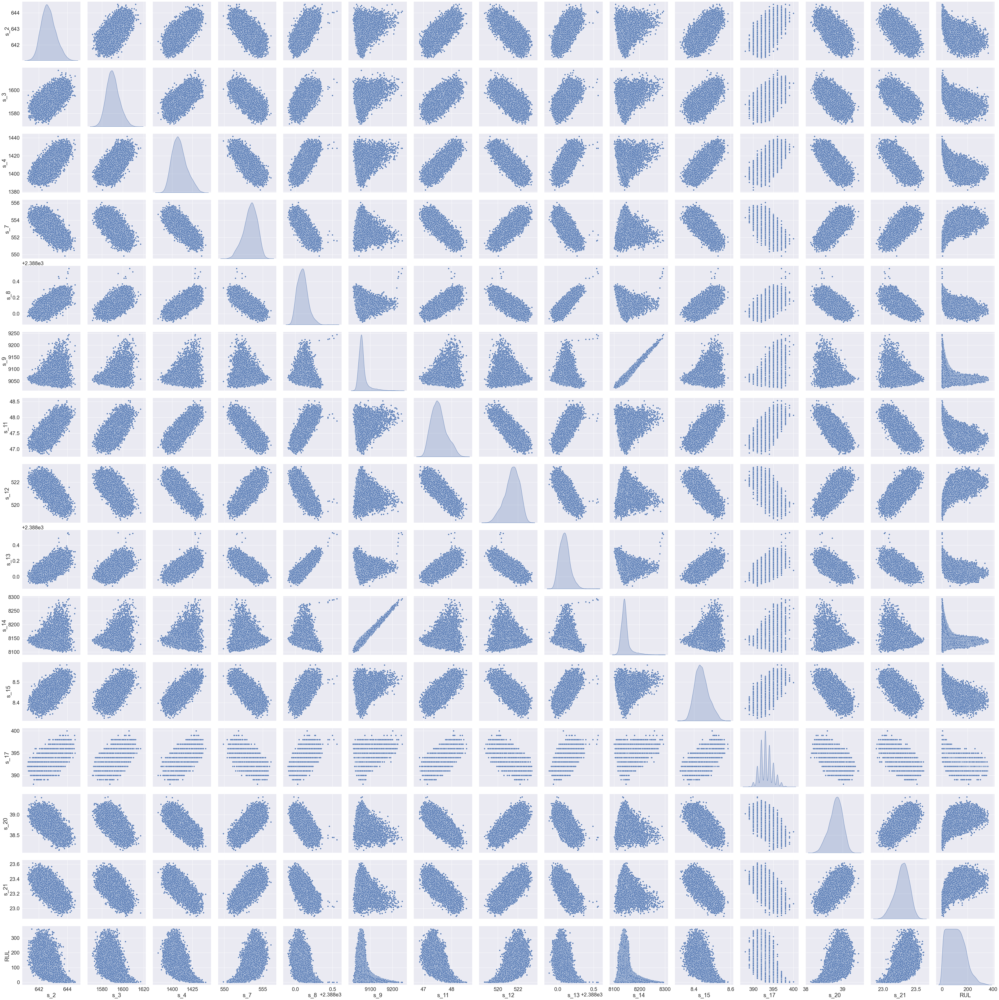

In [115]:
import seaborn as sns

sns.set(font_scale=2)
sns.pairplot(X_train,size=4,markers="o",diag_kind="kde")

C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


<AxesSubplot:>

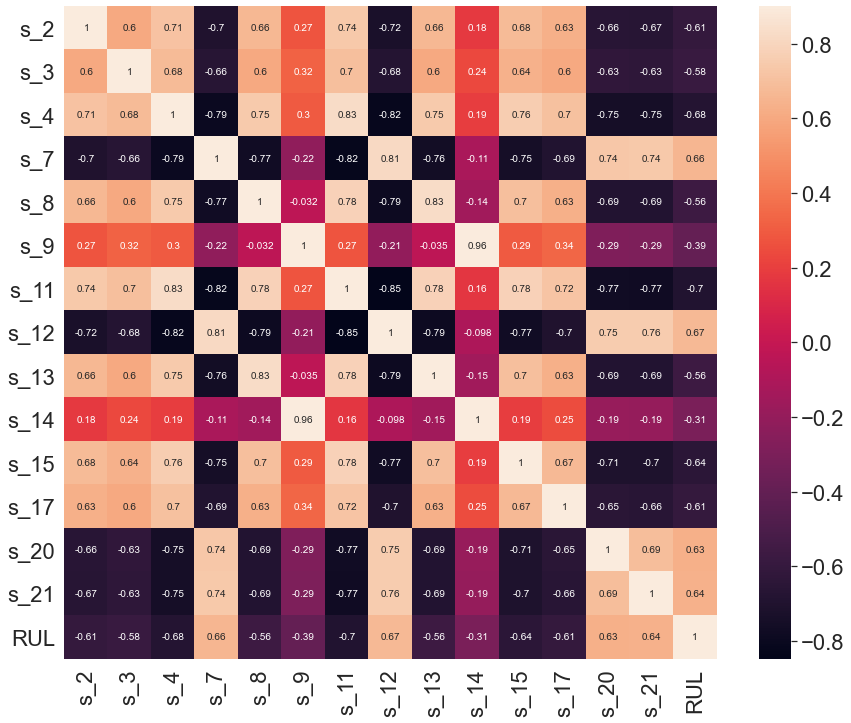

In [116]:
%matplotlib inline
import matplotlib.pyplot as plt  # Matlab-style plotting

corrmat = X_train.corr()
plt.subplots(figsize=(15,12))
sns.heatmap(corrmat, vmax=0.9, square=True,annot=True)    

<AxesSubplot:>

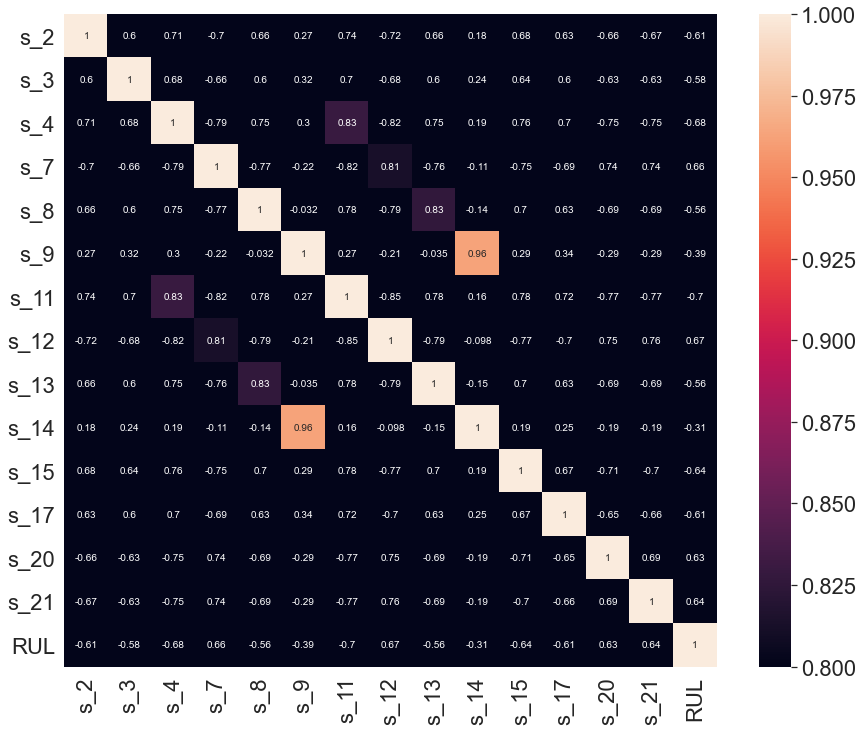

In [117]:
%matplotlib inline
import matplotlib.pyplot as plt  # Matlab-style plotting

corrmat = X_train.corr()
plt.subplots(figsize=(15,12))
sns.heatmap(corrmat, vmin=0.8, vmax=1, square=True,annot=True)    

In [118]:
# S_9 and s_14,       S_4 andS_12,    S_7 and S_11  S_11andS12
#keep   S_9, S_12   S11,  remove   S_14, S4, S7 

<AxesSubplot:>

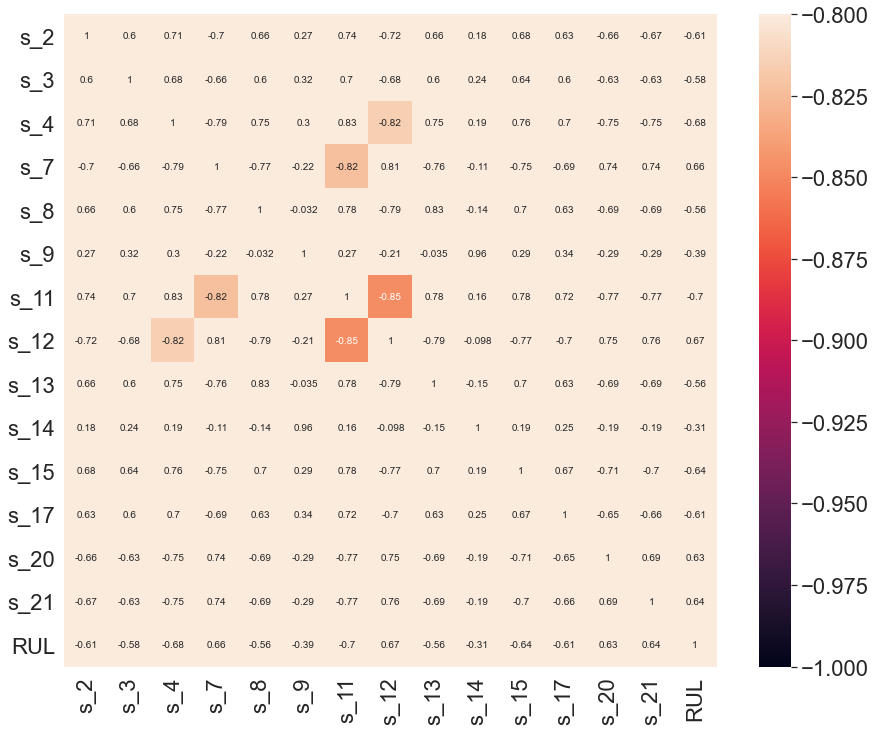

In [119]:
%matplotlib inline
import matplotlib.pyplot as plt  # Matlab-style plotting

corrmat = X_train.corr()
plt.subplots(figsize=(15,12))
sns.heatmap(corrmat, vmin=-1, vmax=-0.8, square=True,annot=True) 

In [120]:
drop_sensors2 = ['s_4','s_7','s_14']


drop_labels=drop_labels+drop_sensors2
X_train = train.drop(drop_labels, axis=1)
X_train

,s_2,s_3,s_8,s_9,s_11,s_12,s_13,s_15,s_17,s_20,s_21,RUL
0,641.82,1589.70,2388.06,9046.19,47.47,521.66,2388.02,8.4195,392,39.06,23.4190,191
1,642.15,1591.82,2388.04,9044.07,47.49,522.28,2388.07,8.4318,392,39.00,23.4236,190
2,642.35,1587.99,2388.08,9052.94,47.27,522.42,2388.03,8.4178,390,38.95,23.3442,189
3,642.35,1582.79,2388.11,9049.48,47.13,522.86,2388.08,8.3682,392,38.88,23.3739,188
4,642.37,1582.85,2388.06,9055.15,47.28,522.19,2388.04,8.4294,393,38.90,23.4044,187
...,...,...,...,...,...,...,...,...,...,...,...,...
20626,643.49,1597.98,2388.19,9065.52,48.07,519.49,2388.26,8.4956,397,38.49,22.9735,4
20627,643.54,1604.50,2388.23,9065.11,48.04,519.68,2388.22,8.5139,395,38.30,23.1594,3
20628,643.42,1602.46,2388.24,9065.90,48.09,520.01,2388.24,8.5646,398,38.44,22.9333,2
20629,643.23,1605.26,2388.25,9073.72,48.39,519.67,2388.23,8.5389,395,38.29,23.0640,1


## Baseline Regression

In [121]:
# first create an evaluate function
def evaluate(y_true, y_hat, label='test'):
    mse = mean_squared_error(y_true, y_hat)
    rmse = np.sqrt(mse)
    variance = r2_score(y_true, y_hat)
    print('{} set RMSE:{}, R2:{}'.format(label, rmse, variance))

C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [122]:

y_train = X_train.pop('RUL')

# Since the true RUL values for the test set are only provided for the last time cycle of each enginge, 
# the test set is subsetted to represent the same
X_test = test.groupby('unit_nr').last().reset_index().drop(drop_labels, axis=1)


print(X_train.columns)  # check remaining columns

Index(['s_2', 's_3', 's_8', 's_9', 's_11', 's_12', 's_13', 's_15', 's_17',
       's_20', 's_21'],
      dtype='object')


In [123]:
# create and fit model
lm = LinearRegression()
lm.fit(X_train, y_train)

# predict and evaluate
y_hat_train = lm.predict(X_train)
evaluate(y_train, y_hat_train, 'train')

y_hat_test = lm.predict(X_test)
evaluate(y_test, y_hat_test)

train set RMSE:44.92047477985227, R2:0.5746847415110611
test set RMSE:31.489748149970023, R2:0.4257793185145302


In [124]:
print('train RMSE: {0:.2e}'.format(np.sqrt(mean_squared_error(y_train, y_hat_train))))
print('train R2: {0:.3f}'.format(r2_score(y_train, y_hat_train)))

print('test RMSE: {0:.2e}'.format(np.sqrt(mean_squared_error(y_test, y_hat_test))))
print('test R2: {0:.3f}'.format(r2_score(y_test, y_hat_test)))

train RMSE: 4.49e+01
train R2: 0.575
test RMSE: 3.15e+01
test R2: 0.426


C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Note the RMSE on the test set is lower. This may be explained because the RUL of the training set contains more samples of high RUL compared to the test set and high RUL does not necessarily correlate with the sensor signals. See image below

C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Text(0, 0.5, 'Test_predicted')

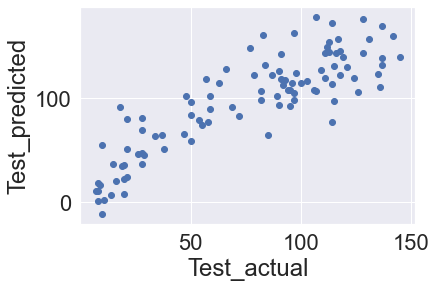

In [125]:
plt.scatter(y_test, y_hat_test)
plt.xlabel("Test_actual")
plt.ylabel("Test_predicted")


In [126]:
X_test

,s_2,s_3,s_8,s_9,s_11,s_12,s_13,s_15,s_17,s_20,s_21
0,642.58,1581.22,2388.08,9056.40,47.23,521.79,2388.06,8.4024,393,38.81,23.3552
1,642.55,1586.59,2388.10,9044.77,47.67,521.74,2388.09,8.4505,391,38.81,23.2618
2,642.88,1589.75,2388.16,9049.26,47.88,520.83,2388.14,8.4119,395,38.93,23.2740
3,642.78,1594.53,2388.13,9051.30,47.65,521.88,2388.11,8.4634,395,38.58,23.2581
4,642.27,1589.94,2388.10,9053.99,47.46,521.00,2388.15,8.4362,394,38.75,23.4117
...,...,...,...,...,...,...,...,...,...,...,...
95,642.30,1590.88,2388.03,9062.41,47.14,522.30,2388.01,8.4110,391,38.96,23.4606
96,642.59,1582.96,2388.06,9076.36,47.38,521.58,2388.06,8.4500,395,38.61,23.2953
97,642.68,1599.51,2388.13,9062.34,47.66,521.53,2388.09,8.4235,394,38.76,23.3608
98,642.00,1585.03,2388.01,9067.16,47.26,521.82,2388.02,8.4003,391,38.95,23.3595


In [127]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler

from sklearn.preprocessing import PolynomialFeatures

RMSE_train = []
RMSE_test = []
for degree in range(2, 8,2):
    steps_h = [('poly', PolynomialFeatures(degree = degree)),
               ('Rescale', MinMaxScaler()),
               ('lr', LinearRegression())]
    model_h = Pipeline(steps_h)
    model_h.fit(X_train, y_train)
    y_train_pred_h = model_h.predict(X_train)
    y_test_pred_h = model_h.predict(X_test)
    RMSE_train.append(np.sqrt(mean_squared_error(y_train, y_train_pred_h)))
    RMSE_test.append(np.sqrt(mean_squared_error(y_test, y_test_pred_h)))

C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


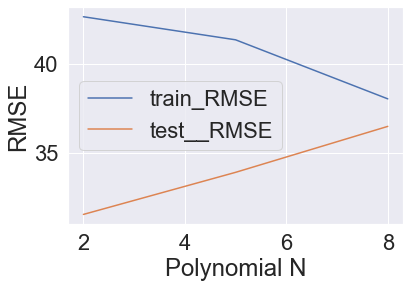

In [128]:
plt.plot(np.linspace(2, 8, 3), RMSE_train,label="train_RMSE")
plt.plot(np.linspace(2, 8, 3), RMSE_test,label="test__RMSE")
plt.xlabel("Polynomial N")
plt.ylabel("RMSE")
plt.legend()

In [131]:
X_test

C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,s_2,s_3,s_8,s_9,s_11,s_12,s_13,s_15,s_17,s_20,s_21
0,642.58,1581.22,2388.08,9056.40,47.23,521.79,2388.06,8.4024,393,38.81,23.3552
1,642.55,1586.59,2388.10,9044.77,47.67,521.74,2388.09,8.4505,391,38.81,23.2618
2,642.88,1589.75,2388.16,9049.26,47.88,520.83,2388.14,8.4119,395,38.93,23.2740
3,642.78,1594.53,2388.13,9051.30,47.65,521.88,2388.11,8.4634,395,38.58,23.2581
4,642.27,1589.94,2388.10,9053.99,47.46,521.00,2388.15,8.4362,394,38.75,23.4117
...,...,...,...,...,...,...,...,...,...,...,...
95,642.30,1590.88,2388.03,9062.41,47.14,522.30,2388.01,8.4110,391,38.96,23.4606
96,642.59,1582.96,2388.06,9076.36,47.38,521.58,2388.06,8.4500,395,38.61,23.2953
97,642.68,1599.51,2388.13,9062.34,47.66,521.53,2388.09,8.4235,394,38.76,23.3608
98,642.00,1585.03,2388.01,9067.16,47.26,521.82,2388.02,8.4003,391,38.95,23.3595


In [91]:
steps_h = [('poly', PolynomialFeatures(degree = 6)),
               ('Rescale', MinMaxScaler()),
               ('lr', LinearRegression())]
model_h = Pipeline(steps_h)
model_h.fit(X_train, y_train)
y_train_pred_h = model_h.predict(X_train)
y_test_pred_h = model_h.predict(X_test)
RMSE_train.append(np.sqrt(mean_squared_error(y_train, y_train_pred_h)))
RMSE_test.append(np.sqrt(mean_squared_error(y_test, y_test_pred_h)))

print('train RMSE: {0:.2e}'.format(np.sqrt(mean_squared_error(y_train, y_train_pred))))
print('train R2: {0:.3f}'.format(r2_score(y_train, y_train_pred)))

print('test RMSE: {0:.2e}'.format(np.sqrt(mean_squared_error(y_test, y_test_pred))))
print('test R2: {0:.3f}'.format(r2_score(y_test, y_test_pred)))


train MSE: 1.45e+03
train R2: 0.695
test MSE: 1.33e+03
test R2: 0.229


train MSE: 1.82e+03
train R2: 0.617
test MSE: 9.96e+02
test R2: 0.423


C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [73]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler

from sklearn.preprocessing import PolynomialFeatures

In [74]:
from sklearn.linear_model import Lasso

# hide warning message
import warnings
warnings.filterwarnings("once")

In [75]:
#alphas = range(1, 30)
alphas = [0.001,0.01,1,5,10]
rmse_train = []
rmse_test = []

r2_train = []
r2_test = []
coef=[]

for alpha in alphas:
    steps = [('poly', PolynomialFeatures(degree=3)),
             ('rescale', MinMaxScaler()),
             ('lr', Lasso(alpha=alpha))]
    model = Pipeline(steps)
    model = model.fit(X_train, y_train)
    
    rmse_train.append(np.sqrt(mean_squared_error(y_train, model.predict(X_train))))
    rmse_test.append(np.sqrt(mean_squared_error(y_test, model.predict(X_test))))
    
    
    r2_train.append(r2_score(y_train, model.predict(X_train)))
    r2_test.append(r2_score(y_test, model.predict(X_test)))
    coef.append(model.named_steps['lr'].coef_)
    
    #
                   
#('lr', Lasso(alpha=alpha, max_iter=100000))]

C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15807350.081758542, tolerance: 9788.090836479087
  positive)
C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:531: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10911.051445305347, tolerance: 9788.090836479087
  positive)


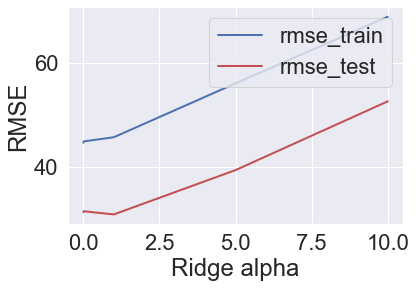

In [90]:
plt.rcParams['font.size'] = '19'
plt.plot(alphas, rmse_train,'b',linewidth=2,label="rmse_train" )
plt.plot(alphas, rmse_test, 'r',linewidth=2,label="rmse_test")
plt.xlabel("Ridge alpha")
plt.ylabel("RMSE")
plt.legend()

In [101]:
steps = [('poly', PolynomialFeatures(degree=4)),
             ('rescale', MinMaxScaler()),
             ('lr', Lasso(alpha=1))]
model = Pipeline(steps)
model = model.fit(X_train, y_train)


y_train_pred = model.predict(X_train)
y_test_pred = model.predict(X_test)
    
print('train RMSE: {0:.2e}'.format(np.sqrt(mean_squared_error(y_train, y_train_pred))))
print('train R2: {0:.3f}'.format(r2_score(y_train, y_train_pred)))

print('test RMSE: {0:.2e}'.format(np.sqrt(mean_squared_error(y_test, y_test_pred))))
print('test R2: {0:.3f}'.format(r2_score(y_test, y_test_pred)))


train RMSE: 4.57e+01
train R2: 0.559
test RMSE: 3.08e+01
test R2: 0.452


C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Text(0, 0.5, 'Test_predicted')

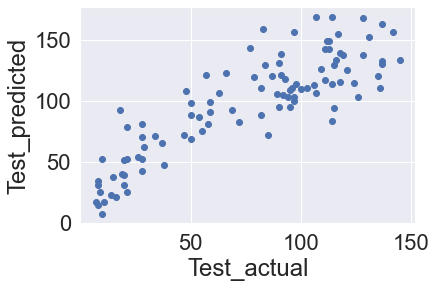

In [102]:
plt.scatter(y_test, y_test_pred)
plt.xlabel("Test_actual")
plt.ylabel("Test_predicted")


In [141]:
#RF
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [142]:
steps = [('rescale', StandardScaler()),
         ('rfm', RandomForestRegressor(oob_score=True))]
model = Pipeline(steps)
model = model.fit(X_train, y_train)

y_train_pred = model.predict(X_train)
y_test_pred = model.predict(X_test)

print('train MSE: {0:.2e}'.format(mean_squared_error(y_train, y_train_pred)))
print('train R2: {0:.3f}'.format(r2_score(y_train, y_train_pred)))

print('test MSE: {0:.2e}'.format(mean_squared_error(y_test, y_test_pred)))
print('test R2: {0:.3f}'.format(r2_score(y_test, y_test_pred)))

train MSE: 2.52e+02
train R2: 0.947
test MSE: 1.06e+03
test R2: 0.385


In [143]:
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_squared_error
from sklearn.metrics import make_scorer

scorer = make_scorer(mean_squared_error, greater_is_better = False)


param_grid={'rfm__max_depth':np.arange(1,10,2).tolist(),
             'rfm__min_samples_leaf':np.arange(1,10,2).tolist(),  
             'rfm__min_samples_split':np.arange(2,10,2).tolist()}


steps = [('rescale', StandardScaler()),
         ('rfm', RandomForestRegressor(n_jobs=-1))]
model = Pipeline(steps)


grid_search=GridSearchCV(model,param_grid,cv=5,scoring=scorer,return_train_score=True)
              

grid_search.fit(X_train, y_train)
grid_search.best_params_

C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


{'rfm__max_depth': 9, 'rfm__min_samples_leaf': 7, 'rfm__min_samples_split': 2}

C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


['rfm__max_depth', 'rfm__min_samples_leaf', 'rfm__min_samples_split']
{'rfm__max_depth': [1, 3, 5, 7, 9], 'rfm__min_samples_leaf': [1, 3, 5, 7, 9], 'rfm__min_samples_split': [2, 4, 6, 8]}
[12 32 52 72 92]
[1, 3, 5, 7, 9]
[80 84 88 92 96]
[1, 3, 5, 7, 9]
[92 93 94 95]
[2, 4, 6, 8]


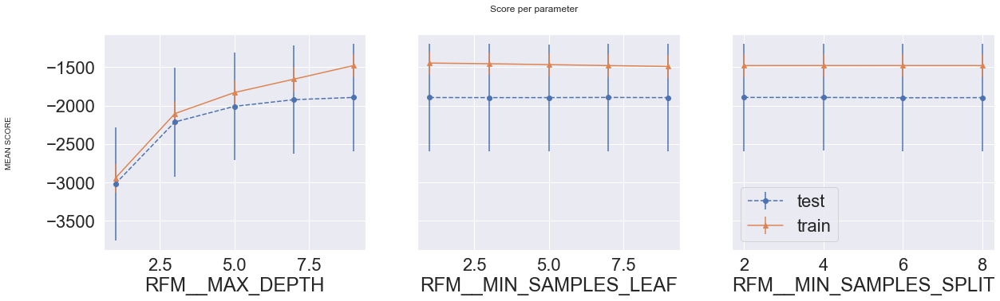

In [144]:
def plot_search_results(grid):
    """
    Params: 
        grid: A trained GridSearchCV object.
    """
    ## Results from grid search
    results = grid.cv_results_
    means_test = results['mean_test_score']
    stds_test = results['std_test_score']
    means_train = results['mean_train_score']
    stds_train = results['std_train_score']

    ## Getting indexes of values per hyper-parameter
    masks=[]
    masks_names= list(grid.best_params_.keys())
    for p_k, p_v in grid.best_params_.items():
        masks.append(list(results['param_'+p_k].data==p_v))              ##
    print(masks_names)
    

    params=grid.param_grid
    print(params)
    
   
    ## Ploting results
    fig, ax = plt.subplots(1,len(params),sharex='none', sharey='all',figsize=(20,5))
    fig.suptitle('Score per parameter')
    fig.text(0.04, 0.5, 'MEAN SCORE', va='center', rotation='vertical')
    
    pram_preformace_in_best = {}                         #{}
    
    for i, p in enumerate(masks_names):
        m = np.stack(masks[:i] + masks[i+1:])           ##
        pram_preformace_in_best
        best_parms_mask = m.all(axis=0)
        best_index = np.where(best_parms_mask)[0]
        #  best_index   [ 1  4  7 10 13 16 19 22]
        print(best_index)
        
        print(params[p])
        
        x = np.array(params[p])
        y_1 = np.array(means_test[best_index])
        e_1 = np.array(stds_test[best_index])
        y_2 = np.array(means_train[best_index])
        e_2 = np.array(stds_train[best_index])
        
        ax[i].errorbar(x, y_1, e_1, linestyle='--', marker='o', label='test')
        ax[i].errorbar(x, y_2, e_2, linestyle='-', marker='^',label='train' )
        
        ax[i].set_xlabel(p.upper())

    plt.legend()
    plt.show()

plot_search_results(grid_search)


In [147]:
grid_search.best_params_

{'rfm__max_depth': 9, 'rfm__min_samples_leaf': 7, 'rfm__min_samples_split': 2}

In [148]:
# with tunned parameters


steps = [('rescale', StandardScaler()),
         ('rfm', RandomForestRegressor(max_depth=9, min_samples_leaf=7, min_samples_split=2))]
model = Pipeline(steps)
model = model.fit(X_train, y_train)

y_train_pred = model.predict(X_train)
y_test_pred = model.predict(X_test)

print('train RMSE: {0:.2e}'.format(np.sqrt(mean_squared_error(y_train, y_train_pred))))
print('train R2: {0:.3f}'.format(r2_score(y_train, y_train_pred)))

print('test RMSE: {0:.2e}'.format(np.sqrt(mean_squared_error(y_test, y_test_pred))))
print('test R2: {0:.3f}'.format(r2_score(y_test, y_test_pred)))


train RMSE: 3.91e+01
train R2: 0.678
test RMSE: 3.20e+01
test R2: 0.406


C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Text(0, 0.5, 'Test_predicted')

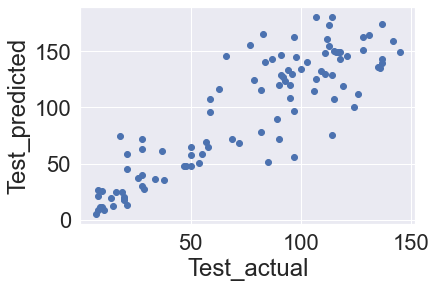

In [149]:
plt.scatter(y_test, y_test_pred)
plt.xlabel("Test_actual")
plt.ylabel("Test_predicted")


Feature ranking:
Feature s_2 (0.010554)
Feature s_3 (0.010736)
Feature s_8 (0.012100)
Feature s_9 (0.166350)
Feature s_11 (0.682255)
Feature s_12 (0.053947)
Feature s_13 (0.012535)
Feature s_15 (0.020822)
Feature s_17 (0.003436)
Feature s_20 (0.011289)
Feature s_21 (0.015976)


C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\seaborn\_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


0.6776768787829937

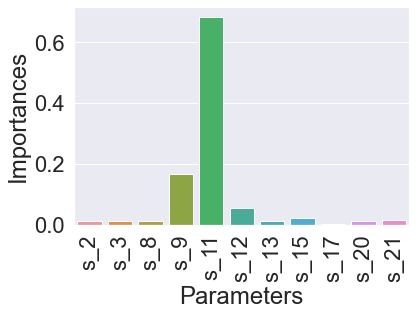

In [150]:

importances=model.steps[1][1].feature_importances_

indices=list(X_train)
print("Feature ranking:")

for f in range(X_train.shape[1]):                                                   
    print("Feature %s (%f)" % (indices[f], importances[f]))    ###

sns.barplot(indices,importances)
plt.xlabel('Parameters')
plt.ylabel('Importances')
plt.xticks(rotation='90')
model.score(X_train,y_train)  

In [41]:
X_train

C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,s_2,s_3,s_8,s_9,s_11,s_12,s_13,s_15,s_17,s_20,s_21,s_22,s_23
0,641.82,1589.70,2388.06,9046.19,47.47,521.66,2388.02,8.4195,392,39.06,23.4190,43422.999266,29.786994
1,642.15,1591.82,2388.04,9044.07,47.49,522.28,2388.07,8.4318,392,39.00,23.4236,43383.083796,29.857179
2,642.35,1587.99,2388.08,9052.94,47.27,522.42,2388.03,8.4178,390,38.95,23.3442,42980.559009,29.904236
3,642.35,1582.79,2388.11,9049.48,47.13,522.86,2388.08,8.3682,392,38.88,23.3739,42830.670944,29.969393
4,642.37,1582.85,2388.06,9055.15,47.28,522.19,2388.04,8.4294,393,38.90,23.4044,43045.185245,29.937275
...,...,...,...,...,...,...,...,...,...,...,...,...,...
20626,643.49,1597.98,2388.19,9065.52,48.07,519.49,2388.26,8.4956,397,38.49,22.9735,42505.898221,30.215121
20627,643.54,1604.50,2388.23,9065.11,48.04,519.68,2388.22,8.5139,395,38.30,23.1594,42611.721161,30.371279
20628,643.42,1602.46,2388.24,9065.90,48.09,520.01,2388.24,8.5646,398,38.44,22.9333,42394.030541,30.266129
20629,643.23,1605.26,2388.25,9073.72,48.39,519.67,2388.23,8.5389,395,38.29,23.0640,42734.203898,30.370854


C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\seaborn\axisgrid.py:1912: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


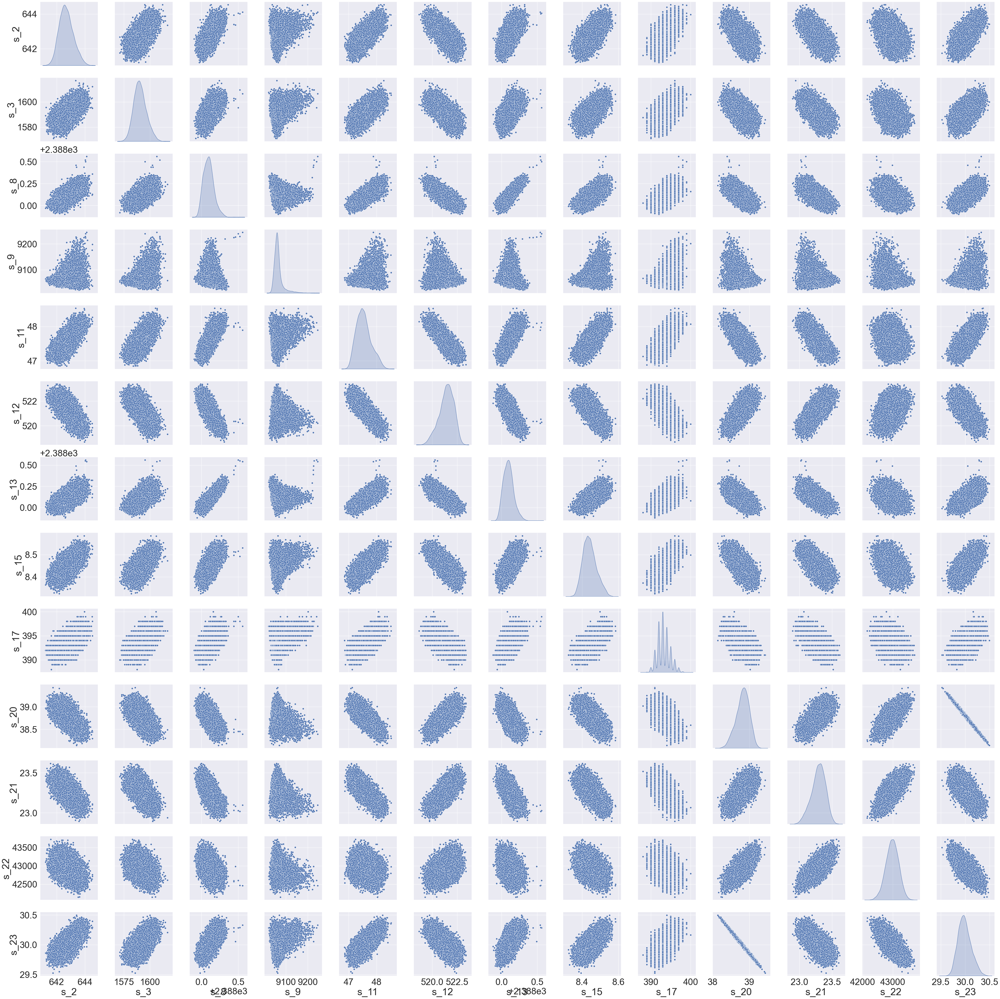

In [42]:
## feature engineering

import seaborn as sns

sns.set(font_scale=3)
sns.pairplot(X_train,size=4,markers="o",diag_kind="kde")

In [43]:

x_train=X_train
x_train['s_22']=x_train['s_2']*x_train['s_8']*x_train['s_11']
x_train['s_23']=(x_train['s_12']+x_train['s_20'])/x_train['s_9']

x_test=X_test
x_test['s_22']=x_test['s_2']*x_test['s_8']*x_test['s_11']
x_test['s_23']=(x_test['s_12']+x_test['s_20'])/x_test['s_9']

C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [38]:
X_test

,s_2,s_3,s_8,s_9,s_11,s_12,s_13,s_15,s_17,s_20,s_21,s_22,s_23
0,642.58,1581.22,2388.08,9056.40,47.23,521.79,2388.06,8.4024,393,38.81,23.3552,42809.995186,30.001804
1,642.55,1586.59,2388.10,9044.77,47.67,521.74,2388.09,8.4505,391,38.81,23.2618,43036.021133,29.999742
2,642.88,1589.75,2388.16,9049.26,47.88,520.83,2388.14,8.4119,395,38.93,23.2740,43382.000542,29.892371
3,642.78,1594.53,2388.13,9051.30,47.65,521.88,2388.11,8.4634,395,38.58,23.2581,42756.225780,30.188180
4,642.27,1589.94,2388.10,9053.99,47.46,521.00,2388.15,8.4362,394,38.75,23.4117,43055.872178,30.019871
...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,642.30,1590.88,2388.03,9062.41,47.14,522.30,2388.01,8.4110,391,38.96,23.4606,43087.137369,29.892197
96,642.59,1582.96,2388.06,9076.36,47.38,521.58,2388.06,8.4500,395,38.61,23.2953,42615.066034,30.152033
97,642.68,1599.51,2388.13,9062.34,47.66,521.53,2388.09,8.4235,394,38.76,23.3608,43154.443217,30.036378
98,642.00,1585.03,2388.01,9067.16,47.26,521.82,2388.02,8.4003,391,38.95,23.3595,42999.630331,29.879846


In [45]:
steps = [('rescale', StandardScaler()),
         ('rfm', RandomForestRegressor())]
model = Pipeline(steps)
model = model.fit(x_train, y_train)

y_train_pred = model.predict(x_train)
y_test_pred = model.predict(x_test)

print('train MSE: {0:.2e}'.format(mean_squared_error(y_train, y_train_pred)))
print('train R2: {0:.3f}'.format(r2_score(y_train, y_train_pred)))

print('test MSE: {0:.2e}'.format(mean_squared_error(y_test, y_test_pred)))
print('test R2: {0:.3f}'.format(r2_score(y_test, y_test_pred)))

C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


train MSE: 2.51e+02
train R2: 0.947
test MSE: 1.13e+03
test R2: 0.346


In [176]:

train RMSE: 4.19e+01
train R2: 0.631
test RMSE: 2.87e+01
test R2: 0.529

In [60]:
#LSTM

C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [84]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import optimizers, Sequential
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler

from pylab import rcParams

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import Model
# from keras.utils import plot_model
from tensorflow.keras.layers import Dense, LSTM, RepeatVector, TimeDistributed,Dropout, Activation
from tensorflow.keras.callbacks import ModelCheckpoint, TensorBoard

from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, precision_recall_curve
from sklearn.metrics import recall_score, classification_report, auc, roc_curve
from sklearn.metrics import precision_recall_fscore_support, f1_score

from numpy.random import seed
seed(7)

import tensorflow
tensorflow.random.set_seed(11)
import time

from sklearn.model_selection import train_test_split

SEED = 123 #used to help randomly select the data points
DATA_SPLIT_PCT = 0.2

rcParams['figure.figsize'] = 8, 6

C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [85]:
n_features = X_train.shape[1]  # nu

def temporalize(X, y, lookback):                                  ###.values
    output_X = []  
    output_y = []
    for i in range(len(X)-lookback-1):
        t = []
        for j in range(1,lookback+1):
            # Gather past records upto the lookback period
            t.append(X[[(i+j+1)], :])
        output_X.append(t)
        output_y.append(y[i+lookback+1])
    return output_X, output_y
   
lookback=1

# Temporalize the data
X_train, y_train = temporalize(X = X_train.values, y = y_train.values, lookback = lookback)


X_test, y_test = temporalize(X = X_test.values, y = y_test.values, lookback = lookback)


In [86]:
X_train = np.array(X_train)                             #[:23520]              ################
y_train = np.array(y_train)
X_test = np.array(X_test) 
y_test = np.array(y_test)                                # then cut the training results

In [87]:
X_train = X_train.reshape(X_train.shape[0], lookback, n_features)
X_test = X_test.reshape(X_test.shape[0], lookback, n_features)

In [88]:
def flatten(X):
    '''
    Flatten a 3D array.
    Input
    X            A 3D array for lstm, where the array is sample x timesteps x features.
    Output
    flattened_X  A 2D array, sample x features.
    '''
    flattened_X = np.empty((X.shape[0], X.shape[2]))  # sample x features array.
    for i in range(X.shape[0]):
        flattened_X[i] = X[i, (X.shape[1]-1), :]
    return(flattened_X)

def scale(X, scaler):
    '''
    Scale 3D array.
    Inputs
    X            A 3D array for lstm, where the array is sample x timesteps x features.
    scaler       A scaler object, e.g., sklearn.preprocessing.StandardScaler, sklearn.preprocessing.normalize
    Output
    X            Scaled 3D array.
    '''
    for i in range(X.shape[0]):
        X[i, :, :] = scaler.transform(X[i, :, :])
        
    return X

In [89]:
scaler = StandardScaler().fit(flatten(X_train))                                   ###### discussion  use X0train now   _y0
X_train_scaled = scale(X_train, scaler)
X_test_scaled = scale(X_test, scaler)


In [90]:
'''
Test: Check if the scaling is correct.

The test succeeds if all the column means 
and variances are 0 and 1, respectively, after
flattening.
'''
a = flatten(X_train_scaled)
print('colwise mean', np.mean(a, axis=0).round(6))
print('colwise variance', np.var(a, axis=0))

colwise mean [ 0. -0. -0.  0.  0. -0. -0.  0.  0. -0. -0.]
colwise variance [1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]


C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [91]:
timesteps =  X_train_scaled.shape[1] # equal to the lookback
n_features =  X_train_scaled.shape[2] # 

In [92]:
lr=0.002
adam = keras.optimizers.Adam(lr, beta_1=0.9, beta_2=0.999, epsilon=1e-08, decay=0.0)

timesteps=1
n_features=X_train.shape[-1]

#Building the model
model = Sequential()

model.add(LSTM(128, activation='relu', input_shape=(timesteps, n_features), return_sequences=True))
model.add(Dropout(0.5))

model.add(LSTM(64, return_sequences=False))
model.add(Dropout(0.5))

model.add(Dense(units=1))
model.add(Activation('linear'))  #linear

start = time.time()
model.compile(loss='mse', optimizer=adam, metrics=['mse'])
print('compilation time : {}'.format(time.time() - start))

model.summary()

C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\tensorflow\python\framework\tensor_util.py:523: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  tensor_proto.tensor_content = nparray.tostring()


compilation time : 0.007996320724487305
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_2 (LSTM)                (None, 1, 128)            71680     
_________________________________________________________________
dropout_2 (Dropout)          (None, 1, 128)            0         
_________________________________________________________________
lstm_3 (LSTM)                (None, 64)                49408     
_________________________________________________________________
dropout_3 (Dropout)          (None, 64)                0         
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 65        
_________________________________________________________________
activation_1 (Activation)    (None, 1)                 0         
Total params: 121,153
Trainable params: 121,153
Non-trainable params: 0
________

In [93]:
#model.fit(X_train_y0, y_pressure_train_y0, batch_size=256, epochs=500, validation_split=0.1)
import os
#from tensorflow.keras.callbacks import ModelCheckpoint, TensorBoard, EarlyStopping



checkpoint_path = "./cp/cp-{epoch:04d}.ckpt"
checkpoint_dir = os.path.dirname(checkpoint_path)

cp = ModelCheckpoint(filepath=checkpoint_path,      
                               save_best_only=False,    #true
                               save_freq='epoch',           #every epoch
                               save_weights_only=False,
                               verbose=0)

tb =TensorBoard(log_dir='./tb/',
                histogram_freq=0,
                write_graph=True,
                write_images=True)


model.fit(X_train, y_train, batch_size=256, epochs=50, validation_split=0.2) #,callbacks=[tb, cp]

# X_train_y0,X_train_y0[2]  !!!
# X_train_y0,X_train_y0

Epoch 1/50
65/65 [==============================] - 1s 20ms/step - loss: 14306.4180 - mse: 14306.4180 - val_loss: 17050.6309 - val_mse: 17050.6309
Epoch 2/50
65/65 [==============================] - 1s 9ms/step - loss: 11704.7148 - mse: 11704.7148 - val_loss: 15118.0693 - val_mse: 15118.0693
Epoch 3/50
65/65 [==============================] - 1s 9ms/step - loss: 10354.5107 - mse: 10354.5107 - val_loss: 13792.3877 - val_mse: 13792.3877
Epoch 4/50
65/65 [==============================] - 1s 9ms/step - loss: 9355.1846 - mse: 9355.1846 - val_loss: 12706.5635 - val_mse: 12706.5635
Epoch 5/50
65/65 [==============================] - 1s 9ms/step - loss: 8512.4307 - mse: 8512.4307 - val_loss: 11776.8857 - val_mse: 11776.8857
Epoch 6/50
65/65 [==============================] - 1s 10ms/step - loss: 7804.6948 - mse: 7804.6948 - val_loss: 10981.9326 - val_mse: 10981.9326
Epoch 7/50
65/65 [==============================] - 1s 9ms/step - loss: 7223.5088 - mse: 7223.5088 - val_loss: 10288.3389 - val_

C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\ipykernel_launcher.py:4: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  after removing the cwd from sys.path.


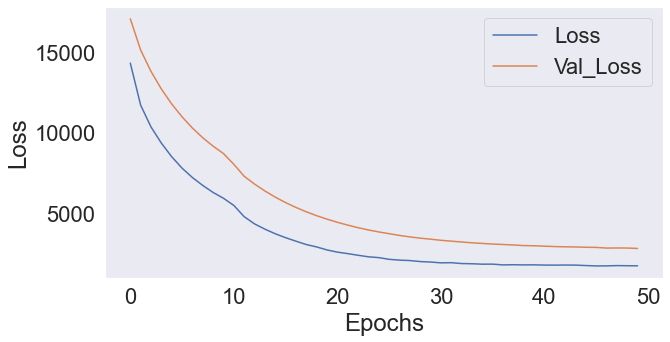

In [94]:
#Visualizing training and validaton loss
plt.figure(figsize = (10, 5))
plt.plot(model.history.history['loss'], label = 'Loss')
plt.plot(model.history.history['val_loss'], Label = 'Val_Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.grid()
plt.legend()

In [95]:
y_train_pred = model.predict(X_train)
y_test_pred = model.predict(X_test)

Text(0, 0.5, 'Test_predicted')

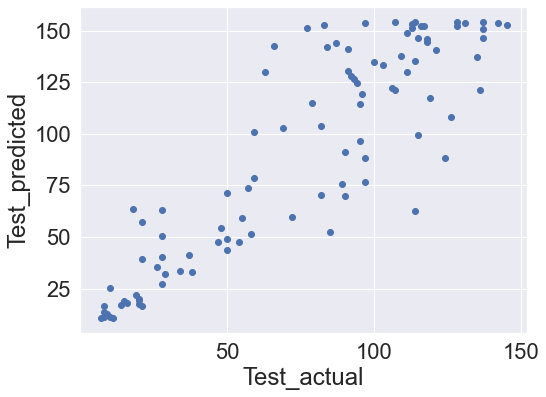

In [96]:
plt.scatter(y_test, y_test_pred)
plt.xlabel("Test_actual")
plt.ylabel("Test_predicted")


In [97]:
print('train RMSE: {0:.2e}'.format(np.sqrt(mean_squared_error(y_train, y_train_pred))))
print('train R2: {0:.3f}'.format(r2_score(y_train, y_train_pred)))

print('test RMSE: {0:.2e}'.format(np.sqrt(mean_squared_error(y_test, y_test_pred))))
print('test R2: {0:.3f}'.format(r2_score(y_test, y_test_pred)))

train RMSE: 4.25e+01
train R2: 0.620
test RMSE: 2.84e+01
test R2: 0.538


In [98]:
def LSTMREG(epochs = 4, batch = 256, lr=0.0003):
    model = Sequential()

    model.add(LSTM(128, activation='relu', input_shape=(timesteps, n_features), return_sequences=True))
    model.add(Dropout(0.5))

    model.add(LSTM(64, return_sequences=False))
    model.add(Dropout(0.5))

    model.add(Dense(units=1))
    model.add(Activation('linear'))  #linear
    model.summary()

    start = time.time()
    adam = keras.optimizers.Adam(lr, beta_1=0.9, beta_2=0.999, epsilon=1e-08, decay=0.0)
    model.compile(loss='mse', optimizer=adam, metrics=['mse'])
    print('compilation time : {}'.format(time.time() - start))
    
    return model


C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [99]:
keras_reg = keras.wrappers.scikit_learn.KerasRegressor(LSTMREG)
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import GridSearchCV

from sklearn.metrics import mean_squared_error
from sklearn.metrics import make_scorer
 

keras_param_space = {"epochs": [50,100],
                      "batch_size": [16,32,64,128,256],
                      "lr": [0.00002,0.0001,0.0004,0.003,0.001] 
}

keras_rand_search = GridSearchCV(keras_reg, keras_param_space, cv=3)                               # scoring="accuracy", n_jobs=1, verbose=True)

keras_rand_search.fit(X_train, y_train, batch_size=256, epochs=50, validation_split=0.2)

C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\tensorflow\python\framework\tensor_util.py:523: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  tensor_proto.tensor_content = nparray.tostring()


Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_4 (LSTM)                (None, 1, 128)            71680     
_________________________________________________________________
dropout_4 (Dropout)          (None, 1, 128)            0         
_________________________________________________________________
lstm_5 (LSTM)                (None, 64)                49408     
_________________________________________________________________
dropout_5 (Dropout)          (None, 64)                0         
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 65        
_________________________________________________________________
activation_2 (Activation)    (None, 1)                 0         
Total params: 121,153
Trainable params: 121,153
Non-trainable params: 0
________________________________________________

43/43 [==============================] - 0s 10ms/step - loss: 15629.6455 - mse: 15629.6455 - val_loss: 18830.5391 - val_mse: 18830.5391
Epoch 49/50
43/43 [==============================] - 0s 10ms/step - loss: 15597.2246 - mse: 15597.2246 - val_loss: 18792.0664 - val_mse: 18792.0664
Epoch 50/50
430/430 [==============================] - 1s 3ms/step - loss: 13574.3926 - mse: 13574.3926
Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_6 (LSTM)                (None, 1, 128)            71680     
_________________________________________________________________
dropout_6 (Dropout)          (None, 1, 128)            0         
_________________________________________________________________
lstm_7 (LSTM)                (None, 64)                49408     
_________________________________________________________________
dropout_7 (Dropout)          (None, 64)                0      

Epoch 44/50
43/43 [==============================] - 0s 10ms/step - loss: 14690.9902 - mse: 14690.9902 - val_loss: 19047.4922 - val_mse: 19047.4922
Epoch 45/50
43/43 [==============================] - 0s 10ms/step - loss: 14667.0820 - mse: 14667.0820 - val_loss: 19010.0605 - val_mse: 19010.0605
Epoch 46/50
43/43 [==============================] - 0s 10ms/step - loss: 14636.8555 - mse: 14636.8555 - val_loss: 18973.0801 - val_mse: 18973.0801
Epoch 47/50
43/43 [==============================] - 0s 10ms/step - loss: 14609.4473 - mse: 14609.4473 - val_loss: 18936.9297 - val_mse: 18936.9297
Epoch 48/50
43/43 [==============================] - 0s 10ms/step - loss: 14580.2744 - mse: 14580.2744 - val_loss: 18901.4375 - val_mse: 18901.4375
Epoch 49/50
43/43 [==============================] - 0s 10ms/step - loss: 14554.0879 - mse: 14554.0879 - val_loss: 18866.9355 - val_mse: 18866.9355
Epoch 50/50
430/430 [==============================] - 1s 3ms/step - loss: 15412.9170 - mse: 15412.9170
Model: "

Epoch 40/50
43/43 [==============================] - 0s 10ms/step - loss: 13747.7764 - mse: 13747.7764 - val_loss: 19045.9082 - val_mse: 19045.9082
Epoch 41/50
43/43 [==============================] - 0s 10ms/step - loss: 13713.9033 - mse: 13713.9033 - val_loss: 19012.3574 - val_mse: 19012.3574
Epoch 42/50
43/43 [==============================] - 0s 9ms/step - loss: 13677.1172 - mse: 13677.1172 - val_loss: 18979.2402 - val_mse: 18979.2402
Epoch 43/50
43/43 [==============================] - 0s 10ms/step - loss: 13643.7539 - mse: 13643.7539 - val_loss: 18946.2676 - val_mse: 18946.2676
Epoch 44/50
43/43 [==============================] - 0s 10ms/step - loss: 13606.5469 - mse: 13606.5469 - val_loss: 18913.8086 - val_mse: 18913.8086
Epoch 45/50
43/43 [==============================] - 0s 10ms/step - loss: 13575.9326 - mse: 13575.9326 - val_loss: 18882.0312 - val_mse: 18882.0312
Epoch 46/50
43/43 [==============================] - 0s 10ms/step - loss: 13545.9805 - mse: 13545.9805 - val_loss

43/43 [==============================] - 0s 10ms/step - loss: 13119.4111 - mse: 13119.4111 - val_loss: 16199.8027 - val_mse: 16199.8027
Epoch 36/50
43/43 [==============================] - 0s 10ms/step - loss: 13056.7461 - mse: 13056.7461 - val_loss: 16143.5684 - val_mse: 16143.5684
Epoch 37/50
43/43 [==============================] - 0s 10ms/step - loss: 13003.0830 - mse: 13003.0830 - val_loss: 16088.7939 - val_mse: 16088.7939
Epoch 38/50
43/43 [==============================] - 0s 10ms/step - loss: 12942.8975 - mse: 12942.8975 - val_loss: 16034.7041 - val_mse: 16034.7041
Epoch 39/50
43/43 [==============================] - 0s 10ms/step - loss: 12903.0811 - mse: 12903.0811 - val_loss: 15981.6348 - val_mse: 15981.6348
Epoch 40/50
43/43 [==============================] - 0s 10ms/step - loss: 12847.4678 - mse: 12847.4678 - val_loss: 15929.7510 - val_mse: 15929.7510
Epoch 41/50
43/43 [==============================] - 0s 10ms/step - loss: 12804.8232 - mse: 12804.8232 - val_loss: 15878.317

Epoch 31/50
43/43 [==============================] - 0s 10ms/step - loss: 12335.1885 - mse: 12335.1885 - val_loss: 16438.4785 - val_mse: 16438.4785
Epoch 32/50
43/43 [==============================] - 0s 10ms/step - loss: 12277.4316 - mse: 12277.4316 - val_loss: 16377.1621 - val_mse: 16377.1621
Epoch 33/50
43/43 [==============================] - 0s 10ms/step - loss: 12225.8701 - mse: 12225.8701 - val_loss: 16317.5166 - val_mse: 16317.5166
Epoch 34/50
43/43 [==============================] - 0s 9ms/step - loss: 12162.6914 - mse: 12162.6914 - val_loss: 16259.0303 - val_mse: 16259.0303
Epoch 35/50
43/43 [==============================] - 0s 10ms/step - loss: 12112.6904 - mse: 12112.6904 - val_loss: 16202.1475 - val_mse: 16202.1475
Epoch 36/50
43/43 [==============================] - 0s 9ms/step - loss: 12052.2598 - mse: 12052.2598 - val_loss: 16146.0332 - val_mse: 16146.0332
Epoch 37/50
43/43 [==============================] - 0s 9ms/step - loss: 11998.0820 - mse: 11998.0820 - val_loss: 

43/43 [==============================] - 0s 10ms/step - loss: 11754.9277 - mse: 11754.9277 - val_loss: 16686.9902 - val_mse: 16686.9902
Epoch 27/50
43/43 [==============================] - 0s 10ms/step - loss: 11689.5879 - mse: 11689.5879 - val_loss: 16603.6738 - val_mse: 16603.6738
Epoch 28/50
43/43 [==============================] - 0s 9ms/step - loss: 11626.1641 - mse: 11626.1641 - val_loss: 16523.7227 - val_mse: 16523.7227
Epoch 29/50
43/43 [==============================] - 0s 10ms/step - loss: 11559.1562 - mse: 11559.1562 - val_loss: 16446.1641 - val_mse: 16446.1641
Epoch 30/50
43/43 [==============================] - 0s 10ms/step - loss: 11503.0879 - mse: 11503.0879 - val_loss: 16370.8320 - val_mse: 16370.8320
Epoch 31/50
43/43 [==============================] - 0s 10ms/step - loss: 11437.0166 - mse: 11437.0166 - val_loss: 16298.1318 - val_mse: 16298.1318
Epoch 32/50
43/43 [==============================] - 0s 10ms/step - loss: 11387.2148 - mse: 11387.2148 - val_loss: 16227.5391

Epoch 22/50
43/43 [==============================] - 0s 10ms/step - loss: 10917.5947 - mse: 10917.5947 - val_loss: 13784.8604 - val_mse: 13784.8604
Epoch 23/50
43/43 [==============================] - 0s 10ms/step - loss: 10786.9336 - mse: 10786.9336 - val_loss: 13637.0488 - val_mse: 13637.0488
Epoch 24/50
43/43 [==============================] - 0s 10ms/step - loss: 10635.5859 - mse: 10635.5859 - val_loss: 13492.0303 - val_mse: 13492.0303
Epoch 25/50
43/43 [==============================] - 0s 10ms/step - loss: 10523.3545 - mse: 10523.3545 - val_loss: 13350.7031 - val_mse: 13350.7031
Epoch 26/50
43/43 [==============================] - 0s 10ms/step - loss: 10401.2939 - mse: 10401.2939 - val_loss: 13212.4814 - val_mse: 13212.4814
Epoch 27/50
43/43 [==============================] - 0s 10ms/step - loss: 10265.7305 - mse: 10265.7305 - val_loss: 13076.8291 - val_mse: 13076.8291
Epoch 28/50
43/43 [==============================] - 0s 10ms/step - loss: 10148.3506 - mse: 10148.3506 - val_los

Epoch 18/50
43/43 [==============================] - 0s 10ms/step - loss: 10661.2803 - mse: 10661.2803 - val_loss: 14534.5342 - val_mse: 14534.5342
Epoch 19/50
43/43 [==============================] - 0s 10ms/step - loss: 10500.1396 - mse: 10500.1396 - val_loss: 14372.6279 - val_mse: 14372.6279
Epoch 20/50
43/43 [==============================] - 0s 10ms/step - loss: 10360.3311 - mse: 10360.3311 - val_loss: 14213.1602 - val_mse: 14213.1602
Epoch 21/50
43/43 [==============================] - 0s 10ms/step - loss: 10224.6045 - mse: 10224.6045 - val_loss: 14058.6104 - val_mse: 14058.6104
Epoch 22/50
43/43 [==============================] - 0s 10ms/step - loss: 10100.7549 - mse: 10100.7549 - val_loss: 13907.1973 - val_mse: 13907.1973
Epoch 23/50
43/43 [==============================] - 0s 10ms/step - loss: 9963.2559 - mse: 9963.2559 - val_loss: 13758.6357 - val_mse: 13758.6357
Epoch 24/50
43/43 [==============================] - 0s 10ms/step - loss: 9832.6787 - mse: 9832.6787 - val_loss: 1

Epoch 14/50
43/43 [==============================] - 0s 10ms/step - loss: 10311.3145 - mse: 10311.3145 - val_loss: 14849.0088 - val_mse: 14849.0088
Epoch 15/50
43/43 [==============================] - 0s 10ms/step - loss: 10143.7188 - mse: 10143.7188 - val_loss: 14662.5752 - val_mse: 14662.5752
Epoch 16/50
43/43 [==============================] - 0s 10ms/step - loss: 9995.5791 - mse: 9995.5791 - val_loss: 14484.0801 - val_mse: 14484.0801
Epoch 17/50
43/43 [==============================] - 0s 10ms/step - loss: 9856.9727 - mse: 9856.9727 - val_loss: 14312.1016 - val_mse: 14312.1016
Epoch 18/50
43/43 [==============================] - 0s 10ms/step - loss: 9714.7598 - mse: 9714.7598 - val_loss: 14145.2305 - val_mse: 14145.2305
Epoch 19/50
43/43 [==============================] - 0s 9ms/step - loss: 9563.5889 - mse: 9563.5889 - val_loss: 13984.3828 - val_mse: 13984.3828
Epoch 20/50
43/43 [==============================] - 0s 10ms/step - loss: 9434.0986 - mse: 9434.0986 - val_loss: 13826.61

43/43 [==============================] - 0s 10ms/step - loss: 6720.6104 - mse: 6720.6104 - val_loss: 8815.7305 - val_mse: 8815.7305
Epoch 11/50
43/43 [==============================] - 0s 10ms/step - loss: 6356.3755 - mse: 6356.3755 - val_loss: 8409.7744 - val_mse: 8409.7744
Epoch 12/50
43/43 [==============================] - 0s 10ms/step - loss: 5924.0264 - mse: 5924.0264 - val_loss: 7767.5215 - val_mse: 7767.5215
Epoch 13/50
43/43 [==============================] - 0s 10ms/step - loss: 5230.4380 - mse: 5230.4380 - val_loss: 7045.2148 - val_mse: 7045.2148
Epoch 14/50
43/43 [==============================] - 0s 10ms/step - loss: 4781.0239 - mse: 4781.0239 - val_loss: 6606.7329 - val_mse: 6606.7329
Epoch 15/50
43/43 [==============================] - 0s 10ms/step - loss: 4448.4424 - mse: 4448.4424 - val_loss: 6221.4888 - val_mse: 6221.4888
Epoch 16/50
43/43 [==============================] - 0s 10ms/step - loss: 4148.8481 - mse: 4148.8481 - val_loss: 5875.4307 - val_mse: 5875.4307
Epoc

Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 7241.3975 - mse: 7241.3975 - val_loss: 10312.7842 - val_mse: 10312.7842
Epoch 8/50
43/43 [==============================] - 0s 10ms/step - loss: 6734.9268 - mse: 6734.9268 - val_loss: 9724.4434 - val_mse: 9724.4434
Epoch 9/50
43/43 [==============================] - 0s 9ms/step - loss: 6306.9536 - mse: 6306.9536 - val_loss: 9208.4355 - val_mse: 9208.4355
Epoch 10/50
43/43 [==============================] - 0s 9ms/step - loss: 5914.8687 - mse: 5914.8687 - val_loss: 8764.0361 - val_mse: 8764.0361
Epoch 11/50
43/43 [==============================] - 0s 9ms/step - loss: 5508.1685 - mse: 5508.1685 - val_loss: 8214.4072 - val_mse: 8214.4072
Epoch 12/50
43/43 [==============================] - 0s 9ms/step - loss: 4824.0459 - mse: 4824.0459 - val_loss: 7413.0918 - val_mse: 7413.0918
Epoch 13/50
43/43 [==============================] - 0s 9ms/step - loss: 4344.6431 - mse: 4344.6431 - val_loss: 6928.4463 - val_mse: 6928.446

Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 8911.8203 - mse: 8911.8203 - val_loss: 12734.9434 - val_mse: 12734.9434
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 8073.8169 - mse: 8073.8169 - val_loss: 11812.4883 - val_mse: 11812.4883
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 7383.2051 - mse: 7383.2051 - val_loss: 11012.4219 - val_mse: 11012.4219
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 6773.3701 - mse: 6773.3701 - val_loss: 10324.0195 - val_mse: 10324.0205
Epoch 8/50
43/43 [==============================] - 0s 10ms/step - loss: 6286.8960 - mse: 6286.8960 - val_loss: 9735.4023 - val_mse: 9735.4023
Epoch 9/50
43/43 [==============================] - 0s 10ms/step - loss: 5883.0166 - mse: 5883.0166 - val_loss: 9222.7734 - val_mse: 9222.7734
Epoch 10/50
43/43 [==============================] - 0s 10ms/step - loss: 5523.7905 - mse: 5523.7905 - val_loss: 8784.3252 - val_mse: 

43/43 [==============================] - 1s 25ms/step - loss: 16381.7295 - mse: 16381.7295 - val_loss: 19350.1543 - val_mse: 19350.1543
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 15224.1738 - mse: 15224.1738 - val_loss: 17523.0566 - val_mse: 17523.0566
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 13920.6924 - mse: 13920.6924 - val_loss: 16517.1855 - val_mse: 16517.1855
Epoch 4/50
43/43 [==============================] - 0s 9ms/step - loss: 13068.5439 - mse: 13068.5439 - val_loss: 15821.8682 - val_mse: 15821.8682
Epoch 5/50
43/43 [==============================] - 0s 9ms/step - loss: 12470.1406 - mse: 12470.1406 - val_loss: 15263.1533 - val_mse: 15263.1533
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 11981.1709 - mse: 11981.1709 - val_loss: 14772.8916 - val_mse: 14772.8916
Epoch 7/50
43/43 [==============================] - ETA: 0s - loss: 11537.1123 - mse: 11537.112 - 0s 10ms/step - loss: 11537.1123 -

43/43 [==============================] - 1s 25ms/step - loss: 15338.9043 - mse: 15338.9043 - val_loss: 19471.5176 - val_mse: 19471.5176
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 14212.5693 - mse: 14212.5693 - val_loss: 17610.3457 - val_mse: 17610.3457
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 12925.1426 - mse: 12925.1426 - val_loss: 16595.0723 - val_mse: 16595.0723
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 12127.7021 - mse: 12127.7021 - val_loss: 15913.4219 - val_mse: 15913.4219
Epoch 5/50
43/43 [==============================] - 0s 9ms/step - loss: 11553.6309 - mse: 11553.6309 - val_loss: 15360.7725 - val_mse: 15360.7725
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 11086.9619 - mse: 11086.9619 - val_loss: 14871.2295 - val_mse: 14871.2295
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 10666.0576 - mse: 10666.0576 - val_loss: 14424.3486 - val

43/43 [==============================] - 1s 26ms/step - loss: 14353.0039 - mse: 14353.0039 - val_loss: 19323.8867 - val_mse: 19323.8867
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 13316.0225 - mse: 13316.0225 - val_loss: 17735.7656 - val_mse: 17735.7656
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 12085.9941 - mse: 12085.9941 - val_loss: 16580.7148 - val_mse: 16580.7148
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 11321.1406 - mse: 11321.1406 - val_loss: 15813.6211 - val_mse: 15813.6211
Epoch 5/50
43/43 [==============================] - 0s 9ms/step - loss: 10773.0801 - mse: 10773.0801 - val_loss: 15219.2598 - val_mse: 15219.2598
Epoch 6/50
43/43 [==============================] - 0s 9ms/step - loss: 10322.9473 - mse: 10322.9473 - val_loss: 14710.7305 - val_mse: 14710.7305
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 9911.5254 - mse: 9911.5254 - val_loss: 14257.3838 - val_ms

43/43 [==============================] - 1s 26ms/step - loss: 16528.0410 - mse: 16528.0410 - val_loss: 19994.0742 - val_mse: 19994.0742
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 16526.2363 - mse: 16526.2363 - val_loss: 19992.0820 - val_mse: 19992.0820
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 16524.4902 - mse: 16524.4902 - val_loss: 19990.0488 - val_mse: 19990.0488
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 16522.5938 - mse: 16522.5938 - val_loss: 19987.9121 - val_mse: 19987.9121
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 16520.6250 - mse: 16520.6250 - val_loss: 19985.6621 - val_mse: 19985.6621
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 16518.6016 - mse: 16518.6016 - val_loss: 19983.2461 - val_mse: 19983.2461
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 16516.3379 - mse: 16516.3379 - val_loss: 19980.6289 - va

43/43 [==============================] - 3s 60ms/step - loss: 15463.7324 - mse: 15463.7324 - val_loss: 19995.9180 - val_mse: 19995.9180
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 15461.7285 - mse: 15461.7285 - val_loss: 19993.6953 - val_mse: 19993.6953
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 15459.6797 - mse: 15459.6797 - val_loss: 19991.4277 - val_mse: 19991.4277
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 15457.6562 - mse: 15457.6562 - val_loss: 19989.0508 - val_mse: 19989.0508
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 15455.4082 - mse: 15455.4082 - val_loss: 19986.5625 - val_mse: 19986.5625
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 15453.1465 - mse: 15453.1465 - val_loss: 19983.8555 - val_mse: 19983.8555
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 15450.5547 - mse: 15450.5547 - val_loss: 19980.9180 - va

43/43 [==============================] - 1s 25ms/step - loss: 14455.8965 - mse: 14455.8965 - val_loss: 19680.4766 - val_mse: 19680.4766
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 14454.2021 - mse: 14454.2021 - val_loss: 19678.7793 - val_mse: 19678.7793
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 14452.4424 - mse: 14452.4424 - val_loss: 19677.0254 - val_mse: 19677.0254
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 14450.6006 - mse: 14450.6006 - val_loss: 19675.1660 - val_mse: 19675.1660
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 14448.6387 - mse: 14448.6387 - val_loss: 19673.1914 - val_mse: 19673.1914
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 14446.5283 - mse: 14446.5283 - val_loss: 19671.0371 - val_mse: 19671.0371
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 14444.1650 - mse: 14444.1650 - val_loss: 19668.6777 - va

43/43 [==============================] - 1s 25ms/step - loss: 16524.4727 - mse: 16524.4727 - val_loss: 19984.9512 - val_mse: 19984.9512
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 16512.9082 - mse: 16512.9082 - val_loss: 19969.2344 - val_mse: 19969.2344
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 16495.3535 - mse: 16495.3535 - val_loss: 19943.0156 - val_mse: 19943.0156
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 16465.1895 - mse: 16465.1895 - val_loss: 19894.1055 - val_mse: 19894.1055
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 16408.8652 - mse: 16408.8652 - val_loss: 19802.3242 - val_mse: 19802.3242
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 16306.8145 - mse: 16306.8145 - val_loss: 19640.5781 - val_mse: 19640.5781
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 16149.0117 - mse: 16149.0117 - val_loss: 19402.5996 - va

43/43 [==============================] - 1s 27ms/step - loss: 15456.8809 - mse: 15456.8809 - val_loss: 19983.6875 - val_mse: 19983.6875
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 15445.2090 - mse: 15445.2090 - val_loss: 19968.1367 - val_mse: 19968.1367
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 15426.7734 - mse: 15426.7734 - val_loss: 19941.6465 - val_mse: 19941.6465
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 15393.8232 - mse: 15393.8232 - val_loss: 19892.4902 - val_mse: 19892.4902
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 15333.0596 - mse: 15333.0596 - val_loss: 19801.6523 - val_mse: 19801.6523
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 15224.9463 - mse: 15224.9463 - val_loss: 19642.8770 - val_mse: 19642.8770
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 15058.9199 - mse: 15058.9199 - val_loss: 19418.3750 - va

43/43 [==============================] - 1s 26ms/step - loss: 14449.6641 - mse: 14449.6641 - val_loss: 19669.2480 - val_mse: 19669.2480
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 14435.4062 - mse: 14435.4062 - val_loss: 19653.3066 - val_mse: 19653.3066
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 14412.9121 - mse: 14412.9121 - val_loss: 19627.2246 - val_mse: 19627.2246
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 14372.8096 - mse: 14372.8096 - val_loss: 19580.3105 - val_mse: 19580.3105
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 14297.7178 - mse: 14297.7178 - val_loss: 19496.5977 - val_mse: 19496.5977
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 14168.6055 - mse: 14168.6055 - val_loss: 19358.9922 - val_mse: 19358.9922
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 13978.4824 - mse: 13978.4824 - val_loss: 19175.0020 - va

43/43 [==============================] - 1s 25ms/step - loss: 16508.8750 - mse: 16508.8750 - val_loss: 19933.9668 - val_mse: 19933.9668
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 16371.2705 - mse: 16371.2705 - val_loss: 19563.7930 - val_mse: 19563.7930
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 15830.3809 - mse: 15830.3809 - val_loss: 18636.6895 - val_mse: 18636.6895
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 15149.7354 - mse: 15149.7354 - val_loss: 17943.7383 - val_mse: 17943.7383
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 14603.4141 - mse: 14603.4141 - val_loss: 17453.8242 - val_mse: 17453.8242
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 14157.8389 - mse: 14157.8389 - val_loss: 17060.7129 - val_mse: 17060.7129
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 13779.4502 - mse: 13779.4502 - val_loss: 16732.2168 - va

43/43 [==============================] - 1s 25ms/step - loss: 15440.5732 - mse: 15440.5732 - val_loss: 19932.1230 - val_mse: 19932.1230
Epoch 2/50
43/43 [==============================] - 0s 9ms/step - loss: 15290.2559 - mse: 15290.2559 - val_loss: 19567.6680 - val_mse: 19567.6680
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 14703.8779 - mse: 14703.8779 - val_loss: 18609.6680 - val_mse: 18609.6680
Epoch 4/50
43/43 [==============================] - 0s 9ms/step - loss: 13980.3525 - mse: 13980.3525 - val_loss: 17854.9961 - val_mse: 17854.9961
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 13420.3008 - mse: 13420.3008 - val_loss: 17333.1426 - val_mse: 17333.1426
Epoch 6/50
43/43 [==============================] - 0s 9ms/step - loss: 12975.5537 - mse: 12975.5537 - val_loss: 16931.2402 - val_mse: 16931.2402
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 12617.4307 - mse: 12617.4307 - val_loss: 16603.0195 - val_m

43/43 [==============================] - 1s 25ms/step - loss: 14432.5264 - mse: 14432.5264 - val_loss: 19621.4004 - val_mse: 19621.4004
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 14265.4736 - mse: 14265.4736 - val_loss: 19313.7461 - val_mse: 19313.7461
Epoch 3/50
43/43 [==============================] - 0s 9ms/step - loss: 13661.7139 - mse: 13661.7139 - val_loss: 18581.9551 - val_mse: 18581.9551
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 12989.1660 - mse: 12989.1660 - val_loss: 17920.8438 - val_mse: 17920.8438
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 12499.9043 - mse: 12499.9043 - val_loss: 17381.0918 - val_mse: 17381.0918
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 12102.2129 - mse: 12102.2129 - val_loss: 16929.6133 - val_mse: 16929.6133
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 11760.0439 - mse: 11760.0439 - val_loss: 16552.7734 - val

43/43 [==============================] - 1s 25ms/step - loss: 15568.9219 - mse: 15568.9219 - val_loss: 17081.1172 - val_mse: 17081.1172
Epoch 2/50
43/43 [==============================] - 0s 9ms/step - loss: 12944.0889 - mse: 12944.0889 - val_loss: 15151.7617 - val_mse: 15151.7617
Epoch 3/50
43/43 [==============================] - 0s 9ms/step - loss: 11460.6182 - mse: 11460.6182 - val_loss: 13814.4561 - val_mse: 13814.4561
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 10371.2988 - mse: 10371.2988 - val_loss: 12714.2549 - val_mse: 12714.2549
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 9476.1025 - mse: 9476.1025 - val_loss: 11784.7139 - val_mse: 11784.7139
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 8725.9473 - mse: 8725.9473 - val_loss: 10986.3164 - val_mse: 10986.3164
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 8056.3062 - mse: 8056.3062 - val_loss: 10296.9092 - val_mse: 1

43/43 [==============================] - 1s 26ms/step - loss: 14640.1426 - mse: 14640.1426 - val_loss: 17338.2617 - val_mse: 17338.2617
Epoch 2/50
43/43 [==============================] - 0s 9ms/step - loss: 12146.2451 - mse: 12146.2451 - val_loss: 15370.1592 - val_mse: 15370.1592
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 10689.9482 - mse: 10689.9482 - val_loss: 14010.7666 - val_mse: 14010.7666
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 9628.9580 - mse: 9628.9580 - val_loss: 12894.9062 - val_mse: 12894.9062
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 8738.9531 - mse: 8738.9531 - val_loss: 11955.5361 - val_mse: 11955.5361
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 7995.7305 - mse: 7995.7305 - val_loss: 11143.5713 - val_mse: 11143.5713
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 7354.5713 - mse: 7354.5713 - val_loss: 10442.6650 - val_mse: 10

43/43 [==============================] - 1s 25ms/step - loss: 13573.6689 - mse: 13573.6689 - val_loss: 17113.8789 - val_mse: 17113.8789
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 11136.4395 - mse: 11136.4395 - val_loss: 14986.2236 - val_mse: 14986.2236
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 9766.5234 - mse: 9766.5234 - val_loss: 13639.2705 - val_mse: 13639.2705
Epoch 4/50
43/43 [==============================] - 0s 9ms/step - loss: 8758.6123 - mse: 8758.6123 - val_loss: 12557.3506 - val_mse: 12557.3506
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 7934.6387 - mse: 7934.6387 - val_loss: 11648.3535 - val_mse: 11648.3535
Epoch 6/50
43/43 [==============================] - 0s 9ms/step - loss: 7257.3765 - mse: 7257.3765 - val_loss: 10861.8369 - val_mse: 10861.8369
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 6659.2490 - mse: 6659.2490 - val_loss: 10187.1133 - val_mse: 10187

43/43 [==============================] - 1s 25ms/step - loss: 16405.7070 - mse: 16405.7070 - val_loss: 19439.7402 - val_mse: 19439.7402
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 15355.3564 - mse: 15355.3564 - val_loss: 17719.8125 - val_mse: 17719.8125
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 14090.4619 - mse: 14090.4619 - val_loss: 16719.3594 - val_mse: 16719.3594
Epoch 4/50
43/43 [==============================] - 0s 9ms/step - loss: 13243.6631 - mse: 13243.6631 - val_loss: 16020.1123 - val_mse: 16020.1123
Epoch 5/50
43/43 [==============================] - 0s 9ms/step - loss: 12645.5010 - mse: 12645.5010 - val_loss: 15455.8076 - val_mse: 15455.8076
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 12153.4707 - mse: 12153.4707 - val_loss: 14959.7646 - val_mse: 14959.7646
Epoch 7/50
43/43 [==============================] - 0s 9ms/step - loss: 11704.0322 - mse: 11704.0322 - val_loss: 14507.2217 - val_m

43/43 [==============================] - 1s 25ms/step - loss: 15318.5762 - mse: 15318.5762 - val_loss: 19395.0449 - val_mse: 19395.0449
Epoch 2/50
43/43 [==============================] - 0s 9ms/step - loss: 14137.9199 - mse: 14137.9199 - val_loss: 17518.2910 - val_mse: 17518.2910
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 12845.3770 - mse: 12845.3770 - val_loss: 16498.7617 - val_mse: 16498.7617
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 12045.7754 - mse: 12045.7754 - val_loss: 15816.3857 - val_mse: 15816.3857
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 11471.7852 - mse: 11471.7852 - val_loss: 15265.7881 - val_mse: 15265.7881
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 11004.9443 - mse: 11004.9443 - val_loss: 14778.8613 - val_mse: 14778.8613
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 10586.7344 - mse: 10586.7344 - val_loss: 14334.7568 - val

43/43 [==============================] - 1s 25ms/step - loss: 14312.9551 - mse: 14312.9551 - val_loss: 19214.7754 - val_mse: 19214.7754
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 13186.7529 - mse: 13186.7529 - val_loss: 17645.2090 - val_mse: 17645.2090
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 12034.9365 - mse: 12034.9365 - val_loss: 16539.2402 - val_mse: 16539.2402
Epoch 4/50
43/43 [==============================] - 0s 9ms/step - loss: 11292.1836 - mse: 11292.1836 - val_loss: 15786.7783 - val_mse: 15786.7783
Epoch 5/50
43/43 [==============================] - 0s 9ms/step - loss: 10751.9102 - mse: 10751.9102 - val_loss: 15198.0664 - val_mse: 15198.0664
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 10305.3301 - mse: 10305.3301 - val_loss: 14691.1826 - val_mse: 14691.1826
Epoch 7/50
43/43 [==============================] - 0s 9ms/step - loss: 9894.0215 - mse: 9894.0215 - val_loss: 14237.9365 - val_mse

43/43 [==============================] - 1s 25ms/step - loss: 16528.5020 - mse: 16528.5020 - val_loss: 19994.2500 - val_mse: 19994.2500
Epoch 2/50
43/43 [==============================] - 0s 9ms/step - loss: 16526.0234 - mse: 16526.0234 - val_loss: 19991.4922 - val_mse: 19991.4922
Epoch 3/50
43/43 [==============================] - 0s 9ms/step - loss: 16523.5918 - mse: 16523.5918 - val_loss: 19988.6875 - val_mse: 19988.6875
Epoch 4/50
43/43 [==============================] - 0s 9ms/step - loss: 16521.1152 - mse: 16521.1152 - val_loss: 19985.7227 - val_mse: 19985.7227
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 16518.5137 - mse: 16518.5137 - val_loss: 19982.5996 - val_mse: 19982.5996
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 16515.4922 - mse: 16515.4922 - val_loss: 19979.2207 - val_mse: 19979.2207
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 16512.4414 - mse: 16512.4414 - val_loss: 19975.5469 - val_m

43/43 [==============================] - 1s 25ms/step - loss: 15461.2803 - mse: 15461.2803 - val_loss: 19993.0801 - val_mse: 19993.0801
Epoch 2/50
43/43 [==============================] - 0s 9ms/step - loss: 15459.3203 - mse: 15459.3203 - val_loss: 19990.9453 - val_mse: 19990.9453
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 15457.3164 - mse: 15457.3164 - val_loss: 19988.7148 - val_mse: 19988.7148
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 15455.1641 - mse: 15455.1641 - val_loss: 19986.3281 - val_mse: 19986.3281
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 15453.0000 - mse: 15453.0000 - val_loss: 19983.7949 - val_mse: 19983.7949
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 15450.5215 - mse: 15450.5215 - val_loss: 19980.9922 - val_mse: 19980.9922
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 15447.8809 - mse: 15447.8809 - val_loss: 19977.9355 - val

43/43 [==============================] - 1s 25ms/step - loss: 14457.4053 - mse: 14457.4053 - val_loss: 19681.5742 - val_mse: 19681.5742
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 14455.2568 - mse: 14455.2568 - val_loss: 19679.5215 - val_mse: 19679.5215
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 14453.1162 - mse: 14453.1162 - val_loss: 19677.4238 - val_mse: 19677.4238
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 14451.0234 - mse: 14451.0234 - val_loss: 19675.2480 - val_mse: 19675.2480
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 14448.6777 - mse: 14448.6777 - val_loss: 19672.9707 - val_mse: 19672.9707
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 14446.1680 - mse: 14446.1680 - val_loss: 19670.5215 - val_mse: 19670.5215
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 14443.6504 - mse: 14443.6504 - val_loss: 19667.8945 - va

43/43 [==============================] - 1s 25ms/step - loss: 16527.0508 - mse: 16527.0508 - val_loss: 19988.8164 - val_mse: 19988.8164
Epoch 2/50
43/43 [==============================] - 0s 9ms/step - loss: 16517.2188 - mse: 16517.2188 - val_loss: 19976.2012 - val_mse: 19976.2012
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 16503.2715 - mse: 16503.2715 - val_loss: 19956.1289 - val_mse: 19956.1289
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 16479.8711 - mse: 16479.8711 - val_loss: 19918.8574 - val_mse: 19918.8574
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 16435.8359 - mse: 16435.8359 - val_loss: 19845.7090 - val_mse: 19845.7090
Epoch 6/50
43/43 [==============================] - 0s 9ms/step - loss: 16350.7285 - mse: 16350.7285 - val_loss: 19704.8672 - val_mse: 19704.8672
Epoch 7/50
43/43 [==============================] - 0s 9ms/step - loss: 16203.6494 - mse: 16203.6494 - val_loss: 19477.7734 - val_m

43/43 [==============================] - 1s 25ms/step - loss: 15458.9824 - mse: 15458.9824 - val_loss: 19985.7031 - val_mse: 19985.7031
Epoch 2/50
43/43 [==============================] - 0s 9ms/step - loss: 15447.3408 - mse: 15447.3408 - val_loss: 19971.1152 - val_mse: 19971.1152
Epoch 3/50
43/43 [==============================] - 0s 9ms/step - loss: 15430.3027 - mse: 15430.3027 - val_loss: 19947.6211 - val_mse: 19947.6211
Epoch 4/50
43/43 [==============================] - 0s 9ms/step - loss: 15401.3965 - mse: 15401.3965 - val_loss: 19905.0332 - val_mse: 19905.0332
Epoch 5/50
43/43 [==============================] - 0s 9ms/step - loss: 15347.5967 - mse: 15347.5967 - val_loss: 19826.2539 - val_mse: 19826.2539
Epoch 6/50
43/43 [==============================] - 0s 9ms/step - loss: 15250.1582 - mse: 15250.1582 - val_loss: 19682.8574 - val_mse: 19682.8574
Epoch 7/50
43/43 [==============================] - 0s 9ms/step - loss: 15089.5879 - mse: 15089.5879 - val_loss: 19459.7812 - val_mse:

43/43 [==============================] - 1s 25ms/step - loss: 14450.3545 - mse: 14450.3545 - val_loss: 19670.2773 - val_mse: 19670.2773
Epoch 2/50
43/43 [==============================] - 0s 9ms/step - loss: 14437.2109 - mse: 14437.2109 - val_loss: 19655.4844 - val_mse: 19655.4844
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 14416.5742 - mse: 14416.5742 - val_loss: 19631.5469 - val_mse: 19631.5469
Epoch 4/50
43/43 [==============================] - 0s 9ms/step - loss: 14380.0693 - mse: 14380.0693 - val_loss: 19588.5859 - val_mse: 19588.5859
Epoch 5/50
43/43 [==============================] - 0s 9ms/step - loss: 14310.1621 - mse: 14310.1621 - val_loss: 19510.3066 - val_mse: 19510.3066
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 14186.0312 - mse: 14186.0312 - val_loss: 19375.9414 - val_mse: 19375.9414
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 13994.6484 - mse: 13994.6484 - val_loss: 19189.9355 - val_m

43/43 [==============================] - 1s 25ms/step - loss: 16504.2891 - mse: 16504.2891 - val_loss: 19923.9609 - val_mse: 19923.9609
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 16350.8408 - mse: 16350.8408 - val_loss: 19529.1914 - val_mse: 19529.1914
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 15767.3809 - mse: 15767.3809 - val_loss: 18526.7461 - val_mse: 18526.7461
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 15010.0840 - mse: 15010.0840 - val_loss: 17746.8789 - val_mse: 17746.8789
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 14412.6943 - mse: 14412.6943 - val_loss: 17220.3555 - val_mse: 17220.3555
Epoch 6/50
43/43 [==============================] - 0s 9ms/step - loss: 13945.3008 - mse: 13945.3008 - val_loss: 16815.9043 - val_mse: 16815.9043
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 13556.9551 - mse: 13556.9551 - val_loss: 16485.3848 - val

43/43 [==============================] - 3s 66ms/step - loss: 15435.3867 - mse: 15435.3867 - val_loss: 19917.6719 - val_mse: 19917.6719
Epoch 2/50
43/43 [==============================] - 0s 9ms/step - loss: 15260.9150 - mse: 15260.9150 - val_loss: 19498.8809 - val_mse: 19498.8809
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 14664.9463 - mse: 14664.9463 - val_loss: 18566.0566 - val_mse: 18566.0566
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 14002.7002 - mse: 14002.7002 - val_loss: 17883.3574 - val_mse: 17883.3574
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 13483.6709 - mse: 13483.6709 - val_loss: 17392.7832 - val_mse: 17392.7832
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 13047.3701 - mse: 13047.3701 - val_loss: 16999.0371 - val_mse: 16999.0371
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 12687.7031 - mse: 12687.7031 - val_loss: 16671.1582 - val

43/43 [==============================] - 1s 26ms/step - loss: 14433.2637 - mse: 14433.2637 - val_loss: 19624.7930 - val_mse: 19624.7930
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 14279.2529 - mse: 14279.2529 - val_loss: 19341.1797 - val_mse: 19341.1797
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 13715.7627 - mse: 13715.7627 - val_loss: 18649.9141 - val_mse: 18649.9141
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 13080.0000 - mse: 13080.0000 - val_loss: 18021.2812 - val_mse: 18021.2812
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 12609.4062 - mse: 12609.4062 - val_loss: 17503.6016 - val_mse: 17503.6016
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 12223.8340 - mse: 12223.8340 - val_loss: 17066.3711 - val_mse: 17066.3711
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 11890.5508 - mse: 11890.5508 - val_loss: 16697.1895 - va

43/43 [==============================] - 1s 25ms/step - loss: 15609.6963 - mse: 15609.6963 - val_loss: 17224.6406 - val_mse: 17224.6406
Epoch 2/50
43/43 [==============================] - 0s 9ms/step - loss: 13071.3096 - mse: 13071.3096 - val_loss: 15278.1006 - val_mse: 15278.1006
Epoch 3/50
43/43 [==============================] - 0s 9ms/step - loss: 11565.9238 - mse: 11565.9238 - val_loss: 13927.0713 - val_mse: 13927.0713
Epoch 4/50
43/43 [==============================] - 0s 9ms/step - loss: 10461.4521 - mse: 10461.4521 - val_loss: 12814.2432 - val_mse: 12814.2432
Epoch 5/50
43/43 [==============================] - 0s 9ms/step - loss: 9560.3066 - mse: 9560.3066 - val_loss: 11873.9502 - val_mse: 11873.9502
Epoch 6/50
43/43 [==============================] - 0s 9ms/step - loss: 8797.4209 - mse: 8797.4209 - val_loss: 11066.3945 - val_mse: 11066.3945
Epoch 7/50
43/43 [==============================] - 0s 9ms/step - loss: 8119.5156 - mse: 8119.5156 - val_loss: 10368.3828 - val_mse: 10368

43/43 [==============================] - 1s 26ms/step - loss: 14542.4268 - mse: 14542.4268 - val_loss: 17146.6484 - val_mse: 17146.6484
Epoch 2/50
43/43 [==============================] - 0s 9ms/step - loss: 11990.6240 - mse: 11990.6240 - val_loss: 15210.4150 - val_mse: 15210.4150
Epoch 3/50
43/43 [==============================] - 0s 9ms/step - loss: 10557.6299 - mse: 10557.6299 - val_loss: 13869.6094 - val_mse: 13869.6094
Epoch 4/50
43/43 [==============================] - 0s 9ms/step - loss: 9511.4238 - mse: 9511.4238 - val_loss: 12767.7822 - val_mse: 12767.7822
Epoch 5/50
43/43 [==============================] - 0s 9ms/step - loss: 8635.5615 - mse: 8635.5615 - val_loss: 11840.7979 - val_mse: 11840.7979
Epoch 6/50
43/43 [==============================] - 0s 9ms/step - loss: 7903.6904 - mse: 7903.6904 - val_loss: 11040.3223 - val_mse: 11040.3223
Epoch 7/50
43/43 [==============================] - 0s 9ms/step - loss: 7274.2070 - mse: 7274.2070 - val_loss: 10350.0303 - val_mse: 10350.0

43/43 [==============================] - 1s 25ms/step - loss: 13552.0693 - mse: 13552.0693 - val_loss: 17109.3125 - val_mse: 17109.3125
Epoch 2/50
43/43 [==============================] - 0s 9ms/step - loss: 11157.4990 - mse: 11157.4990 - val_loss: 15022.6641 - val_mse: 15022.6641
Epoch 3/50
43/43 [==============================] - 0s 9ms/step - loss: 9800.5107 - mse: 9800.5107 - val_loss: 13683.1348 - val_mse: 13683.1348
Epoch 4/50
43/43 [==============================] - 0s 9ms/step - loss: 8795.5361 - mse: 8795.5361 - val_loss: 12602.0273 - val_mse: 12602.0273
Epoch 5/50
43/43 [==============================] - 0s 9ms/step - loss: 7970.9927 - mse: 7970.9927 - val_loss: 11691.6104 - val_mse: 11691.6104
Epoch 6/50
43/43 [==============================] - 0s 9ms/step - loss: 7293.8154 - mse: 7293.8154 - val_loss: 10902.8408 - val_mse: 10902.8408
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 6689.9385 - mse: 6689.9385 - val_loss: 10225.3105 - val_mse: 10225.31

43/43 [==============================] - 1s 25ms/step - loss: 16399.7070 - mse: 16399.7070 - val_loss: 19437.5625 - val_mse: 19437.5625
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 15305.9160 - mse: 15305.9160 - val_loss: 17636.1699 - val_mse: 17636.1699
Epoch 3/50
43/43 [==============================] - 0s 9ms/step - loss: 14003.1152 - mse: 14003.1152 - val_loss: 16642.5625 - val_mse: 16642.5625
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 13179.0576 - mse: 13179.0576 - val_loss: 15963.5244 - val_mse: 15963.5244
Epoch 5/50
43/43 [==============================] - 0s 9ms/step - loss: 12592.8145 - mse: 12592.8145 - val_loss: 15409.3594 - val_mse: 15409.3594
Epoch 6/50
43/43 [==============================] - 0s 9ms/step - loss: 12112.3408 - mse: 12112.3408 - val_loss: 14919.4863 - val_mse: 14919.4863
Epoch 7/50
43/43 [==============================] - 0s 9ms/step - loss: 11666.5879 - mse: 11666.5879 - val_loss: 14471.5488 - val_ms

43/43 [==============================] - 1s 25ms/step - loss: 15351.5742 - mse: 15351.5742 - val_loss: 19533.0938 - val_mse: 19533.0938
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 14310.2900 - mse: 14310.2900 - val_loss: 17751.5371 - val_mse: 17751.5371
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 13046.1221 - mse: 13046.1221 - val_loss: 16737.4531 - val_mse: 16737.4531
Epoch 4/50
43/43 [==============================] - 0s 9ms/step - loss: 12249.9473 - mse: 12249.9473 - val_loss: 16054.4414 - val_mse: 16054.4414
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 11677.3740 - mse: 11677.3740 - val_loss: 15499.2266 - val_mse: 15499.2266
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 11207.7842 - mse: 11207.7842 - val_loss: 15006.7451 - val_mse: 15006.7451
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 10785.2627 - mse: 10785.2627 - val_loss: 14557.0615 - val

43/43 [==============================] - 1s 26ms/step - loss: 14336.8711 - mse: 14336.8711 - val_loss: 19278.2461 - val_mse: 19278.2461
Epoch 2/50
43/43 [==============================] - 0s 9ms/step - loss: 13274.8721 - mse: 13274.8721 - val_loss: 17754.4258 - val_mse: 17754.4258
Epoch 3/50
43/43 [==============================] - 0s 9ms/step - loss: 12141.2754 - mse: 12141.2754 - val_loss: 16649.9453 - val_mse: 16649.9453
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 11382.8057 - mse: 11382.8057 - val_loss: 15882.7568 - val_mse: 15882.7568
Epoch 5/50
43/43 [==============================] - 0s 9ms/step - loss: 10832.0781 - mse: 10832.0781 - val_loss: 15287.2529 - val_mse: 15287.2529
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 10381.9834 - mse: 10381.9834 - val_loss: 14776.1191 - val_mse: 14776.1191
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 9963.8701 - mse: 9963.8701 - val_loss: 14319.7744 - val_mse

43/43 [==============================] - 1s 25ms/step - loss: 16528.8457 - mse: 16528.8457 - val_loss: 19995.2637 - val_mse: 19995.2637
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 16527.0508 - mse: 16527.0508 - val_loss: 19993.2930 - val_mse: 19993.2930
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 16525.2695 - mse: 16525.2695 - val_loss: 19991.2910 - val_mse: 19991.2910
Epoch 4/50
43/43 [==============================] - 0s 9ms/step - loss: 16523.4375 - mse: 16523.4375 - val_loss: 19989.1836 - val_mse: 19989.1836
Epoch 5/50
43/43 [==============================] - 0s 9ms/step - loss: 16521.4746 - mse: 16521.4746 - val_loss: 19986.9609 - val_mse: 19986.9609
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 16519.4473 - mse: 16519.4473 - val_loss: 19984.5703 - val_mse: 19984.5703
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 16517.1230 - mse: 16517.1230 - val_loss: 19981.9668 - val_

43/43 [==============================] - 1s 25ms/step - loss: 15463.8359 - mse: 15463.8359 - val_loss: 19995.9863 - val_mse: 19995.9863
Epoch 2/50
43/43 [==============================] - 0s 9ms/step - loss: 15461.8926 - mse: 15461.8926 - val_loss: 19993.8359 - val_mse: 19993.8359
Epoch 3/50
43/43 [==============================] - 0s 9ms/step - loss: 15459.7764 - mse: 15459.7764 - val_loss: 19991.6445 - val_mse: 19991.6445
Epoch 4/50
43/43 [==============================] - 0s 9ms/step - loss: 15457.8438 - mse: 15457.8438 - val_loss: 19989.3594 - val_mse: 19989.3594
Epoch 5/50
43/43 [==============================] - 0s 9ms/step - loss: 15455.7090 - mse: 15455.7090 - val_loss: 19986.9824 - val_mse: 19986.9824
Epoch 6/50
43/43 [==============================] - 0s 9ms/step - loss: 15453.5391 - mse: 15453.5391 - val_loss: 19984.4141 - val_mse: 19984.4141
Epoch 7/50
43/43 [==============================] - 0s 9ms/step - loss: 15451.0674 - mse: 15451.0674 - val_loss: 19981.6523 - val_mse:

43/43 [==============================] - 3s 67ms/step - loss: 14458.2510 - mse: 14458.2510 - val_loss: 19682.2539 - val_mse: 19682.2539
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 14456.3213 - mse: 14456.3213 - val_loss: 19680.3145 - val_mse: 19680.3145
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 14454.3262 - mse: 14454.3262 - val_loss: 19678.3418 - val_mse: 19678.3418
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 14452.3174 - mse: 14452.3174 - val_loss: 19676.2930 - val_mse: 19676.2930
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 14450.2559 - mse: 14450.2559 - val_loss: 19674.1621 - val_mse: 19674.1621
Epoch 6/50
43/43 [==============================] - 0s 9ms/step - loss: 14448.0449 - mse: 14448.0449 - val_loss: 19671.8672 - val_mse: 19671.8672
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 14445.5713 - mse: 14445.5713 - val_loss: 19669.3926 - val

43/43 [==============================] - 1s 25ms/step - loss: 16522.4551 - mse: 16522.4551 - val_loss: 19982.1328 - val_mse: 19982.1328
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 16509.1152 - mse: 16509.1152 - val_loss: 19963.8613 - val_mse: 19963.8613
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 16488.4238 - mse: 16488.4238 - val_loss: 19932.7930 - val_mse: 19932.7930
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 16452.4863 - mse: 16452.4863 - val_loss: 19874.6504 - val_mse: 19874.6504
Epoch 5/50
43/43 [==============================] - 0s 9ms/step - loss: 16386.0977 - mse: 16386.0977 - val_loss: 19766.0098 - val_mse: 19766.0098
Epoch 6/50
43/43 [==============================] - 0s 9ms/step - loss: 16267.7100 - mse: 16267.7100 - val_loss: 19578.2754 - val_mse: 19578.2754
Epoch 7/50
43/43 [==============================] - 0s 9ms/step - loss: 16088.8662 - mse: 16088.8662 - val_loss: 19312.3594 - val_m

43/43 [==============================] - 1s 27ms/step - loss: 15457.6504 - mse: 15457.6504 - val_loss: 19984.1855 - val_mse: 19984.1855
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 15445.7500 - mse: 15445.7500 - val_loss: 19968.3828 - val_mse: 19968.3828
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 15427.5635 - mse: 15427.5635 - val_loss: 19941.7793 - val_mse: 19941.7793
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 15394.6641 - mse: 15394.6641 - val_loss: 19891.9902 - val_mse: 19891.9902
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 15333.6729 - mse: 15333.6729 - val_loss: 19799.2793 - val_mse: 19799.2793
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 15223.3018 - mse: 15223.3018 - val_loss: 19635.7383 - val_mse: 19635.7383
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 15053.7383 - mse: 15053.7383 - val_loss: 19403.2617 - va

43/43 [==============================] - 1s 25ms/step - loss: 14449.5527 - mse: 14449.5527 - val_loss: 19669.8652 - val_mse: 19669.8652
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 14436.9912 - mse: 14436.9912 - val_loss: 19655.8379 - val_mse: 19655.8379
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 14417.7715 - mse: 14417.7715 - val_loss: 19633.5352 - val_mse: 19633.5352
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 14384.3320 - mse: 14384.3320 - val_loss: 19594.1680 - val_mse: 19594.1680
Epoch 5/50
43/43 [==============================] - 0s 9ms/step - loss: 14321.8633 - mse: 14321.8633 - val_loss: 19523.9219 - val_mse: 19523.9219
Epoch 6/50
43/43 [==============================] - 0s 9ms/step - loss: 14211.8857 - mse: 14211.8857 - val_loss: 19404.5488 - val_mse: 19404.5488
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 14041.1895 - mse: 14041.1895 - val_loss: 19233.7793 - val_

43/43 [==============================] - 1s 25ms/step - loss: 16505.8965 - mse: 16505.8965 - val_loss: 19926.9688 - val_mse: 19926.9688
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 16357.4209 - mse: 16357.4209 - val_loss: 19541.7715 - val_mse: 19541.7715
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 15777.0293 - mse: 15777.0293 - val_loss: 18534.5117 - val_mse: 18534.5117
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 15014.3213 - mse: 15014.3213 - val_loss: 17752.4941 - val_mse: 17752.4941
Epoch 5/50
43/43 [==============================] - 0s 9ms/step - loss: 14413.7197 - mse: 14413.7197 - val_loss: 17223.4570 - val_mse: 17223.4570
Epoch 6/50
43/43 [==============================] - 0s 9ms/step - loss: 13944.3428 - mse: 13944.3428 - val_loss: 16818.2188 - val_mse: 16818.2188
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 13554.6865 - mse: 13554.6865 - val_loss: 16487.9531 - val_

43/43 [==============================] - 1s 25ms/step - loss: 15437.3564 - mse: 15437.3564 - val_loss: 19922.7852 - val_mse: 19922.7852
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 15267.3096 - mse: 15267.3096 - val_loss: 19510.5527 - val_mse: 19510.5527
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 14689.4268 - mse: 14689.4268 - val_loss: 18616.5254 - val_mse: 18616.5254
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 14056.0420 - mse: 14056.0420 - val_loss: 17954.1270 - val_mse: 17954.1270
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 13546.9229 - mse: 13546.9229 - val_loss: 17469.1934 - val_mse: 17469.1934
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 13114.8203 - mse: 13114.8203 - val_loss: 17077.0820 - val_mse: 17077.0820
Epoch 7/50
43/43 [==============================] - 0s 9ms/step - loss: 12755.5703 - mse: 12755.5703 - val_loss: 16749.2227 - val

43/43 [==============================] - 1s 25ms/step - loss: 14430.7783 - mse: 14430.7783 - val_loss: 19619.6113 - val_mse: 19619.6113
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 14261.1406 - mse: 14261.1406 - val_loss: 19305.0547 - val_mse: 19305.0547
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 13662.9590 - mse: 13662.9590 - val_loss: 18595.3184 - val_mse: 18595.3184
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 13035.6777 - mse: 13035.6777 - val_loss: 17979.9395 - val_mse: 17979.9395
Epoch 5/50
43/43 [==============================] - 0s 9ms/step - loss: 12580.3701 - mse: 12580.3701 - val_loss: 17473.9922 - val_mse: 17473.9922
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 12199.9844 - mse: 12199.9844 - val_loss: 17043.7637 - val_mse: 17043.7637
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 11870.6152 - mse: 11870.6152 - val_loss: 16677.8301 - val

43/43 [==============================] - 3s 68ms/step - loss: 15569.9170 - mse: 15569.9170 - val_loss: 17062.0801 - val_mse: 17062.0801
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 12913.7559 - mse: 12913.7559 - val_loss: 15108.4023 - val_mse: 15108.4023
Epoch 3/50
43/43 [==============================] - 0s 9ms/step - loss: 11417.5020 - mse: 11417.5020 - val_loss: 13769.5879 - val_mse: 13769.5879
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 10329.6260 - mse: 10329.6260 - val_loss: 12670.6084 - val_mse: 12670.6084
Epoch 5/50
43/43 [==============================] - 0s 9ms/step - loss: 9439.7773 - mse: 9439.7773 - val_loss: 11743.3428 - val_mse: 11743.3428
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 8688.6475 - mse: 8688.6475 - val_loss: 10947.7461 - val_mse: 10947.7461
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 8024.5513 - mse: 8024.5513 - val_loss: 10261.2012 - val_mse: 1

43/43 [==============================] - 1s 25ms/step - loss: 14567.4346 - mse: 14567.4346 - val_loss: 17256.8730 - val_mse: 17256.8730
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 12103.8096 - mse: 12103.8096 - val_loss: 15343.6162 - val_mse: 15343.6162
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 10674.6631 - mse: 10674.6631 - val_loss: 13997.3525 - val_mse: 13997.3525
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 9619.4805 - mse: 9619.4805 - val_loss: 12887.6992 - val_mse: 12887.6992
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 8734.9961 - mse: 8734.9961 - val_loss: 11951.7139 - val_mse: 11951.7139
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 7993.0688 - mse: 7993.0688 - val_loss: 11141.9551 - val_mse: 11141.9551
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 7354.1489 - mse: 7354.1489 - val_loss: 10442.4268 - val_mse: 1

43/43 [==============================] - 1s 25ms/step - loss: 13505.3027 - mse: 13505.3027 - val_loss: 17103.2129 - val_mse: 17103.2129
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 11153.0264 - mse: 11153.0264 - val_loss: 15015.9502 - val_mse: 15015.9502
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 9795.2197 - mse: 9795.2197 - val_loss: 13677.9619 - val_mse: 13677.9619
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 8791.2822 - mse: 8791.2822 - val_loss: 12598.6045 - val_mse: 12598.6045
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 7968.4966 - mse: 7968.4966 - val_loss: 11689.1777 - val_mse: 11689.1777
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 7289.7612 - mse: 7289.7612 - val_loss: 10901.2334 - val_mse: 10901.2334
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 6690.6553 - mse: 6690.6553 - val_loss: 10224.1240 - val_mse: 102

43/43 [==============================] - 1s 26ms/step - loss: 16382.9961 - mse: 16382.9961 - val_loss: 19332.4961 - val_mse: 19332.4961
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 15191.7646 - mse: 15191.7646 - val_loss: 17461.6152 - val_mse: 17461.6152
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 13862.7285 - mse: 13862.7285 - val_loss: 16437.9824 - val_mse: 16437.9824
Epoch 4/50
43/43 [==============================] - 0s 9ms/step - loss: 12992.4941 - mse: 12992.4941 - val_loss: 15736.0771 - val_mse: 15736.0771
Epoch 5/50
43/43 [==============================] - 0s 9ms/step - loss: 12392.0381 - mse: 12392.0381 - val_loss: 15176.4883 - val_mse: 15176.4883
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 11905.7227 - mse: 11905.7227 - val_loss: 14687.0195 - val_mse: 14687.0195
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 11461.3672 - mse: 11461.3672 - val_loss: 14241.4902 - val_

43/43 [==============================] - 1s 25ms/step - loss: 15350.5879 - mse: 15350.5879 - val_loss: 19525.1914 - val_mse: 19525.1914
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 14293.1289 - mse: 14293.1289 - val_loss: 17706.0645 - val_mse: 17706.0645
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 13006.5527 - mse: 13006.5527 - val_loss: 16682.6094 - val_mse: 16682.6094
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 12198.8594 - mse: 12198.8594 - val_loss: 15995.1553 - val_mse: 15995.1553
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 11627.1914 - mse: 11627.1914 - val_loss: 15439.1943 - val_mse: 15439.1943
Epoch 6/50
43/43 [==============================] - 0s 9ms/step - loss: 11153.8506 - mse: 11153.8506 - val_loss: 14946.9404 - val_mse: 14946.9404
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 10732.1592 - mse: 10732.1592 - val_loss: 14497.7305 - val

43/43 [==============================] - 1s 25ms/step - loss: 14318.6035 - mse: 14318.6035 - val_loss: 19240.2676 - val_mse: 19240.2676
Epoch 2/50
43/43 [==============================] - 0s 9ms/step - loss: 13247.5098 - mse: 13247.5098 - val_loss: 17738.6777 - val_mse: 17738.6777
Epoch 3/50
43/43 [==============================] - 0s 9ms/step - loss: 12119.3037 - mse: 12119.3037 - val_loss: 16638.0195 - val_mse: 16638.0195
Epoch 4/50
43/43 [==============================] - 0s 9ms/step - loss: 11378.5703 - mse: 11378.5703 - val_loss: 15884.3682 - val_mse: 15884.3682
Epoch 5/50
43/43 [==============================] - 0s 9ms/step - loss: 10835.1221 - mse: 10835.1221 - val_loss: 15294.8486 - val_mse: 15294.8486
Epoch 6/50
43/43 [==============================] - 0s 9ms/step - loss: 10388.6494 - mse: 10388.6494 - val_loss: 14787.0518 - val_mse: 14787.0518
Epoch 7/50
43/43 [==============================] - 0s 9ms/step - loss: 9974.2412 - mse: 9974.2412 - val_loss: 14333.1221 - val_mse: 1

43/43 [==============================] - 1s 25ms/step - loss: 16528.3906 - mse: 16528.3906 - val_loss: 19994.2891 - val_mse: 19994.2891
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 16526.4199 - mse: 16526.4199 - val_loss: 19992.0996 - val_mse: 19992.0996
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 16524.4570 - mse: 16524.4570 - val_loss: 19989.8594 - val_mse: 19989.8594
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 16522.4473 - mse: 16522.4473 - val_loss: 19987.4805 - val_mse: 19987.4805
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 16520.4082 - mse: 16520.4082 - val_loss: 19984.9668 - val_mse: 19984.9668
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 16518.0684 - mse: 16518.0684 - val_loss: 19982.2500 - val_mse: 19982.2500
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 16515.5273 - mse: 16515.5273 - val_loss: 19979.2754 - va

43/43 [==============================] - 1s 25ms/step - loss: 15461.7793 - mse: 15461.7793 - val_loss: 19993.5176 - val_mse: 19993.5176
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 15459.6504 - mse: 15459.6504 - val_loss: 19991.1992 - val_mse: 19991.1992
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 15457.4873 - mse: 15457.4873 - val_loss: 19988.8086 - val_mse: 19988.8086
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 15455.3525 - mse: 15455.3525 - val_loss: 19986.2949 - val_mse: 19986.2949
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 15452.9531 - mse: 15452.9531 - val_loss: 19983.6387 - val_mse: 19983.6387
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 15450.4502 - mse: 15450.4502 - val_loss: 19980.7422 - val_mse: 19980.7422
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 15447.5947 - mse: 15447.5947 - val_loss: 19977.6016 - va

43/43 [==============================] - 1s 26ms/step - loss: 14455.9189 - mse: 14455.9189 - val_loss: 19680.6113 - val_mse: 19680.6113
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 14453.8662 - mse: 14453.8662 - val_loss: 19678.5664 - val_mse: 19678.5664
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 14451.7285 - mse: 14451.7285 - val_loss: 19676.4590 - val_mse: 19676.4590
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 14449.5879 - mse: 14449.5879 - val_loss: 19674.2480 - val_mse: 19674.2480
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 14447.1465 - mse: 14447.1465 - val_loss: 19671.9180 - val_mse: 19671.9180
Epoch 6/50
43/43 [==============================] - 0s 9ms/step - loss: 14444.6768 - mse: 14444.6768 - val_loss: 19669.3965 - val_mse: 19669.3965
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 14441.9619 - mse: 14441.9619 - val_loss: 19666.6758 - val

43/43 [==============================] - 1s 26ms/step - loss: 16524.9375 - mse: 16524.9375 - val_loss: 19985.9512 - val_mse: 19985.9512
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 16514.4199 - mse: 16514.4199 - val_loss: 19972.0977 - val_mse: 19972.0977
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 16499.1055 - mse: 16499.1055 - val_loss: 19949.6074 - val_mse: 19949.6074
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 16473.0020 - mse: 16473.0020 - val_loss: 19908.3379 - val_mse: 19908.3379
Epoch 5/50
43/43 [==============================] - 0s 9ms/step - loss: 16425.0488 - mse: 16425.0488 - val_loss: 19830.5000 - val_mse: 19830.5000
Epoch 6/50
43/43 [==============================] - 0s 9ms/step - loss: 16337.3369 - mse: 16337.3369 - val_loss: 19688.3301 - val_mse: 19688.3301
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 16192.0039 - mse: 16192.0039 - val_loss: 19466.4434 - val_

43/43 [==============================] - 1s 25ms/step - loss: 15458.7949 - mse: 15458.7949 - val_loss: 19986.3164 - val_mse: 19986.3164
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 15448.5020 - mse: 15448.5020 - val_loss: 19972.7422 - val_mse: 19972.7422
Epoch 3/50
43/43 [==============================] - 0s 9ms/step - loss: 15432.4932 - mse: 15432.4932 - val_loss: 19949.8164 - val_mse: 19949.8164
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 15404.3975 - mse: 15404.3975 - val_loss: 19906.9453 - val_mse: 19906.9453
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 15350.8262 - mse: 15350.8262 - val_loss: 19826.3242 - val_mse: 19826.3242
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 15254.6572 - mse: 15254.6572 - val_loss: 19682.0938 - val_mse: 19682.0938
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 15102.7256 - mse: 15102.7256 - val_loss: 19471.7227 - val

43/43 [==============================] - 1s 25ms/step - loss: 14452.4004 - mse: 14452.4004 - val_loss: 19672.4941 - val_mse: 19672.4941
Epoch 2/50
43/43 [==============================] - 0s 9ms/step - loss: 14440.8418 - mse: 14440.8418 - val_loss: 19659.4219 - val_mse: 19659.4219
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 14423.6377 - mse: 14423.6377 - val_loss: 19638.7129 - val_mse: 19638.7129
Epoch 4/50
43/43 [==============================] - 0s 9ms/step - loss: 14392.7666 - mse: 14392.7666 - val_loss: 19601.4395 - val_mse: 19601.4395
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 14332.9883 - mse: 14332.9883 - val_loss: 19532.3770 - val_mse: 19532.3770
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 14223.4619 - mse: 14223.4619 - val_loss: 19410.0664 - val_mse: 19410.0664
Epoch 7/50
43/43 [==============================] - 0s 9ms/step - loss: 14046.8682 - mse: 14046.8682 - val_loss: 19231.0234 - val_m

43/43 [==============================] - 1s 26ms/step - loss: 16502.8223 - mse: 16502.8223 - val_loss: 19920.2363 - val_mse: 19920.2363
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 16344.4570 - mse: 16344.4570 - val_loss: 19515.6230 - val_mse: 19515.6230
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 15756.8145 - mse: 15756.8145 - val_loss: 18515.1387 - val_mse: 18515.1387
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 14996.8115 - mse: 14996.8115 - val_loss: 17730.0117 - val_mse: 17730.0117
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 14392.0244 - mse: 14392.0244 - val_loss: 17197.5137 - val_mse: 17197.5137
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 13923.9707 - mse: 13923.9707 - val_loss: 16791.7129 - val_mse: 16791.7129
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 13533.7676 - mse: 13533.7676 - val_loss: 16462.3418 - va

43/43 [==============================] - 1s 26ms/step - loss: 15437.3477 - mse: 15437.3477 - val_loss: 19921.8125 - val_mse: 19921.8125
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 15270.6035 - mse: 15270.6035 - val_loss: 19517.5449 - val_mse: 19517.5449
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 14677.6162 - mse: 14677.6162 - val_loss: 18572.8984 - val_mse: 18572.8984
Epoch 4/50
43/43 [==============================] - 0s 9ms/step - loss: 14000.7344 - mse: 14000.7344 - val_loss: 17867.9004 - val_mse: 17867.9004
Epoch 5/50
43/43 [==============================] - 0s 9ms/step - loss: 13463.4805 - mse: 13463.4805 - val_loss: 17365.0977 - val_mse: 17365.0977
Epoch 6/50
43/43 [==============================] - 0s 9ms/step - loss: 13016.5830 - mse: 13016.5830 - val_loss: 16965.5645 - val_mse: 16965.5645
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 12651.5400 - mse: 12651.5400 - val_loss: 16635.4980 - val_m

43/43 [==============================] - 1s 25ms/step - loss: 14423.8936 - mse: 14423.8936 - val_loss: 19602.6289 - val_mse: 19602.6289
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 14201.3799 - mse: 14201.3799 - val_loss: 19211.9043 - val_mse: 19211.9043
Epoch 3/50
43/43 [==============================] - 0s 9ms/step - loss: 13499.3467 - mse: 13499.3467 - val_loss: 18417.6426 - val_mse: 18417.6426
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 12814.5693 - mse: 12814.5693 - val_loss: 17757.6055 - val_mse: 17757.6055
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 12333.2939 - mse: 12333.2939 - val_loss: 17215.3633 - val_mse: 17215.3633
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 11929.7207 - mse: 11929.7207 - val_loss: 16750.9844 - val_mse: 16750.9844
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 11576.7197 - mse: 11576.7197 - val_loss: 16357.2451 - val

43/43 [==============================] - 1s 25ms/step - loss: 15578.2061 - mse: 15578.2061 - val_loss: 17047.8301 - val_mse: 17047.8301
Epoch 2/50
43/43 [==============================] - 0s 9ms/step - loss: 12898.3633 - mse: 12898.3633 - val_loss: 15090.9414 - val_mse: 15090.9414
Epoch 3/50
43/43 [==============================] - 0s 9ms/step - loss: 11401.3203 - mse: 11401.3203 - val_loss: 13752.5439 - val_mse: 13752.5439
Epoch 4/50
43/43 [==============================] - 0s 9ms/step - loss: 10314.1943 - mse: 10314.1943 - val_loss: 12655.7949 - val_mse: 12655.7949
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 9425.3340 - mse: 9425.3340 - val_loss: 11729.8672 - val_mse: 11729.8672
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 8676.3350 - mse: 8676.3350 - val_loss: 10935.5713 - val_mse: 10935.5713
Epoch 7/50
43/43 [==============================] - 0s 9ms/step - loss: 8014.8896 - mse: 8014.8896 - val_loss: 10250.2705 - val_mse: 102

43/43 [==============================] - 1s 25ms/step - loss: 14500.7305 - mse: 14500.7305 - val_loss: 17129.5039 - val_mse: 17129.5039
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 11988.8594 - mse: 11988.8594 - val_loss: 15215.2588 - val_mse: 15215.2588
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 10563.9102 - mse: 10563.9102 - val_loss: 13879.6104 - val_mse: 13879.6104
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 9519.7910 - mse: 9519.7910 - val_loss: 12779.4551 - val_mse: 12779.4551
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 8646.0732 - mse: 8646.0732 - val_loss: 11852.6846 - val_mse: 11852.6846
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 7912.3506 - mse: 7912.3506 - val_loss: 11051.8340 - val_mse: 11051.8340
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 7282.1372 - mse: 7282.1372 - val_loss: 10360.7979 - val_mse: 1

43/43 [==============================] - 1s 25ms/step - loss: 13498.4131 - mse: 13498.4131 - val_loss: 17133.8477 - val_mse: 17133.8477
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 11200.7559 - mse: 11200.7559 - val_loss: 15073.8672 - val_mse: 15073.8672
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 9847.0586 - mse: 9847.0586 - val_loss: 13735.1279 - val_mse: 13735.1279
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 8838.5723 - mse: 8838.5723 - val_loss: 12652.8594 - val_mse: 12652.8594
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 8010.5981 - mse: 8010.5981 - val_loss: 11740.0039 - val_mse: 11740.0039
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 7328.4873 - mse: 7328.4873 - val_loss: 10948.2471 - val_mse: 10948.2471
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 6725.5430 - mse: 6725.5430 - val_loss: 10267.1963 - val_mse: 102

43/43 [==============================] - 1s 25ms/step - loss: 16407.4688 - mse: 16407.4688 - val_loss: 19452.7637 - val_mse: 19452.7637
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 15354.3525 - mse: 15354.3525 - val_loss: 17710.5117 - val_mse: 17710.5117
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 14074.4023 - mse: 14074.4023 - val_loss: 16713.2891 - val_mse: 16713.2891
Epoch 4/50
43/43 [==============================] - 0s 9ms/step - loss: 13241.3213 - mse: 13241.3213 - val_loss: 16024.6572 - val_mse: 16024.6572
Epoch 5/50
43/43 [==============================] - 0s 9ms/step - loss: 12648.3633 - mse: 12648.3633 - val_loss: 15465.1543 - val_mse: 15465.1543
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 12162.5586 - mse: 12162.5586 - val_loss: 14971.5918 - val_mse: 14971.5918
Epoch 7/50
43/43 [==============================] - 0s 9ms/step - loss: 11713.1514 - mse: 11713.1514 - val_loss: 14521.1416 - val_m

43/43 [==============================] - 1s 26ms/step - loss: 15335.1934 - mse: 15335.1934 - val_loss: 19459.1348 - val_mse: 19459.1348
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 14238.1807 - mse: 14238.1807 - val_loss: 17674.3008 - val_mse: 17674.3008
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 12980.0371 - mse: 12980.0371 - val_loss: 16673.0801 - val_mse: 16673.0801
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 12192.2461 - mse: 12192.2461 - val_loss: 15993.4814 - val_mse: 15993.4814
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 11625.8809 - mse: 11625.8809 - val_loss: 15440.2256 - val_mse: 15440.2256
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 11157.0889 - mse: 11157.0889 - val_loss: 14949.2705 - val_mse: 14949.2705
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 10733.2559 - mse: 10733.2559 - val_loss: 14501.0088 - va

43/43 [==============================] - 1s 25ms/step - loss: 14312.5645 - mse: 14312.5645 - val_loss: 19214.1934 - val_mse: 19214.1934
Epoch 2/50
43/43 [==============================] - 0s 9ms/step - loss: 13187.6025 - mse: 13187.6025 - val_loss: 17670.5234 - val_mse: 17670.5234
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 12058.0850 - mse: 12058.0850 - val_loss: 16566.1777 - val_mse: 16566.1777
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 11307.4541 - mse: 11307.4541 - val_loss: 15802.8047 - val_mse: 15802.8047
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 10759.1934 - mse: 10759.1934 - val_loss: 15209.3838 - val_mse: 15209.3838
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 10310.7510 - mse: 10310.7510 - val_loss: 14701.3506 - val_mse: 14701.3506
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 9898.5811 - mse: 9898.5811 - val_loss: 14248.3115 - val_m

43/43 [==============================] - 1s 25ms/step - loss: 16527.7832 - mse: 16527.7832 - val_loss: 19993.4473 - val_mse: 19993.4473
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 16525.6777 - mse: 16525.6777 - val_loss: 19991.0605 - val_mse: 19991.0605
Epoch 3/50
43/43 [==============================] - 0s 9ms/step - loss: 16523.5938 - mse: 16523.5938 - val_loss: 19988.5938 - val_mse: 19988.5938
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 16521.3457 - mse: 16521.3457 - val_loss: 19985.9688 - val_mse: 19985.9688
Epoch 5/50
43/43 [==============================] - 0s 9ms/step - loss: 16518.9727 - mse: 16518.9727 - val_loss: 19983.1777 - val_mse: 19983.1777
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 16516.4453 - mse: 16516.4453 - val_loss: 19980.1582 - val_mse: 19980.1582
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 16513.5781 - mse: 16513.5781 - val_loss: 19976.8340 - val_

43/43 [==============================] - 1s 26ms/step - loss: 15462.8828 - mse: 15462.8828 - val_loss: 19994.6094 - val_mse: 19994.6094
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 15461.0361 - mse: 15461.0361 - val_loss: 19992.4316 - val_mse: 19992.4316
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 15458.9229 - mse: 15458.9229 - val_loss: 19990.1992 - val_mse: 19990.1992
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 15456.8838 - mse: 15456.8838 - val_loss: 19987.8457 - val_mse: 19987.8457
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 15454.7510 - mse: 15454.7510 - val_loss: 19985.3789 - val_mse: 19985.3789
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 15452.4238 - mse: 15452.4238 - val_loss: 19982.6914 - val_mse: 19982.6914
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 15449.9541 - mse: 15449.9541 - val_loss: 19979.7754 - va

43/43 [==============================] - 1s 25ms/step - loss: 14457.6084 - mse: 14457.6084 - val_loss: 19681.8242 - val_mse: 19681.8242
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 14455.6113 - mse: 14455.6113 - val_loss: 19679.8379 - val_mse: 19679.8379
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 14453.4463 - mse: 14453.4463 - val_loss: 19677.8027 - val_mse: 19677.8027
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 14451.3477 - mse: 14451.3477 - val_loss: 19675.6758 - val_mse: 19675.6758
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 14449.0674 - mse: 14449.0674 - val_loss: 19673.4473 - val_mse: 19673.4473
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 14446.6650 - mse: 14446.6650 - val_loss: 19671.0332 - val_mse: 19671.0332
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 14443.9697 - mse: 14443.9697 - val_loss: 19668.4160 - va

43/43 [==============================] - 1s 26ms/step - loss: 16523.7344 - mse: 16523.7344 - val_loss: 19983.9160 - val_mse: 19983.9160
Epoch 2/50
43/43 [==============================] - 0s 9ms/step - loss: 16511.4434 - mse: 16511.4434 - val_loss: 19967.2871 - val_mse: 19967.2871
Epoch 3/50
43/43 [==============================] - 0s 9ms/step - loss: 16492.9355 - mse: 16492.9355 - val_loss: 19939.5938 - val_mse: 19939.5938
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 16461.5312 - mse: 16461.5312 - val_loss: 19888.4648 - val_mse: 19888.4648
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 16403.3887 - mse: 16403.3887 - val_loss: 19793.1641 - val_mse: 19793.1641
Epoch 6/50
43/43 [==============================] - 0s 9ms/step - loss: 16298.4453 - mse: 16298.4453 - val_loss: 19627.0332 - val_mse: 19627.0332
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 16137.5762 - mse: 16137.5762 - val_loss: 19387.4102 - val_m

43/43 [==============================] - 1s 25ms/step - loss: 15460.4238 - mse: 15460.4238 - val_loss: 19987.8555 - val_mse: 19987.8555
Epoch 2/50
43/43 [==============================] - 0s 9ms/step - loss: 15450.0850 - mse: 15450.0850 - val_loss: 19974.7676 - val_mse: 19974.7676
Epoch 3/50
43/43 [==============================] - 0s 9ms/step - loss: 15435.0176 - mse: 15435.0176 - val_loss: 19953.0273 - val_mse: 19953.0273
Epoch 4/50
43/43 [==============================] - 0s 9ms/step - loss: 15407.4551 - mse: 15407.4551 - val_loss: 19910.4609 - val_mse: 19910.4609
Epoch 5/50
43/43 [==============================] - 0s 9ms/step - loss: 15352.2402 - mse: 15352.2402 - val_loss: 19825.2168 - val_mse: 19825.2168
Epoch 6/50
43/43 [==============================] - 0s 9ms/step - loss: 15246.4248 - mse: 15246.4248 - val_loss: 19663.0859 - val_mse: 19663.0859
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 15070.4629 - mse: 15070.4629 - val_loss: 19416.6406 - val_mse

43/43 [==============================] - 1s 25ms/step - loss: 14450.6484 - mse: 14450.6484 - val_loss: 19670.4492 - val_mse: 19670.4492
Epoch 2/50
43/43 [==============================] - 0s 9ms/step - loss: 14437.8740 - mse: 14437.8740 - val_loss: 19655.7930 - val_mse: 19655.7930
Epoch 3/50
43/43 [==============================] - 0s 9ms/step - loss: 14417.9502 - mse: 14417.9502 - val_loss: 19632.4746 - val_mse: 19632.4746
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 14383.2979 - mse: 14383.2979 - val_loss: 19591.6602 - val_mse: 19591.6602
Epoch 5/50
43/43 [==============================] - 0s 9ms/step - loss: 14319.8457 - mse: 14319.8457 - val_loss: 19519.6191 - val_mse: 19519.6191
Epoch 6/50
43/43 [==============================] - 0s 9ms/step - loss: 14209.7217 - mse: 14209.7217 - val_loss: 19399.0078 - val_mse: 19399.0078
Epoch 7/50
43/43 [==============================] - 0s 9ms/step - loss: 14041.6084 - mse: 14041.6084 - val_loss: 19230.3926 - val_mse

43/43 [==============================] - 1s 25ms/step - loss: 16502.7188 - mse: 16502.7188 - val_loss: 19922.0508 - val_mse: 19922.0508
Epoch 2/50
43/43 [==============================] - 0s 9ms/step - loss: 16357.3740 - mse: 16357.3740 - val_loss: 19562.8125 - val_mse: 19562.8125
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 15821.3398 - mse: 15821.3398 - val_loss: 18631.2344 - val_mse: 18631.2344
Epoch 4/50
43/43 [==============================] - 0s 9ms/step - loss: 15088.8164 - mse: 15088.8164 - val_loss: 17853.6387 - val_mse: 17853.6387
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 14494.1162 - mse: 14494.1162 - val_loss: 17325.7109 - val_mse: 17325.7109
Epoch 6/50
43/43 [==============================] - 0s 9ms/step - loss: 14034.6553 - mse: 14034.6553 - val_loss: 16923.9004 - val_mse: 16923.9004
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 13650.6475 - mse: 13650.6475 - val_loss: 16596.2734 - val_m

43/43 [==============================] - 1s 25ms/step - loss: 15439.9199 - mse: 15439.9199 - val_loss: 19926.4102 - val_mse: 19926.4102
Epoch 2/50
43/43 [==============================] - 0s 9ms/step - loss: 15277.6641 - mse: 15277.6641 - val_loss: 19535.8086 - val_mse: 19535.8086
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 14685.5469 - mse: 14685.5469 - val_loss: 18583.3281 - val_mse: 18583.3281
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 13991.8066 - mse: 13991.8066 - val_loss: 17856.2109 - val_mse: 17856.2109
Epoch 5/50
43/43 [==============================] - 0s 9ms/step - loss: 13450.7832 - mse: 13450.7832 - val_loss: 17344.5840 - val_mse: 17344.5840
Epoch 6/50
43/43 [==============================] - 0s 9ms/step - loss: 13002.1221 - mse: 13002.1221 - val_loss: 16940.5918 - val_mse: 16940.5918
Epoch 7/50
43/43 [==============================] - 0s 9ms/step - loss: 12635.5312 - mse: 12635.5312 - val_loss: 16608.1660 - val_ms

43/43 [==============================] - 1s 25ms/step - loss: 14429.4365 - mse: 14429.4365 - val_loss: 19615.7266 - val_mse: 19615.7266
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 14245.7832 - mse: 14245.7832 - val_loss: 19279.0859 - val_mse: 19279.0859
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 13617.3613 - mse: 13617.3613 - val_loss: 18547.8711 - val_mse: 18547.8711
Epoch 4/50
43/43 [==============================] - 0s 9ms/step - loss: 12979.6924 - mse: 12979.6924 - val_loss: 17921.5918 - val_mse: 17921.5918
Epoch 5/50
43/43 [==============================] - 0s 9ms/step - loss: 12516.4395 - mse: 12516.4395 - val_loss: 17404.3223 - val_mse: 17404.3223
Epoch 6/50
43/43 [==============================] - 0s 9ms/step - loss: 12129.4023 - mse: 12129.4023 - val_loss: 16964.6719 - val_mse: 16964.6719
Epoch 7/50
43/43 [==============================] - 0s 9ms/step - loss: 11789.7012 - mse: 11789.7012 - val_loss: 16592.4648 - val_ms

43/43 [==============================] - 1s 25ms/step - loss: 15529.4023 - mse: 15529.4023 - val_loss: 17001.5137 - val_mse: 17001.5137
Epoch 2/50
43/43 [==============================] - 0s 9ms/step - loss: 12869.4541 - mse: 12869.4541 - val_loss: 15062.5791 - val_mse: 15062.5791
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 11382.3271 - mse: 11382.3271 - val_loss: 13729.6572 - val_mse: 13729.6572
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 10295.7363 - mse: 10295.7363 - val_loss: 12634.1055 - val_mse: 12634.1055
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 9407.9902 - mse: 9407.9902 - val_loss: 11710.3057 - val_mse: 11710.3057
Epoch 6/50
43/43 [==============================] - ETA: 0s - loss: 8660.8662 - mse: 8660.866 - 0s 10ms/step - loss: 8660.8662 - mse: 8660.8662 - val_loss: 10918.1006 - val_mse: 10918.1006
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 7998.3740 - mse: 

43/43 [==============================] - 1s 26ms/step - loss: 14522.6035 - mse: 14522.6035 - val_loss: 17191.8613 - val_mse: 17191.8613
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 12044.2773 - mse: 12044.2773 - val_loss: 15275.8574 - val_mse: 15275.8574
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 10617.9990 - mse: 10617.9990 - val_loss: 13933.6182 - val_mse: 13933.6182
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 9564.3809 - mse: 9564.3809 - val_loss: 12827.1377 - val_mse: 12827.1377
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 8684.1133 - mse: 8684.1133 - val_loss: 11895.5215 - val_mse: 11895.5215
Epoch 6/50
43/43 [==============================] - 0s 9ms/step - loss: 7948.6362 - mse: 7948.6362 - val_loss: 11090.4385 - val_mse: 11090.4385
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 7313.8784 - mse: 7313.8784 - val_loss: 10395.7031 - val_mse: 10

43/43 [==============================] - 1s 25ms/step - loss: 13590.5850 - mse: 13590.5850 - val_loss: 17173.3125 - val_mse: 17173.3125
Epoch 2/50
43/43 [==============================] - ETA: 0s - loss: 11199.9502 - mse: 11199.950 - 0s 9ms/step - loss: 11199.9502 - mse: 11199.9502 - val_loss: 15060.1035 - val_mse: 15060.1035
Epoch 3/50
43/43 [==============================] - 0s 9ms/step - loss: 9829.2686 - mse: 9829.2686 - val_loss: 13709.6797 - val_mse: 13709.6797
Epoch 4/50
43/43 [==============================] - 0s 9ms/step - loss: 8818.1875 - mse: 8818.1875 - val_loss: 12622.9238 - val_mse: 12622.9238
Epoch 5/50
43/43 [==============================] - 0s 9ms/step - loss: 7985.4102 - mse: 7985.4102 - val_loss: 11708.9258 - val_mse: 11708.9258
Epoch 6/50
43/43 [==============================] - 0s 9ms/step - loss: 7304.8369 - mse: 7304.8369 - val_loss: 10917.5889 - val_mse: 10917.5889
Epoch 7/50
43/43 [==============================] - 0s 9ms/step - loss: 6701.5083 - mse: 6701.50

43/43 [==============================] - 1s 25ms/step - loss: 16417.5469 - mse: 16417.5469 - val_loss: 19507.0391 - val_mse: 19507.0391
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 15345.6494 - mse: 15345.6494 - val_loss: 17631.2188 - val_mse: 17631.2188
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 13976.1924 - mse: 13976.1924 - val_loss: 16594.2227 - val_mse: 16594.2227
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 13132.0674 - mse: 13132.0674 - val_loss: 15907.3037 - val_mse: 15907.3037
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 12544.8115 - mse: 12544.8115 - val_loss: 15351.3271 - val_mse: 15351.3271
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 12056.8379 - mse: 12056.8379 - val_loss: 14861.4150 - val_mse: 14861.4150
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 11617.1006 - mse: 11617.1006 - val_loss: 14413.9512 - va

43/43 [==============================] - 1s 25ms/step - loss: 15338.0010 - mse: 15338.0010 - val_loss: 19466.8906 - val_mse: 19466.8906
Epoch 2/50
43/43 [==============================] - 0s 9ms/step - loss: 14366.4551 - mse: 14366.4551 - val_loss: 17910.1426 - val_mse: 17910.1426
Epoch 3/50
43/43 [==============================] - 0s 9ms/step - loss: 13232.1514 - mse: 13232.1514 - val_loss: 16941.0938 - val_mse: 16941.0938
Epoch 4/50
43/43 [==============================] - 0s 9ms/step - loss: 12429.8955 - mse: 12429.8955 - val_loss: 16246.3457 - val_mse: 16246.3457
Epoch 5/50
43/43 [==============================] - 0s 9ms/step - loss: 11846.8213 - mse: 11846.8213 - val_loss: 15682.3887 - val_mse: 15682.3887
Epoch 6/50
43/43 [==============================] - 0s 9ms/step - loss: 11368.1123 - mse: 11368.1123 - val_loss: 15182.5586 - val_mse: 15182.5586
Epoch 7/50
43/43 [==============================] - 0s 9ms/step - loss: 10936.9775 - mse: 10936.9775 - val_loss: 14725.9482 - val_mse:

43/43 [==============================] - 1s 25ms/step - loss: 14320.0645 - mse: 14320.0645 - val_loss: 19239.7695 - val_mse: 19239.7695
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 13235.7021 - mse: 13235.7021 - val_loss: 17720.0547 - val_mse: 17720.0547
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 12103.8887 - mse: 12103.8887 - val_loss: 16613.1582 - val_mse: 16613.1582
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 11354.1328 - mse: 11354.1328 - val_loss: 15852.3594 - val_mse: 15852.3594
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 10803.6533 - mse: 10803.6533 - val_loss: 15259.5977 - val_mse: 15259.5977
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 10359.2188 - mse: 10359.2188 - val_loss: 14750.3057 - val_mse: 14750.3057
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 9942.8555 - mse: 9942.8555 - val_loss: 14295.1553 - val_

43/43 [==============================] - 1s 25ms/step - loss: 16528.7441 - mse: 16528.7441 - val_loss: 19994.7305 - val_mse: 19994.7305
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 16526.6562 - mse: 16526.6562 - val_loss: 19992.4277 - val_mse: 19992.4277
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 16524.5801 - mse: 16524.5801 - val_loss: 19990.0625 - val_mse: 19990.0625
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 16522.4102 - mse: 16522.4102 - val_loss: 19987.5723 - val_mse: 19987.5723
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 16520.1816 - mse: 16520.1816 - val_loss: 19984.9473 - val_mse: 19984.9473
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 16517.8633 - mse: 16517.8633 - val_loss: 19982.1387 - val_mse: 19982.1387
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 16515.3613 - mse: 16515.3613 - val_loss: 19979.0918 - va

43/43 [==============================] - 1s 25ms/step - loss: 15463.5781 - mse: 15463.5781 - val_loss: 19995.7246 - val_mse: 19995.7246
Epoch 2/50
43/43 [==============================] - 0s 9ms/step - loss: 15461.6309 - mse: 15461.6309 - val_loss: 19993.5566 - val_mse: 19993.5566
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 15459.7256 - mse: 15459.7256 - val_loss: 19991.3359 - val_mse: 19991.3359
Epoch 4/50
43/43 [==============================] - 0s 9ms/step - loss: 15457.5527 - mse: 15457.5527 - val_loss: 19988.9922 - val_mse: 19988.9922
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 15455.4209 - mse: 15455.4209 - val_loss: 19986.5352 - val_mse: 19986.5352
Epoch 6/50
43/43 [==============================] - 0s 9ms/step - loss: 15453.1074 - mse: 15453.1074 - val_loss: 19983.8672 - val_mse: 19983.8672
Epoch 7/50
43/43 [==============================] - 0s 9ms/step - loss: 15450.5625 - mse: 15450.5625 - val_loss: 19980.9766 - val_ms

43/43 [==============================] - 1s 26ms/step - loss: 14455.5029 - mse: 14455.5029 - val_loss: 19679.5879 - val_mse: 19679.5879
Epoch 2/50
43/43 [==============================] - 0s 9ms/step - loss: 14453.3242 - mse: 14453.3242 - val_loss: 19677.3730 - val_mse: 19677.3730
Epoch 3/50
43/43 [==============================] - 0s 9ms/step - loss: 14451.0176 - mse: 14451.0176 - val_loss: 19675.0840 - val_mse: 19675.0840
Epoch 4/50
43/43 [==============================] - 0s 9ms/step - loss: 14448.7021 - mse: 14448.7021 - val_loss: 19672.6797 - val_mse: 19672.6797
Epoch 5/50
43/43 [==============================] - 0s 9ms/step - loss: 14446.1455 - mse: 14446.1455 - val_loss: 19670.1621 - val_mse: 19670.1621
Epoch 6/50
43/43 [==============================] - 0s 9ms/step - loss: 14443.3896 - mse: 14443.3896 - val_loss: 19667.4258 - val_mse: 19667.4258
Epoch 7/50
43/43 [==============================] - 0s 9ms/step - loss: 14440.4688 - mse: 14440.4688 - val_loss: 19664.4746 - val_mse:

43/43 [==============================] - 1s 25ms/step - loss: 16525.9590 - mse: 16525.9590 - val_loss: 19988.0098 - val_mse: 19988.0098
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 16516.0586 - mse: 16516.0586 - val_loss: 19975.3945 - val_mse: 19975.3945
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 16502.0527 - mse: 16502.0527 - val_loss: 19955.2773 - val_mse: 19955.2773
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 16478.5859 - mse: 16478.5859 - val_loss: 19918.1035 - val_mse: 19918.1035
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 16434.3730 - mse: 16434.3730 - val_loss: 19845.9551 - val_mse: 19845.9551
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 16350.9873 - mse: 16350.9873 - val_loss: 19709.6172 - val_mse: 19709.6172
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 16208.8418 - mse: 16208.8418 - val_loss: 19491.4941 - va

43/43 [==============================] - 1s 26ms/step - loss: 15459.9424 - mse: 15459.9424 - val_loss: 19987.8086 - val_mse: 19987.8086
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 15450.1514 - mse: 15450.1514 - val_loss: 19975.2324 - val_mse: 19975.2324
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 15435.6299 - mse: 15435.6299 - val_loss: 19954.6309 - val_mse: 19954.6309
Epoch 4/50
43/43 [==============================] - 0s 9ms/step - loss: 15410.6465 - mse: 15410.6465 - val_loss: 19917.2207 - val_mse: 19917.2207
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 15363.2402 - mse: 15363.2402 - val_loss: 19847.6270 - val_mse: 19847.6270
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 15279.2441 - mse: 15279.2441 - val_loss: 19722.0527 - val_mse: 19722.0527
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 15140.5010 - mse: 15140.5010 - val_loss: 19528.7480 - val

43/43 [==============================] - 1s 26ms/step - loss: 14449.1152 - mse: 14449.1152 - val_loss: 19669.0703 - val_mse: 19669.0703
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 14435.8711 - mse: 14435.8711 - val_loss: 19653.6328 - val_mse: 19653.6328
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 14414.4131 - mse: 14414.4131 - val_loss: 19627.7871 - val_mse: 19627.7871
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 14374.5215 - mse: 14374.5215 - val_loss: 19580.4258 - val_mse: 19580.4258
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 14299.0049 - mse: 14299.0049 - val_loss: 19495.4688 - val_mse: 19495.4688
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 14168.1152 - mse: 14168.1152 - val_loss: 19355.7832 - val_mse: 19355.7832
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 13975.5029 - mse: 13975.5029 - val_loss: 19167.8574 - va

43/43 [==============================] - 1s 26ms/step - loss: 16502.9980 - mse: 16502.9980 - val_loss: 19916.6348 - val_mse: 19916.6348
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 16335.5205 - mse: 16335.5205 - val_loss: 19484.2520 - val_mse: 19484.2520
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 15775.2598 - mse: 15775.2598 - val_loss: 18576.3242 - val_mse: 18576.3242
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 15113.6729 - mse: 15113.6729 - val_loss: 17900.5781 - val_mse: 17900.5781
Epoch 5/50
43/43 [==============================] - 0s 9ms/step - loss: 14568.0488 - mse: 14568.0488 - val_loss: 17409.3867 - val_mse: 17409.3867
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 14123.3486 - mse: 14123.3486 - val_loss: 17013.0391 - val_mse: 17013.0391
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 13737.0596 - mse: 13737.0596 - val_loss: 16682.1367 - val

43/43 [==============================] - 1s 25ms/step - loss: 15433.4707 - mse: 15433.4707 - val_loss: 19912.9355 - val_mse: 19912.9355
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 15251.4775 - mse: 15251.4775 - val_loss: 19485.7305 - val_mse: 19485.7305
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 14647.1973 - mse: 14647.1973 - val_loss: 18540.5977 - val_mse: 18540.5977
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 13956.9463 - mse: 13956.9463 - val_loss: 17812.4551 - val_mse: 17812.4551
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 13405.4258 - mse: 13405.4258 - val_loss: 17296.0781 - val_mse: 17296.0781
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 12954.0430 - mse: 12954.0430 - val_loss: 16893.0000 - val_mse: 16893.0000
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 12587.7334 - mse: 12587.7334 - val_loss: 16562.6289 - va

43/43 [==============================] - 1s 25ms/step - loss: 14432.0977 - mse: 14432.0977 - val_loss: 19619.8145 - val_mse: 19619.8145
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 14252.9551 - mse: 14252.9551 - val_loss: 19290.8711 - val_mse: 19290.8711
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 13616.4492 - mse: 13616.4492 - val_loss: 18533.6953 - val_mse: 18533.6953
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 12939.2910 - mse: 12939.2910 - val_loss: 17873.6289 - val_mse: 17873.6289
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 12458.4316 - mse: 12458.4316 - val_loss: 17339.2910 - val_mse: 17339.2910
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 12063.5010 - mse: 12063.5010 - val_loss: 16890.6621 - val_mse: 16890.6621
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 11721.7744 - mse: 11721.7744 - val_loss: 16513.1836 - va

43/43 [==============================] - 1s 26ms/step - loss: 15654.1738 - mse: 15654.1738 - val_loss: 17240.5762 - val_mse: 17240.5762
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 13075.9092 - mse: 13075.9092 - val_loss: 15292.5293 - val_mse: 15292.5293
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 11576.8066 - mse: 11576.8066 - val_loss: 13938.2236 - val_mse: 13938.2236
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 10473.1211 - mse: 10473.1211 - val_loss: 12824.5234 - val_mse: 12824.5234
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 9567.9590 - mse: 9567.9590 - val_loss: 11883.5566 - val_mse: 11883.5566
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 8804.7168 - mse: 8804.7168 - val_loss: 11074.9346 - val_mse: 11074.9346
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 8126.8779 - mse: 8126.8779 - val_loss: 10376.0420 - val_mse:

43/43 [==============================] - 1s 25ms/step - loss: 14546.1582 - mse: 14546.1582 - val_loss: 17192.1250 - val_mse: 17192.1250
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 12034.1797 - mse: 12034.1797 - val_loss: 15261.1270 - val_mse: 15261.1270
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 10600.2236 - mse: 10600.2236 - val_loss: 13917.0889 - val_mse: 13917.0889
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 9553.0586 - mse: 9553.0586 - val_loss: 12813.2461 - val_mse: 12813.2461
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 8673.4414 - mse: 8673.4414 - val_loss: 11883.7910 - val_mse: 11883.7910
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 7939.7368 - mse: 7939.7368 - val_loss: 11079.9990 - val_mse: 11079.9990
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 7305.2119 - mse: 7305.2119 - val_loss: 10386.3848 - val_mse: 1

43/43 [==============================] - 1s 25ms/step - loss: 13549.8438 - mse: 13549.8438 - val_loss: 17151.4160 - val_mse: 17151.4160
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 11195.7803 - mse: 11195.7803 - val_loss: 15060.8809 - val_mse: 15060.8809
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 9833.1680 - mse: 9833.1680 - val_loss: 13717.5547 - val_mse: 13717.5547
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 8823.8633 - mse: 8823.8633 - val_loss: 12633.6777 - val_mse: 12633.6777
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 7995.7432 - mse: 7995.7432 - val_loss: 11720.6221 - val_mse: 11720.6221
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 7314.1938 - mse: 7314.1938 - val_loss: 10929.4238 - val_mse: 10929.4238
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 6712.0791 - mse: 6712.0791 - val_loss: 10249.2139 - val_mse: 102

43/43 [==============================] - 1s 26ms/step - loss: 16409.8730 - mse: 16409.8730 - val_loss: 19466.4824 - val_mse: 19466.4824
Epoch 2/50
43/43 [==============================] - 0s 9ms/step - loss: 15332.9102 - mse: 15332.9102 - val_loss: 17654.4062 - val_mse: 17654.4062
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 14018.6611 - mse: 14018.6611 - val_loss: 16647.5820 - val_mse: 16647.5820
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 13180.9053 - mse: 13180.9053 - val_loss: 15960.9463 - val_mse: 15960.9463
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 12593.5020 - mse: 12593.5020 - val_loss: 15403.0449 - val_mse: 15403.0449
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 12105.9102 - mse: 12105.9102 - val_loss: 14910.8584 - val_mse: 14910.8584
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 11658.9912 - mse: 11658.9912 - val_loss: 14461.8848 - val

43/43 [==============================] - 1s 26ms/step - loss: 15345.1035 - mse: 15345.1035 - val_loss: 19496.0137 - val_mse: 19496.0137
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 14265.8096 - mse: 14265.8096 - val_loss: 17681.5898 - val_mse: 17681.5898
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 12982.9805 - mse: 12982.9805 - val_loss: 16660.8398 - val_mse: 16660.8398
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 12182.8643 - mse: 12182.8643 - val_loss: 15976.8232 - val_mse: 15976.8232
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 11609.9912 - mse: 11609.9912 - val_loss: 15422.3232 - val_mse: 15422.3232
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 11140.7471 - mse: 11140.7471 - val_loss: 14931.1621 - val_mse: 14931.1621
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 10717.8340 - mse: 10717.8340 - val_loss: 14482.9170 - va

43/43 [==============================] - 1s 26ms/step - loss: 14304.6963 - mse: 14304.6963 - val_loss: 19185.2402 - val_mse: 19185.2402
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 13138.1484 - mse: 13138.1484 - val_loss: 17611.2344 - val_mse: 17611.2344
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 12003.6426 - mse: 12003.6426 - val_loss: 16505.3555 - val_mse: 16505.3555
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 11255.5117 - mse: 11255.5117 - val_loss: 15741.4658 - val_mse: 15741.4658
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 10706.2617 - mse: 10706.2617 - val_loss: 15147.4414 - val_mse: 15147.4414
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 10257.7471 - mse: 10257.7471 - val_loss: 14638.2871 - val_mse: 14638.2871
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 9845.2109 - mse: 9845.2109 - val_loss: 14183.8877 - val_

43/43 [==============================] - 1s 25ms/step - loss: 16529.0508 - mse: 16529.0508 - val_loss: 19995.2070 - val_mse: 19995.2070
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 16527.1250 - mse: 16527.1250 - val_loss: 19993.0391 - val_mse: 19993.0391
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 16525.1660 - mse: 16525.1660 - val_loss: 19990.8301 - val_mse: 19990.8301
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 16523.2148 - mse: 16523.2148 - val_loss: 19988.5098 - val_mse: 19988.5098
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 16521.0918 - mse: 16521.0918 - val_loss: 19986.0723 - val_mse: 19986.0723
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 16518.9512 - mse: 16518.9512 - val_loss: 19983.4512 - val_mse: 19983.4512
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 16516.5703 - mse: 16516.5703 - val_loss: 19980.5977 - va

43/43 [==============================] - 1s 25ms/step - loss: 15461.4258 - mse: 15461.4258 - val_loss: 19993.1328 - val_mse: 19993.1328
Epoch 2/50
43/43 [==============================] - 0s 9ms/step - loss: 15459.4131 - mse: 15459.4131 - val_loss: 19990.8848 - val_mse: 19990.8848
Epoch 3/50
43/43 [==============================] - 0s 9ms/step - loss: 15457.3350 - mse: 15457.3350 - val_loss: 19988.5703 - val_mse: 19988.5703
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 15455.1729 - mse: 15455.1729 - val_loss: 19986.1172 - val_mse: 19986.1172
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 15452.8672 - mse: 15452.8672 - val_loss: 19983.5254 - val_mse: 19983.5254
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 15450.5117 - mse: 15450.5117 - val_loss: 19980.6953 - val_mse: 19980.6953
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 15447.8691 - mse: 15447.8691 - val_loss: 19977.6133 - val_

43/43 [==============================] - 1s 26ms/step - loss: 14459.3115 - mse: 14459.3115 - val_loss: 19683.7012 - val_mse: 19683.7012
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 14457.2930 - mse: 14457.2930 - val_loss: 19681.6992 - val_mse: 19681.6992
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 14455.2783 - mse: 14455.2783 - val_loss: 19679.6797 - val_mse: 19679.6797
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 14453.2373 - mse: 14453.2373 - val_loss: 19677.6055 - val_mse: 19677.6055
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 14451.0713 - mse: 14451.0713 - val_loss: 19675.4766 - val_mse: 19675.4766
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 14448.8418 - mse: 14448.8418 - val_loss: 19673.2207 - val_mse: 19673.2207
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 14446.3711 - mse: 14446.3711 - val_loss: 19670.8203 - va

43/43 [==============================] - 1s 25ms/step - loss: 16523.6797 - mse: 16523.6797 - val_loss: 19983.5332 - val_mse: 19983.5332
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 16510.9688 - mse: 16510.9688 - val_loss: 19966.2852 - val_mse: 19966.2852
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 16492.0684 - mse: 16492.0684 - val_loss: 19938.2227 - val_mse: 19938.2227
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 16460.2715 - mse: 16460.2715 - val_loss: 19887.3320 - val_mse: 19887.3320
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 16401.4668 - mse: 16401.4668 - val_loss: 19791.6699 - val_mse: 19791.6699
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 16296.1953 - mse: 16296.1953 - val_loss: 19618.9219 - val_mse: 19618.9219
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 16124.9209 - mse: 16124.9209 - val_loss: 19359.4668 - va

43/43 [==============================] - 1s 26ms/step - loss: 15459.8672 - mse: 15459.8672 - val_loss: 19987.0820 - val_mse: 19987.0820
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 15449.1172 - mse: 15449.1172 - val_loss: 19972.9082 - val_mse: 19972.9082
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 15432.5684 - mse: 15432.5684 - val_loss: 19949.0391 - val_mse: 19949.0391
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 15403.1729 - mse: 15403.1729 - val_loss: 19904.4355 - val_mse: 19904.4355
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 15347.4238 - mse: 15347.4238 - val_loss: 19820.5723 - val_mse: 19820.5723
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 15246.2217 - mse: 15246.2217 - val_loss: 19669.5684 - val_mse: 19669.5684
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 15087.1621 - mse: 15087.1621 - val_loss: 19450.1367 - va

43/43 [==============================] - 1s 25ms/step - loss: 14453.3896 - mse: 14453.3896 - val_loss: 19673.4746 - val_mse: 19673.4746
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 14442.2646 - mse: 14442.2646 - val_loss: 19660.7871 - val_mse: 19660.7871
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 14425.2754 - mse: 14425.2754 - val_loss: 19640.5469 - val_mse: 19640.5469
Epoch 4/50
43/43 [==============================] - 0s 9ms/step - loss: 14395.0498 - mse: 14395.0498 - val_loss: 19603.8867 - val_mse: 19603.8867
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 14335.2559 - mse: 14335.2559 - val_loss: 19534.5762 - val_mse: 19534.5762
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 14223.7734 - mse: 14223.7734 - val_loss: 19410.0918 - val_mse: 19410.0918
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 14044.6670 - mse: 14044.6670 - val_loss: 19230.5723 - val

43/43 [==============================] - 1s 25ms/step - loss: 16508.8750 - mse: 16508.8750 - val_loss: 19935.5508 - val_mse: 19935.5508
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 16375.9648 - mse: 16375.9648 - val_loss: 19582.2598 - val_mse: 19582.2598
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 15847.5059 - mse: 15847.5059 - val_loss: 18663.0762 - val_mse: 18663.0762
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 15160.6250 - mse: 15160.6250 - val_loss: 17954.6543 - val_mse: 17954.6543
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 14605.2451 - mse: 14605.2451 - val_loss: 17458.3926 - val_mse: 17458.3926
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 14160.1924 - mse: 14160.1924 - val_loss: 17063.1250 - val_mse: 17063.1250
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 13780.0459 - mse: 13780.0459 - val_loss: 16734.1309 - va

43/43 [==============================] - 1s 25ms/step - loss: 15434.3252 - mse: 15434.3252 - val_loss: 19913.1680 - val_mse: 19913.1680
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 15241.4033 - mse: 15241.4033 - val_loss: 19442.1270 - val_mse: 19442.1270
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 14604.3633 - mse: 14604.3633 - val_loss: 18473.9316 - val_mse: 18473.9316
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 13943.9902 - mse: 13943.9902 - val_loss: 17797.6758 - val_mse: 17797.6758
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 13423.0127 - mse: 13423.0127 - val_loss: 17303.9844 - val_mse: 17303.9844
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 12973.6445 - mse: 12973.6445 - val_loss: 16903.4375 - val_mse: 16903.4375
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 12605.2383 - mse: 12605.2383 - val_loss: 16569.8926 - va

43/43 [==============================] - 1s 26ms/step - loss: 14432.5801 - mse: 14432.5801 - val_loss: 19621.1211 - val_mse: 19621.1211
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 14268.4229 - mse: 14268.4229 - val_loss: 19311.3926 - val_mse: 19311.3926
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 13634.8936 - mse: 13634.8936 - val_loss: 18526.0527 - val_mse: 18526.0527
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 12910.4121 - mse: 12910.4121 - val_loss: 17825.0684 - val_mse: 17825.0684
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 12402.1484 - mse: 12402.1484 - val_loss: 17272.5762 - val_mse: 17272.5762
Epoch 6/50
43/43 [==============================] - 0s 11ms/step - loss: 12001.4775 - mse: 12001.4775 - val_loss: 16819.3711 - val_mse: 16819.3711
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 11659.6523 - mse: 11659.6523 - val_loss: 16443.1602 - va

43/43 [==============================] - 1s 26ms/step - loss: 15633.9551 - mse: 15633.9551 - val_loss: 17219.2402 - val_mse: 17219.2402
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 13065.1426 - mse: 13065.1426 - val_loss: 15277.4814 - val_mse: 15277.4814
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 11564.8711 - mse: 11564.8711 - val_loss: 13926.0898 - val_mse: 13926.0898
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 10463.2256 - mse: 10463.2256 - val_loss: 12814.8604 - val_mse: 12814.8604
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 9562.2715 - mse: 9562.2715 - val_loss: 11875.3867 - val_mse: 11875.3867
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 8797.8369 - mse: 8797.8369 - val_loss: 11068.0596 - val_mse: 11068.0596
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 8124.2207 - mse: 8124.2207 - val_loss: 10370.3193 - val_mse:

43/43 [==============================] - 1s 25ms/step - loss: 14590.5723 - mse: 14590.5723 - val_loss: 17331.6094 - val_mse: 17331.6094
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 12167.8828 - mse: 12167.8828 - val_loss: 15418.8691 - val_mse: 15418.8691
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 10735.5176 - mse: 10735.5176 - val_loss: 14067.4766 - val_mse: 14067.4766
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 9677.9941 - mse: 9677.9941 - val_loss: 12950.9092 - val_mse: 12950.9092
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 8785.1953 - mse: 8785.1953 - val_loss: 12008.8203 - val_mse: 12008.8203
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 8040.8989 - mse: 8040.8989 - val_loss: 11193.7285 - val_mse: 11193.7285
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 7395.3286 - mse: 7395.3286 - val_loss: 10489.1934 - val_mse: 1

43/43 [==============================] - 1s 26ms/step - loss: 13544.5713 - mse: 13544.5713 - val_loss: 17136.1602 - val_mse: 17136.1602
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 11189.2637 - mse: 11189.2637 - val_loss: 15062.7930 - val_mse: 15062.7930
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 9836.3232 - mse: 9836.3232 - val_loss: 13719.7646 - val_mse: 13719.7646
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 8823.9346 - mse: 8823.9346 - val_loss: 12635.5957 - val_mse: 12635.5957
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 7994.1748 - mse: 7994.1748 - val_loss: 11722.6621 - val_mse: 11722.6621
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 7316.5918 - mse: 7316.5918 - val_loss: 10931.2715 - val_mse: 10931.2715
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 6712.1128 - mse: 6712.1128 - val_loss: 10251.0088 - val_mse: 102

43/43 [==============================] - 1s 25ms/step - loss: 16389.0430 - mse: 16389.0430 - val_loss: 19378.8477 - val_mse: 19378.8477
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 15240.7500 - mse: 15240.7500 - val_loss: 17535.8145 - val_mse: 17535.8145
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 13918.1670 - mse: 13918.1670 - val_loss: 16526.9043 - val_mse: 16526.9043
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 13074.4902 - mse: 13074.4902 - val_loss: 15836.7256 - val_mse: 15836.7256
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 12480.3291 - mse: 12480.3291 - val_loss: 15279.6260 - val_mse: 15279.6260
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 11995.6133 - mse: 11995.6133 - val_loss: 14790.0166 - val_mse: 14790.0166
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 11553.6484 - mse: 11553.6484 - val_loss: 14343.4385 - va

43/43 [==============================] - 1s 26ms/step - loss: 15323.1787 - mse: 15323.1787 - val_loss: 19403.6230 - val_mse: 19403.6230
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 14206.3262 - mse: 14206.3262 - val_loss: 17639.4883 - val_mse: 17639.4883
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 12970.1084 - mse: 12970.1084 - val_loss: 16637.8848 - val_mse: 16637.8848
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 12166.7119 - mse: 12166.7119 - val_loss: 15953.0342 - val_mse: 15953.0342
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 11591.4053 - mse: 11591.4053 - val_loss: 15399.0010 - val_mse: 15399.0010
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 11122.5605 - mse: 11122.5605 - val_loss: 14908.5791 - val_mse: 14908.5791
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 10699.1152 - mse: 10699.1152 - val_loss: 14460.9014 - va

43/43 [==============================] - 1s 25ms/step - loss: 14313.0762 - mse: 14313.0762 - val_loss: 19219.5742 - val_mse: 19219.5742
Epoch 2/50
43/43 [==============================] - 0s 9ms/step - loss: 13202.4346 - mse: 13202.4346 - val_loss: 17673.9707 - val_mse: 17673.9707
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 12072.1123 - mse: 12072.1123 - val_loss: 16577.6855 - val_mse: 16577.6855
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 11327.9570 - mse: 11327.9570 - val_loss: 15821.5586 - val_mse: 15821.5586
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 10782.2041 - mse: 10782.2041 - val_loss: 15231.7393 - val_mse: 15231.7393
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 10333.9814 - mse: 10333.9814 - val_loss: 14724.4492 - val_mse: 14724.4492
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 9922.6260 - mse: 9922.6260 - val_loss: 14271.7939 - val_m

43/43 [==============================] - 1s 26ms/step - loss: 16527.2988 - mse: 16527.2988 - val_loss: 19993.1367 - val_mse: 19993.1367
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 16525.3691 - mse: 16525.3691 - val_loss: 19990.8867 - val_mse: 19990.8867
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 16523.3867 - mse: 16523.3867 - val_loss: 19988.5840 - val_mse: 19988.5840
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 16521.2559 - mse: 16521.2559 - val_loss: 19986.1523 - val_mse: 19986.1523
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 16518.9375 - mse: 16518.9375 - val_loss: 19983.5723 - val_mse: 19983.5723
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 16516.7051 - mse: 16516.7051 - val_loss: 19980.7969 - val_mse: 19980.7969
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 16514.0449 - mse: 16514.0449 - val_loss: 19977.7559 - va

43/43 [==============================] - 1s 26ms/step - loss: 15462.3330 - mse: 15462.3330 - val_loss: 19994.4941 - val_mse: 19994.4941
Epoch 2/50
43/43 [==============================] - 0s 9ms/step - loss: 15460.2295 - mse: 15460.2295 - val_loss: 19992.2402 - val_mse: 19992.2402
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 15458.0830 - mse: 15458.0830 - val_loss: 19989.9160 - val_mse: 19989.9160
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 15455.9404 - mse: 15455.9404 - val_loss: 19987.4648 - val_mse: 19987.4648
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 15453.6494 - mse: 15453.6494 - val_loss: 19984.8926 - val_mse: 19984.8926
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 15451.2100 - mse: 15451.2100 - val_loss: 19982.0977 - val_mse: 19982.0977
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 15448.4580 - mse: 15448.4580 - val_loss: 19979.0762 - val

43/43 [==============================] - 1s 26ms/step - loss: 14452.0332 - mse: 14452.0332 - val_loss: 19676.6895 - val_mse: 19676.6895
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 14449.7725 - mse: 14449.7725 - val_loss: 19674.4609 - val_mse: 19674.4609
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 14447.4805 - mse: 14447.4805 - val_loss: 19672.1230 - val_mse: 19672.1230
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 14445.0205 - mse: 14445.0205 - val_loss: 19669.6289 - val_mse: 19669.6289
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 14442.4521 - mse: 14442.4521 - val_loss: 19666.9746 - val_mse: 19666.9746
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 14439.4521 - mse: 14439.4521 - val_loss: 19664.0605 - val_mse: 19664.0605
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 14436.2979 - mse: 14436.2979 - val_loss: 19660.8789 - va

43/43 [==============================] - 1s 25ms/step - loss: 16525.7305 - mse: 16525.7305 - val_loss: 19988.1855 - val_mse: 19988.1855
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 16516.7910 - mse: 16516.7910 - val_loss: 19976.4922 - val_mse: 19976.4922
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 16503.3457 - mse: 16503.3457 - val_loss: 19956.9434 - val_mse: 19956.9434
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 16480.5332 - mse: 16480.5332 - val_loss: 19920.7148 - val_mse: 19920.7148
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 16438.0410 - mse: 16438.0410 - val_loss: 19851.7188 - val_mse: 19851.7188
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 16358.9053 - mse: 16358.9053 - val_loss: 19723.2969 - val_mse: 19723.2969
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 16225.0098 - mse: 16225.0098 - val_loss: 19518.8008 - va

43/43 [==============================] - 1s 27ms/step - loss: 15458.8896 - mse: 15458.8896 - val_loss: 19984.8906 - val_mse: 19984.8906
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 15445.9854 - mse: 15445.9854 - val_loss: 19968.3164 - val_mse: 19968.3164
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 15426.8447 - mse: 15426.8447 - val_loss: 19941.2559 - val_mse: 19941.2559
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 15393.7119 - mse: 15393.7119 - val_loss: 19891.1230 - val_mse: 19891.1230
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 15329.9629 - mse: 15329.9629 - val_loss: 19796.4473 - val_mse: 19796.4473
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 15216.2148 - mse: 15216.2148 - val_loss: 19627.7207 - val_mse: 19627.7207
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 15038.7607 - mse: 15038.7607 - val_loss: 19383.7266 - va

43/43 [==============================] - 1s 26ms/step - loss: 14452.0498 - mse: 14452.0498 - val_loss: 19672.6113 - val_mse: 19672.6113
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 14441.1777 - mse: 14441.1777 - val_loss: 19659.9805 - val_mse: 19659.9805
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 14423.3516 - mse: 14423.3516 - val_loss: 19638.3105 - val_mse: 19638.3105
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 14389.0693 - mse: 14389.0693 - val_loss: 19596.9180 - val_mse: 19596.9180
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 14320.8174 - mse: 14320.8174 - val_loss: 19519.3867 - val_mse: 19519.3867
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 14199.0615 - mse: 14199.0615 - val_loss: 19389.0645 - val_mse: 19389.0645
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 14019.9863 - mse: 14019.9863 - val_loss: 19214.9941 - va

43/43 [==============================] - 1s 26ms/step - loss: 16507.9180 - mse: 16507.9180 - val_loss: 19933.1875 - val_mse: 19933.1875
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 16377.1963 - mse: 16377.1963 - val_loss: 19600.3516 - val_mse: 19600.3516
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 15873.2236 - mse: 15873.2236 - val_loss: 18703.9180 - val_mse: 18703.9180
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 15171.3408 - mse: 15171.3408 - val_loss: 17956.4355 - val_mse: 17956.4355
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 14596.7979 - mse: 14596.7979 - val_loss: 17441.0371 - val_mse: 17441.0371
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 14139.7148 - mse: 14139.7148 - val_loss: 17039.3320 - val_mse: 17039.3320
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 13756.3027 - mse: 13756.3027 - val_loss: 16708.2129 - va

43/43 [==============================] - 1s 25ms/step - loss: 15433.2334 - mse: 15433.2334 - val_loss: 19913.5898 - val_mse: 19913.5898
Epoch 2/50
43/43 [==============================] - 0s 9ms/step - loss: 15249.2715 - mse: 15249.2715 - val_loss: 19475.8457 - val_mse: 19475.8457
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 14638.4062 - mse: 14638.4062 - val_loss: 18536.3965 - val_mse: 18536.3965
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 13971.0908 - mse: 13971.0908 - val_loss: 17842.3945 - val_mse: 17842.3945
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 13442.1973 - mse: 13442.1973 - val_loss: 17342.3301 - val_mse: 17342.3301
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 13000.2461 - mse: 13000.2461 - val_loss: 16944.5898 - val_mse: 16944.5898
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 12638.3643 - mse: 12638.3643 - val_loss: 16615.4180 - val

43/43 [==============================] - 1s 25ms/step - loss: 14431.4502 - mse: 14431.4502 - val_loss: 19618.2656 - val_mse: 19618.2656
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 14251.3740 - mse: 14251.3740 - val_loss: 19288.3418 - val_mse: 19288.3418
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 13615.7363 - mse: 13615.7363 - val_loss: 18539.8145 - val_mse: 18539.8145
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 12958.0410 - mse: 12958.0410 - val_loss: 17901.0391 - val_mse: 17901.0391
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 12488.2051 - mse: 12488.2051 - val_loss: 17375.8086 - val_mse: 17375.8086
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 12099.1367 - mse: 12099.1367 - val_loss: 16928.3145 - val_mse: 16928.3145
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 11753.8174 - mse: 11753.8174 - val_loss: 16548.7637 - va

43/43 [==============================] - 1s 26ms/step - loss: 15618.2949 - mse: 15618.2949 - val_loss: 17174.4941 - val_mse: 17174.4941
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 13013.3408 - mse: 13013.3408 - val_loss: 15210.0898 - val_mse: 15210.0898
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 11506.4512 - mse: 11506.4512 - val_loss: 13859.6572 - val_mse: 13859.6572
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 10405.4697 - mse: 10405.4697 - val_loss: 12749.3896 - val_mse: 12749.3896
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 9506.3418 - mse: 9506.3418 - val_loss: 11813.5088 - val_mse: 11813.5088
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 8745.5801 - mse: 8745.5801 - val_loss: 11010.6445 - val_mse: 11010.6445
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 8075.7744 - mse: 8075.7744 - val_loss: 10317.4277 - val_mse:

43/43 [==============================] - 1s 25ms/step - loss: 14585.0762 - mse: 14585.0762 - val_loss: 17348.7129 - val_mse: 17348.7129
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 12179.2441 - mse: 12179.2441 - val_loss: 15417.1982 - val_mse: 15417.1982
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 10733.6621 - mse: 10733.6621 - val_loss: 14062.8154 - val_mse: 14062.8154
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 9675.1592 - mse: 9675.1592 - val_loss: 12946.9795 - val_mse: 12946.9795
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 8783.5674 - mse: 8783.5674 - val_loss: 12005.5723 - val_mse: 12005.5723
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 8034.8315 - mse: 8034.8315 - val_loss: 11190.8066 - val_mse: 11190.8066
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 7391.2944 - mse: 7391.2944 - val_loss: 10486.7188 - val_mse: 1

43/43 [==============================] - 1s 25ms/step - loss: 13492.7119 - mse: 13492.7119 - val_loss: 17070.2637 - val_mse: 17070.2637
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 11122.3955 - mse: 11122.3955 - val_loss: 14988.9668 - val_mse: 14988.9668
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 9774.2451 - mse: 9774.2451 - val_loss: 13653.6230 - val_mse: 13653.6230
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 8773.2002 - mse: 8773.2002 - val_loss: 12575.7471 - val_mse: 12575.7471
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 7948.4370 - mse: 7948.4370 - val_loss: 11668.5283 - val_mse: 11668.5283
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 7274.3564 - mse: 7274.3564 - val_loss: 10882.4355 - val_mse: 10882.4355
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 6675.7607 - mse: 6675.7607 - val_loss: 10207.2168 - val_mse: 102

43/43 [==============================] - 1s 25ms/step - loss: 16389.5703 - mse: 16389.5703 - val_loss: 19410.9160 - val_mse: 19410.9160
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 15267.7891 - mse: 15267.7891 - val_loss: 17564.2773 - val_mse: 17564.2773
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 13924.0420 - mse: 13924.0420 - val_loss: 16547.5469 - val_mse: 16547.5469
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 13092.0488 - mse: 13092.0488 - val_loss: 15866.3525 - val_mse: 15866.3525
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 12507.6992 - mse: 12507.6992 - val_loss: 15312.7646 - val_mse: 15312.7646
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 12025.5322 - mse: 12025.5322 - val_loss: 14824.6279 - val_mse: 14824.6279
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 11582.3838 - mse: 11582.3838 - val_loss: 14378.7578 - va

43/43 [==============================] - 1s 26ms/step - loss: 15331.3496 - mse: 15331.3496 - val_loss: 19442.4902 - val_mse: 19442.4902
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 14202.0625 - mse: 14202.0625 - val_loss: 17609.7676 - val_mse: 17609.7676
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 12922.9512 - mse: 12922.9512 - val_loss: 16598.8652 - val_mse: 16598.8652
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 12128.7559 - mse: 12128.7559 - val_loss: 15919.1377 - val_mse: 15919.1377
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 11562.5010 - mse: 11562.5010 - val_loss: 15367.5098 - val_mse: 15367.5098
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 11093.0850 - mse: 11093.0850 - val_loss: 14878.7422 - val_mse: 14878.7422
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 10673.7695 - mse: 10673.7695 - val_loss: 14432.4551 - va

43/43 [==============================] - 1s 26ms/step - loss: 14334.9209 - mse: 14334.9209 - val_loss: 19268.4336 - val_mse: 19268.4336
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 13258.0459 - mse: 13258.0459 - val_loss: 17724.7168 - val_mse: 17724.7168
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 12101.3027 - mse: 12101.3027 - val_loss: 16605.3223 - val_mse: 16605.3223
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 11342.1592 - mse: 11342.1592 - val_loss: 15836.1582 - val_mse: 15836.1582
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 10786.9150 - mse: 10786.9150 - val_loss: 15239.5098 - val_mse: 15239.5098
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 10337.1602 - mse: 10337.1602 - val_loss: 14728.4912 - val_mse: 14728.4912
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 9922.5488 - mse: 9922.5488 - val_loss: 14273.2363 - val_

43/43 [==============================] - 1s 26ms/step - loss: 16526.9473 - mse: 16526.9473 - val_loss: 19993.0703 - val_mse: 19993.0703
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 16525.1348 - mse: 16525.1348 - val_loss: 19990.9609 - val_mse: 19990.9609
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 16523.2188 - mse: 16523.2188 - val_loss: 19988.8027 - val_mse: 19988.8027
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 16521.1758 - mse: 16521.1758 - val_loss: 19986.5254 - val_mse: 19986.5254
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 16519.0605 - mse: 16519.0605 - val_loss: 19984.1172 - val_mse: 19984.1172
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 16516.9805 - mse: 16516.9805 - val_loss: 19981.5352 - val_mse: 19981.5352
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 16514.6035 - mse: 16514.6035 - val_loss: 19978.7285 - va

43/43 [==============================] - 1s 28ms/step - loss: 15461.5244 - mse: 15461.5244 - val_loss: 19993.2168 - val_mse: 19993.2168
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 15459.5293 - mse: 15459.5293 - val_loss: 19991.0176 - val_mse: 19991.0176
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 15457.4678 - mse: 15457.4678 - val_loss: 19988.7480 - val_mse: 19988.7480
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 15455.3096 - mse: 15455.3096 - val_loss: 19986.3301 - val_mse: 19986.3301
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 15453.1914 - mse: 15453.1914 - val_loss: 19983.7793 - val_mse: 19983.7793
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 15450.7285 - mse: 15450.7285 - val_loss: 19980.9668 - val_mse: 19980.9668
Epoch 7/50
43/43 [==============================] - 0s 9ms/step - loss: 15448.1279 - mse: 15448.1279 - val_loss: 19977.8926 - val

43/43 [==============================] - 1s 27ms/step - loss: 14454.1191 - mse: 14454.1191 - val_loss: 19678.6836 - val_mse: 19678.6836
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 14451.9619 - mse: 14451.9619 - val_loss: 19676.5352 - val_mse: 19676.5352
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 14449.8516 - mse: 14449.8516 - val_loss: 19674.3125 - val_mse: 19674.3125
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 14447.4443 - mse: 14447.4443 - val_loss: 19671.9590 - val_mse: 19671.9590
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 14444.9375 - mse: 14444.9375 - val_loss: 19669.4648 - val_mse: 19669.4648
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 14442.2236 - mse: 14442.2236 - val_loss: 19666.7402 - val_mse: 19666.7402
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 14439.3906 - mse: 14439.3906 - val_loss: 19663.7715 - va

43/43 [==============================] - 1s 26ms/step - loss: 16525.0918 - mse: 16525.0918 - val_loss: 19986.3008 - val_mse: 19986.3008
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 16514.2734 - mse: 16514.2734 - val_loss: 19972.5293 - val_mse: 19972.5293
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 16498.8047 - mse: 16498.8047 - val_loss: 19950.5996 - val_mse: 19950.5996
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 16473.3516 - mse: 16473.3516 - val_loss: 19911.1484 - val_mse: 19911.1484
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 16426.7832 - mse: 16426.7832 - val_loss: 19837.4746 - val_mse: 19837.4746
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 16342.5479 - mse: 16342.5479 - val_loss: 19703.0020 - val_mse: 19703.0020
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 16200.5312 - mse: 16200.5312 - val_loss: 19488.4941 - va

43/43 [==============================] - 1s 25ms/step - loss: 15455.0420 - mse: 15455.0420 - val_loss: 19981.1504 - val_mse: 19981.1504
Epoch 2/50
43/43 [==============================] - 0s 9ms/step - loss: 15442.5605 - mse: 15442.5605 - val_loss: 19964.2480 - val_mse: 19964.2480
Epoch 3/50
43/43 [==============================] - 0s 9ms/step - loss: 15422.2490 - mse: 15422.2490 - val_loss: 19935.1270 - val_mse: 19935.1270
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 15386.2139 - mse: 15386.2139 - val_loss: 19879.9375 - val_mse: 19879.9375
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 15317.5420 - mse: 15317.5420 - val_loss: 19775.5020 - val_mse: 19775.5020
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 15194.7920 - mse: 15194.7920 - val_loss: 19595.0801 - val_mse: 19595.0801
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 15014.7578 - mse: 15014.7578 - val_loss: 19352.1270 - val_

43/43 [==============================] - 1s 26ms/step - loss: 14451.6602 - mse: 14451.6602 - val_loss: 19671.5195 - val_mse: 19671.5195
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 14439.5244 - mse: 14439.5244 - val_loss: 19657.6680 - val_mse: 19657.6680
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 14420.9805 - mse: 14420.9805 - val_loss: 19635.6992 - val_mse: 19635.6992
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 14388.0518 - mse: 14388.0518 - val_loss: 19596.7109 - val_mse: 19596.7109
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 14326.8115 - mse: 14326.8115 - val_loss: 19526.2734 - val_mse: 19526.2734
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 14216.6621 - mse: 14216.6621 - val_loss: 19404.4863 - val_mse: 19404.4863
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 14040.1729 - mse: 14040.1729 - val_loss: 19227.5469 - va

43/43 [==============================] - 1s 26ms/step - loss: 16504.9902 - mse: 16504.9902 - val_loss: 19925.1016 - val_mse: 19925.1016
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 16351.5332 - mse: 16351.5332 - val_loss: 19523.3301 - val_mse: 19523.3301
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 15792.4111 - mse: 15792.4111 - val_loss: 18598.8613 - val_mse: 18598.8613
Epoch 4/50
43/43 [==============================] - 0s 9ms/step - loss: 15114.9004 - mse: 15114.9004 - val_loss: 17906.8477 - val_mse: 17906.8477
Epoch 5/50
43/43 [==============================] - 0s 9ms/step - loss: 14564.8418 - mse: 14564.8418 - val_loss: 17413.5508 - val_mse: 17413.5508
Epoch 6/50
43/43 [==============================] - 0s 9ms/step - loss: 14122.0088 - mse: 14122.0088 - val_loss: 17021.1660 - val_mse: 17021.1660
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 13741.3672 - mse: 13741.3672 - val_loss: 16695.0703 - val_m

43/43 [==============================] - 1s 26ms/step - loss: 15433.3369 - mse: 15433.3369 - val_loss: 19911.3008 - val_mse: 19911.3008
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 15246.2480 - mse: 15246.2480 - val_loss: 19464.2324 - val_mse: 19464.2324
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 14668.2842 - mse: 14668.2842 - val_loss: 18583.5957 - val_mse: 18583.5957
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 14064.0361 - mse: 14064.0361 - val_loss: 17956.9473 - val_mse: 17956.9473
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 13575.3105 - mse: 13575.3105 - val_loss: 17487.8535 - val_mse: 17487.8535
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 13144.1240 - mse: 13144.1240 - val_loss: 17095.5586 - val_mse: 17095.5586
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 12778.9590 - mse: 12778.9590 - val_loss: 16762.4102 - va

43/43 [==============================] - 1s 25ms/step - loss: 14432.7646 - mse: 14432.7646 - val_loss: 19621.0332 - val_mse: 19621.0332
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 14253.6455 - mse: 14253.6455 - val_loss: 19286.9609 - val_mse: 19286.9609
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 13628.8018 - mse: 13628.8018 - val_loss: 18567.0410 - val_mse: 18567.0410
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 13006.0488 - mse: 13006.0488 - val_loss: 17962.3008 - val_mse: 17962.3008
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 12555.2646 - mse: 12555.2646 - val_loss: 17456.3691 - val_mse: 17456.3691
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 12174.6348 - mse: 12174.6348 - val_loss: 17016.5938 - val_mse: 17016.5938
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 11832.1025 - mse: 11832.1025 - val_loss: 16639.1855 - va

43/43 [==============================] - 1s 29ms/step - loss: 15592.2949 - mse: 15592.2949 - val_loss: 17106.6855 - val_mse: 17106.6855
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 12959.4346 - mse: 12959.4346 - val_loss: 15156.3799 - val_mse: 15156.3799
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 11461.5596 - mse: 11461.5596 - val_loss: 13814.1416 - val_mse: 13814.1416
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 10370.0908 - mse: 10370.0908 - val_loss: 12711.4121 - val_mse: 12711.4121
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 9473.6680 - mse: 9473.6680 - val_loss: 11780.4727 - val_mse: 11780.4727
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 8717.5430 - mse: 8717.5430 - val_loss: 10981.6064 - val_mse: 10981.6064
Epoch 7/50
43/43 [==============================] - 0s 11ms/step - loss: 8052.5562 - mse: 8052.5562 - val_loss: 10291.9375 - val_mse:

43/43 [==============================] - 1s 26ms/step - loss: 14599.9668 - mse: 14599.9668 - val_loss: 17303.7324 - val_mse: 17303.7324
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 12135.1953 - mse: 12135.1953 - val_loss: 15377.4248 - val_mse: 15377.4268
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 10699.1104 - mse: 10699.1104 - val_loss: 14025.4121 - val_mse: 14025.4121
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 9642.5566 - mse: 9642.5566 - val_loss: 12911.1289 - val_mse: 12911.1289
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 8752.1895 - mse: 8752.1895 - val_loss: 11972.2510 - val_mse: 11972.2510
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 8008.4165 - mse: 8008.4165 - val_loss: 11160.2852 - val_mse: 11160.2852
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 7367.1943 - mse: 7367.1943 - val_loss: 10458.6074 - val_mse: 1

43/43 [==============================] - 1s 25ms/step - loss: 13512.8330 - mse: 13512.8330 - val_loss: 17034.5918 - val_mse: 17034.5918
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 11069.0068 - mse: 11069.0068 - val_loss: 14910.6475 - val_mse: 14910.6475
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 9707.3594 - mse: 9707.3594 - val_loss: 13576.1455 - val_mse: 13576.1455
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 8711.4346 - mse: 8711.4346 - val_loss: 12503.3076 - val_mse: 12503.3076
Epoch 5/50
43/43 [==============================] - 0s 11ms/step - loss: 7893.3096 - mse: 7893.3096 - val_loss: 11601.2598 - val_mse: 11601.2598
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 7224.1826 - mse: 7224.1826 - val_loss: 10820.5645 - val_mse: 10820.5645
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 6628.1860 - mse: 6628.1860 - val_loss: 10150.6465 - val_mse: 101

43/43 [==============================] - 1s 26ms/step - loss: 16400.1211 - mse: 16400.1211 - val_loss: 19422.6895 - val_mse: 19422.6895
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 15307.4014 - mse: 15307.4014 - val_loss: 17620.1797 - val_mse: 17620.1797
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 13990.2100 - mse: 13990.2100 - val_loss: 16603.5293 - val_mse: 16603.5293
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 13142.1641 - mse: 13142.1641 - val_loss: 15910.0938 - val_mse: 15910.0938
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 12545.6025 - mse: 12545.6025 - val_loss: 15350.6650 - val_mse: 15350.6650
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 12059.1758 - mse: 12059.1758 - val_loss: 14858.7568 - val_mse: 14858.7568
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 11610.5938 - mse: 11610.5938 - val_loss: 14409.9902 - va

43/43 [==============================] - 1s 26ms/step - loss: 15339.1992 - mse: 15339.1992 - val_loss: 19466.8438 - val_mse: 19466.8438
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 14244.2871 - mse: 14244.2871 - val_loss: 17662.4961 - val_mse: 17662.4961
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 12973.7891 - mse: 12973.7891 - val_loss: 16647.1035 - val_mse: 16647.1035
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 12170.5361 - mse: 12170.5361 - val_loss: 15961.5488 - val_mse: 15961.5488
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 11596.2734 - mse: 11596.2734 - val_loss: 15406.9941 - val_mse: 15406.9941
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 11126.6494 - mse: 11126.6494 - val_loss: 14915.8877 - val_mse: 14915.8877
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 10705.2764 - mse: 10705.2764 - val_loss: 14467.6045 - va

43/43 [==============================] - 1s 26ms/step - loss: 14339.0146 - mse: 14339.0146 - val_loss: 19288.9238 - val_mse: 19288.9238
Epoch 2/50
43/43 [==============================] - 0s 10ms/step - loss: 13318.7246 - mse: 13318.7246 - val_loss: 17814.1855 - val_mse: 17814.1855
Epoch 3/50
43/43 [==============================] - 0s 10ms/step - loss: 12202.2188 - mse: 12202.2188 - val_loss: 16726.9785 - val_mse: 16726.9785
Epoch 4/50
43/43 [==============================] - 0s 10ms/step - loss: 11461.1348 - mse: 11461.1348 - val_loss: 15973.6777 - val_mse: 15973.6777
Epoch 5/50
43/43 [==============================] - 0s 10ms/step - loss: 10911.9961 - mse: 10911.9961 - val_loss: 15383.1699 - val_mse: 15383.1699
Epoch 6/50
43/43 [==============================] - 0s 10ms/step - loss: 10463.5596 - mse: 10463.5596 - val_loss: 14873.1006 - val_mse: 14873.1006
Epoch 7/50
43/43 [==============================] - 0s 10ms/step - loss: 10047.1689 - mse: 10047.1689 - val_loss: 14416.7314 - va

65/65 [==============================] - 1s 20ms/step - loss: 13792.0781 - mse: 13792.0781 - val_loss: 16224.6162 - val_mse: 16224.6162
Epoch 2/50
65/65 [==============================] - 1s 9ms/step - loss: 10866.0889 - mse: 10866.0889 - val_loss: 13988.9697 - val_mse: 13988.9697
Epoch 3/50
65/65 [==============================] - 1s 9ms/step - loss: 9276.3760 - mse: 9276.3760 - val_loss: 12372.9707 - val_mse: 12372.9707
Epoch 4/50
65/65 [==============================] - 1s 10ms/step - loss: 8104.7134 - mse: 8104.7134 - val_loss: 11099.8174 - val_mse: 11099.8174
Epoch 5/50
65/65 [==============================] - 1s 9ms/step - loss: 7175.6030 - mse: 7175.6030 - val_loss: 10068.8564 - val_mse: 10068.8564
Epoch 6/50
65/65 [==============================] - 1s 9ms/step - loss: 6452.4009 - mse: 6452.4009 - val_loss: 9246.4297 - val_mse: 9246.4297
Epoch 7/50
65/65 [==============================] - 1s 9ms/step - loss: 5906.7563 - mse: 5906.7563 - val_loss: 8571.5977 - val_mse: 8571.5977
E

GridSearchCV(cv=3,
             estimator=<tensorflow.python.keras.wrappers.scikit_learn.KerasRegressor object at 0x00000153D54E1288>,
             param_grid={'batch_size': [16, 32, 64, 128, 256],
                         'epochs': [50, 100],
                         'lr': [2e-05, 0.0001, 0.0004, 0.003, 0.001]})

In [110]:
keras_rand_search.best_params_


{'batch_size': 256, 'epochs': 100, 'lr': 0.003}

In [111]:
keras_rand_search.best_score_


-1939.6933186848958

In [112]:
keras_rand_search.cv_results_

{'mean_fit_time': array([26.5786411 , 26.65993524, 27.30329514, 26.87350051, 26.79205227,
        26.96079191, 27.21400317, 26.42571505, 26.66421723, 26.34475152,
        26.58696946, 26.33408999, 26.8102301 , 26.06088829, 26.55465198,
        26.61562292, 26.28078254, 26.75722273, 26.47318212, 26.68725578,
        26.81152964, 26.09453877, 26.70924528, 26.76221935, 26.85817782,
        26.49634719, 25.841326  , 26.8478454 , 26.58033729, 25.88763698,
        26.9054842 , 27.43222562, 26.68059262, 27.70744014, 27.71276625,
        26.6416107 , 27.46821547, 26.76921614, 27.66212376, 27.67078622,
        26.81586242, 27.64813018, 26.52400025, 27.60881464, 27.35260431,
        26.83984931, 27.70110416, 26.75289869, 28.10191329, 27.04541755]),
 'std_fit_time': array([0.30350809, 0.5947521 , 0.64519102, 0.59499954, 0.61767224,
        0.61936877, 1.37947458, 0.64452443, 0.9967001 , 0.74244082,
        0.92428184, 0.75031581, 0.70030853, 0.89269783, 0.82389473,
        0.90288423, 0.20677358,

In [113]:
lr=0.003
adam = keras.optimizers.Adam(lr, beta_1=0.9, beta_2=0.999, epsilon=1e-08, decay=0.0)

timesteps=1
n_features=X_train.shape[-1]

#Building the model
model = Sequential()

model.add(LSTM(128, activation='relu', input_shape=(timesteps, n_features), return_sequences=True))
model.add(Dropout(0.5))

model.add(LSTM(64, return_sequences=False))
model.add(Dropout(0.5))

model.add(Dense(units=1))
model.add(Activation('linear'))  #linear

start = time.time()
model.compile(loss='mse', optimizer=adam, metrics=['mse'])
print('compilation time : {}'.format(time.time() - start))

model.summary()

C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\tensorflow\python\framework\tensor_util.py:523: DeprecationWarning: tostring() is deprecated. Use tobytes() instead.
  tensor_proto.tensor_content = nparray.tostring()


compilation time : 0.007996320724487305
Model: "sequential_154"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_308 (LSTM)              (None, 1, 128)            71680     
_________________________________________________________________
dropout_308 (Dropout)        (None, 1, 128)            0         
_________________________________________________________________
lstm_309 (LSTM)              (None, 64)                49408     
_________________________________________________________________
dropout_309 (Dropout)        (None, 64)                0         
_________________________________________________________________
dense_154 (Dense)            (None, 1)                 65        
_________________________________________________________________
activation_154 (Activation)  (None, 1)                 0         
Total params: 121,153
Trainable params: 121,153
Non-trainable params: 0
______

In [114]:
#model.fit(X_train_y0, y_pressure_train_y0, batch_size=256, epochs=500, validation_split=0.1)
import os
#from tensorflow.keras.callbacks import ModelCheckpoint, TensorBoard, EarlyStopping



checkpoint_path = "./cp/cp-{epoch:04d}.ckpt"
checkpoint_dir = os.path.dirname(checkpoint_path)

cp = ModelCheckpoint(filepath=checkpoint_path,      
                               save_best_only=False,    #true
                               save_freq='epoch',           #every epoch
                               save_weights_only=False,
                               verbose=0)

tb =TensorBoard(log_dir='./tb/',
                histogram_freq=0,
                write_graph=True,
                write_images=True)


model.fit(X_train, y_train, batch_size=256, epochs=100, validation_split=0.2) #,callbacks=[tb, cp]

# X_train_y0,X_train_y0[2]  !!!
# X_train_y0,X_train_y0

Epoch 1/100
65/65 [==============================] - 1s 20ms/step - loss: 13737.0947 - mse: 13737.0947 - val_loss: 16112.9307 - val_mse: 16112.9307
Epoch 2/100
65/65 [==============================] - 1s 10ms/step - loss: 10768.8994 - mse: 10768.8994 - val_loss: 13876.9746 - val_mse: 13876.9746
Epoch 3/100
65/65 [==============================] - 1s 10ms/step - loss: 9185.8965 - mse: 9185.8965 - val_loss: 12270.3037 - val_mse: 12270.3037
Epoch 4/100
65/65 [==============================] - 1s 10ms/step - loss: 8026.5220 - mse: 8026.5220 - val_loss: 11008.3857 - val_mse: 11008.3857
Epoch 5/100
65/65 [==============================] - 1s 10ms/step - loss: 7108.5830 - mse: 7108.5830 - val_loss: 9988.3623 - val_mse: 9988.3623
Epoch 6/100
65/65 [==============================] - 1s 10ms/step - loss: 6394.0723 - mse: 6394.0723 - val_loss: 9176.7412 - val_mse: 9176.7412
Epoch 7/100
65/65 [==============================] - 1s 10ms/step - loss: 5855.3066 - mse: 5855.3066 - val_loss: 8506.4365 -

Epoch 58/100
65/65 [==============================] - 1s 9ms/step - loss: 1695.3247 - mse: 1695.3247 - val_loss: 2769.9202 - val_mse: 2769.9202
Epoch 59/100
65/65 [==============================] - 1s 9ms/step - loss: 1713.7334 - mse: 1713.7334 - val_loss: 2757.1208 - val_mse: 2757.1208
Epoch 60/100
65/65 [==============================] - 1s 9ms/step - loss: 1715.2709 - mse: 1715.2709 - val_loss: 2735.5981 - val_mse: 2735.5981
Epoch 61/100
65/65 [==============================] - 1s 9ms/step - loss: 1695.7455 - mse: 1695.7455 - val_loss: 2820.5156 - val_mse: 2820.5156
Epoch 62/100
65/65 [==============================] - 1s 9ms/step - loss: 1698.7207 - mse: 1698.7207 - val_loss: 2795.0190 - val_mse: 2795.0190
Epoch 63/100
65/65 [==============================] - 1s 10ms/step - loss: 1686.8844 - mse: 1686.8844 - val_loss: 2805.9055 - val_mse: 2805.9055
Epoch 64/100
65/65 [==============================] - 1s 9ms/step - loss: 1707.9718 - mse: 1707.9718 - val_loss: 2729.0166 - val_mse: 2

C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\ipykernel_launcher.py:4: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  after removing the cwd from sys.path.


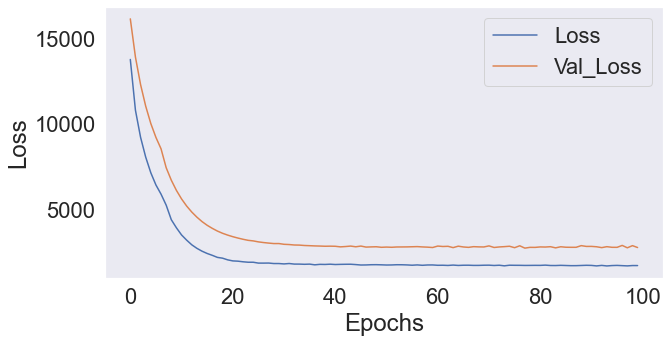

In [115]:
#Visualizing training and validaton loss
plt.figure(figsize = (10, 5))
plt.plot(model.history.history['loss'], label = 'Loss')
plt.plot(model.history.history['val_loss'], Label = 'Val_Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.grid()
plt.legend()

In [116]:
y_train_pred = model.predict(X_train)
y_test_pred = model.predict(X_test)

Text(0, 0.5, 'Test_predicted')

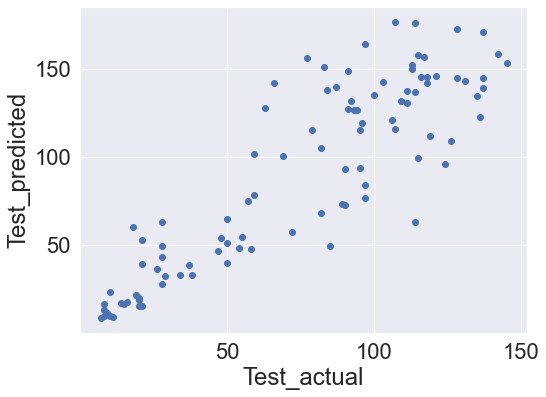

In [117]:
plt.scatter(y_test, y_test_pred)
plt.xlabel("Test_actual")
plt.ylabel("Test_predicted")

In [108]:
print('train RMSE: {0:.2e}'.format(np.sqrt(mean_squared_error(y_train, y_train_pred))))
print('train R2: {0:.3f}'.format(r2_score(y_train, y_train_pred)))

print('test RMSE: {0:.2e}'.format(np.sqrt(mean_squared_error(y_test, y_test_pred))))
print('test R2: {0:.3f}'.format(r2_score(y_test, y_test_pred)))

train RMSE: 4.06e+01
train R2: 0.652
test RMSE: 3.21e+01
test R2: 0.409


In [109]:
Data cleaning and EDA

1. base model: linear regression, 
    performance low
    
2.random forest
   feature engineering
   hyperparameter tuning
   overfitting for the training set
    
3.time serires method model


4. LSTM
   feature selection
   feature enginering 
   grid search hyperparameters
   got the best model performance

C:\Users\Welcome\anaconda3\envs\tf\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


SyntaxError: invalid syntax (<ipython-input-109-a01f28150b57>, line 1)